In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

# =============================================================================
# 1. Model Loading Functions
# =============================================================================

def load_yolo_model(checkpoint_path):
    """Loads a YOLO model from the given checkpoint."""
    return YOLO(checkpoint_path)

# =============================================================================
# 2. Pistil Segmentation Functions
# =============================================================================

def segment_pistils(image, model):
    """
    Performs inference on the image using the pistil segmentation model.
    
    Returns:
        result: The first prediction result from the model.
    """
    results = model.predict(image)
    return results[0]

def extract_segmented_objects(image_rgb, result, save_dir=None):
    """
    Extracts individual segmented objects from the model result.
    
    Args:
        image_rgb: The original image in RGB.
        result: The prediction result from the YOLO model.
        save_dir: Optional directory to save each segmented object.
        
    Returns:
        extracted_segments: List of cropped segmented objects.
    """
    masks = result.masks.data.cpu().numpy()  # Extract masks
    boxes = result.boxes.xyxy.cpu().numpy()    # Bounding boxes for cropping

    if len(masks) == 0:
        print("No objects detected.")
        return []

    extracted_segments = []
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for i, mask in enumerate(masks):
        # Resize mask to image size and binarize
        resized_mask = cv2.resize(mask, (image_rgb.shape[1], image_rgb.shape[0]))
        binary_mask = (resized_mask > 0.5).astype(np.uint8)

        # Apply mask to the image
        segmented_object = cv2.bitwise_and(image_rgb, image_rgb, mask=binary_mask)

        # Crop using the bounding box
        x_min, y_min, x_max, y_max = map(int, boxes[i])
        cropped_object = segmented_object[y_min:y_max, x_min:x_max]
        extracted_segments.append(cropped_object)

        if save_dir:
            save_path = os.path.join(save_dir, f'segment_{i + 1}.png')
            cv2.imwrite(save_path, cv2.cvtColor(cropped_object, cv2.COLOR_RGB2BGR))
            print(f"Saved segmented object: {save_path}")

    return extracted_segments

def visualize_segmented_objects(segmented_objects):
    """Displays segmented objects side by side."""
    if not segmented_objects:
        print("No segmented objects to display.")
        return

    fig, axes = plt.subplots(1, len(segmented_objects), figsize=(16, 8))
    for idx, obj in enumerate(segmented_objects):
        if len(segmented_objects) > 1:
            axes[idx].imshow(obj)
            axes[idx].set_title(f'Segment {idx + 1}')
            axes[idx].axis('off')
        else:
            axes.imshow(obj)
            axes.set_title('Segment 1')
            axes.axis('off')
    plt.tight_layout()
    plt.show()

# =============================================================================
# 3. Color Semantic Segmentation Functions (using YOLO)
# =============================================================================

def run_color_semantic_segmentation(image, model):
    """
    Runs the color semantic segmentation model on the image.
    
    Returns:
        result: The first prediction result from the color segmentation model.
    """
    results = model.predict(image)
    return results[0]

def visualize_color_segmentation(original_rgb, annotated_rgb):
    """Displays the original image and its color segmentation side by side."""
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(original_rgb)
    axes[0].set_title("Original")
    axes[0].axis('off')
    axes[1].imshow(annotated_rgb)
    axes[1].set_title("Color Semantic Segmentation")
    axes[1].axis('off')
    plt.show()

# =============================================================================
# 4. Fallback Color Range Segmentation Functions
# =============================================================================

def classify_stigma_colors(segmented_object):
    """
    Classifies pixels in a segmented object into green, white, or orange,
    ensuring mutually exclusive masks with priority: Orange > White > Green.
    
    Returns:
        Tuple of ratios: (green_ratio, white_ratio, orange_ratio)
    """
    hsv_image = cv2.cvtColor(segmented_object, cv2.COLOR_RGB2HSV)

    # Define HSV ranges (tweak these as needed)
    lower_green = np.array([25, 30, 30], dtype=np.uint8)
    upper_green = np.array([95, 255, 255], dtype=np.uint8)
    lower_white = np.array([0, 0, 220], dtype=np.uint8)
    upper_white = np.array([180, 30, 255], dtype=np.uint8)
    lower_orange = np.array([0, 50, 50], dtype=np.uint8)
    upper_orange = np.array([40, 255, 255], dtype=np.uint8)

    # Create raw masks
    green_mask_raw = cv2.inRange(hsv_image, lower_green, upper_green)
    white_mask_raw = cv2.inRange(hsv_image, lower_white, upper_white)
    orange_mask_raw = cv2.inRange(hsv_image, lower_orange, upper_orange)

    # Morphological cleanup (optional)
    kernel = np.ones((3, 3), np.uint8)
    green_mask_raw = cv2.morphologyEx(green_mask_raw, cv2.MORPH_CLOSE, kernel)
    white_mask_raw = cv2.morphologyEx(white_mask_raw, cv2.MORPH_CLOSE, kernel)
    orange_mask_raw = cv2.morphologyEx(orange_mask_raw, cv2.MORPH_CLOSE, kernel)

    # Priority 1: Orange (all orange pixels)
    orange_exclusive = orange_mask_raw.copy()

    # Priority 2: White (only where not orange)
    not_orange = cv2.bitwise_not(orange_exclusive)
    white_exclusive = cv2.bitwise_and(white_mask_raw, not_orange)

    # Priority 3: Green (only where not orange or white)
    orange_or_white = cv2.bitwise_or(orange_exclusive, white_exclusive)
    not_orange_or_white = cv2.bitwise_not(orange_or_white)
    green_exclusive = cv2.bitwise_and(green_mask_raw, not_orange_or_white)

    total_union = cv2.bitwise_or(orange_exclusive, cv2.bitwise_or(white_exclusive, green_exclusive))
    total_pixels = cv2.countNonZero(total_union)

    orange_count = cv2.countNonZero(orange_exclusive)
    white_count  = cv2.countNonZero(white_exclusive)
    green_count  = cv2.countNonZero(green_exclusive)

    if total_pixels > 0:
        orange_ratio = orange_count / float(total_pixels)
        white_ratio  = white_count  / float(total_pixels)
        green_ratio  = green_count  / float(total_pixels)
    else:
        orange_ratio = white_ratio = green_ratio = 0

    return green_ratio, white_ratio, orange_ratio

def apply_color_filter(segmented_object):
    """
    Applies a color filter to remove the green background from the segmented object.
    
    Returns:
        stigma_mask: The inverted mask where the green background is removed.
    """
    hsv_image = cv2.cvtColor(segmented_object, cv2.COLOR_RGB2HSV)
    lower_green = np.array([35, 40, 40])
    upper_green = np.array([85, 255, 255])
    green_mask = cv2.inRange(hsv_image, lower_green, upper_green)
    stigma_mask = cv2.bitwise_not(green_mask)
    return stigma_mask

def apply_mask_on_image(image, mask):
    """Applies a binary mask on the image."""
    return cv2.bitwise_and(image, image, mask=mask)

def show_images(images, titles, figsize=(20, 10)):
    """Displays a list of images with corresponding titles."""
    fig, axes = plt.subplots(1, len(images), figsize=figsize)
    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img)
        ax.set_title(title)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

def full_pipeline_color_range(segmented_object):
    """
    Full fallback pipeline for color ratio computation using color ranges.
    
    Returns:
        Tuple of color ratios: (green_ratio, white_ratio, orange_ratio)
    """
    # 1. Remove green background
    stigma_mask = apply_color_filter(segmented_object)
    # 2. Extract stigma region
    stigma_extracted = apply_mask_on_image(segmented_object, stigma_mask)
    # 3. Classify colors
    green_ratio, white_ratio, orange_ratio = classify_stigma_colors(stigma_extracted)

    # Optional: visualize the original and processed images with the ratios.
    color_distribution = (
        f"Green: {green_ratio * 100:.2f}%\n"
        f"White: {white_ratio * 100:.2f}%\n"
        f"Orange: {orange_ratio * 100:.2f}%"
    )
    show_images(
        [segmented_object, stigma_extracted],
        ['Original Segmented Object', f'Stigma (No Green)\n{color_distribution}'],
        figsize=(12, 6)
    )

    return green_ratio, white_ratio, orange_ratio

# =============================================================================
# 5. Main Pipeline
# =============================================================================

def main_pipeline(image_path, pistils_model_checkpoint, color_model_checkpoint, save_dir=None):
    # --- Load Models ---
    pistils_model = load_yolo_model(pistils_model_checkpoint)
    color_model = load_yolo_model(color_model_checkpoint)
    
    # --- Load and Prepare Image ---
    image = cv2.imread(image_path)
    if image is None:
        print("Error: Unable to load image.")
        return
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # --- Pistil Segmentation ---
    print(f"Performing pistil segmentation on image: {os.path.basename(image_path)}")
    pistils_result = segment_pistils(image, pistils_model)
    annotated_pistils = pistils_result.plot()
    annotated_pistils = cv2.cvtColor(annotated_pistils, cv2.COLOR_BGR2RGB)
    
    # Display original vs. annotated image
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(image_rgb)
    axes[0].set_title("Original Image")
    axes[0].axis('off')
    axes[1].imshow(annotated_pistils)
    axes[1].set_title("Pistils Segmentation")
    axes[1].axis('off')
    plt.show()
    
    # --- Extract Segmented Pistils ---
    segmented_objects = extract_segmented_objects(image_rgb, pistils_result, save_dir=save_dir)
    visualize_segmented_objects(segmented_objects)
    
    # --- Process Each Pistil ---
    for idx, seg_obj in enumerate(segmented_objects):
        print(f"\nProcessing segmented pistil {idx + 1}")
        
        # 1. Color Semantic Segmentation using YOLO
        color_result = run_color_semantic_segmentation(seg_obj, color_model)
        annotated_color = color_result.plot()
        annotated_color = cv2.cvtColor(annotated_color, cv2.COLOR_BGR2RGB)
        
        # Visualize the color segmentation result
        visualize_color_segmentation(seg_obj, annotated_color)
        
        # 2. Fallback: Color Ratio Calculation using Color Ranges
        green_ratio, white_ratio, orange_ratio = full_pipeline_color_range(seg_obj)
        print(f"Segment {idx+1} ratios (Fallback): "
            f"Green: {green_ratio*100:.2f}%, "
            f"White: {white_ratio*100:.2f}%, "
            f"Orange: {orange_ratio*100:.2f}%")

Performing pistil segmentation on image: IMG_8720.JPG

0: 480x640 17 stigmas, 8.0ms
Speed: 2.3ms preprocess, 8.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


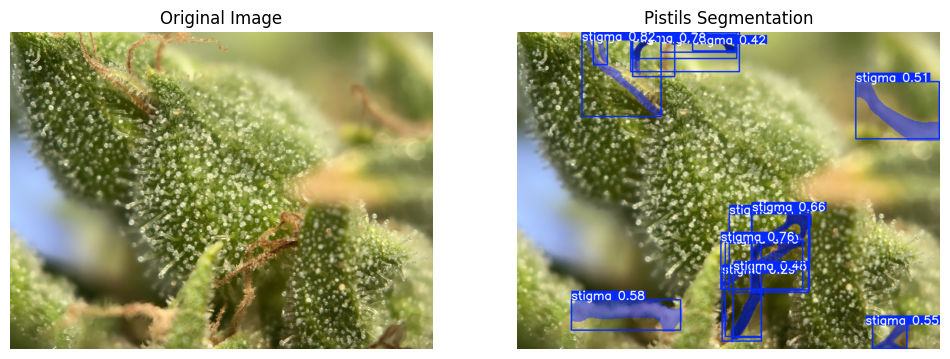

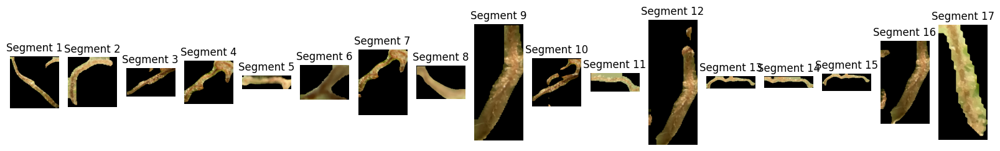


Processing segmented pistil 1

0: 640x608 1 green, 7.4ms
Speed: 2.1ms preprocess, 7.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 608)


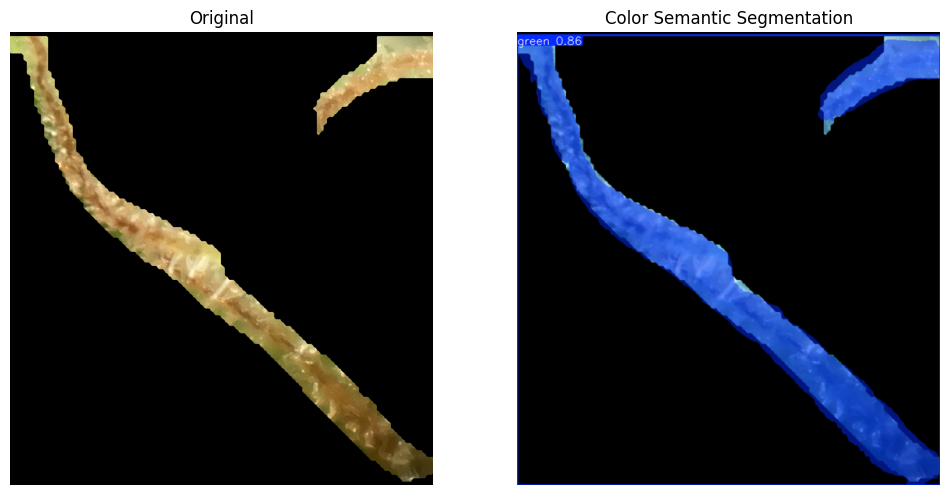

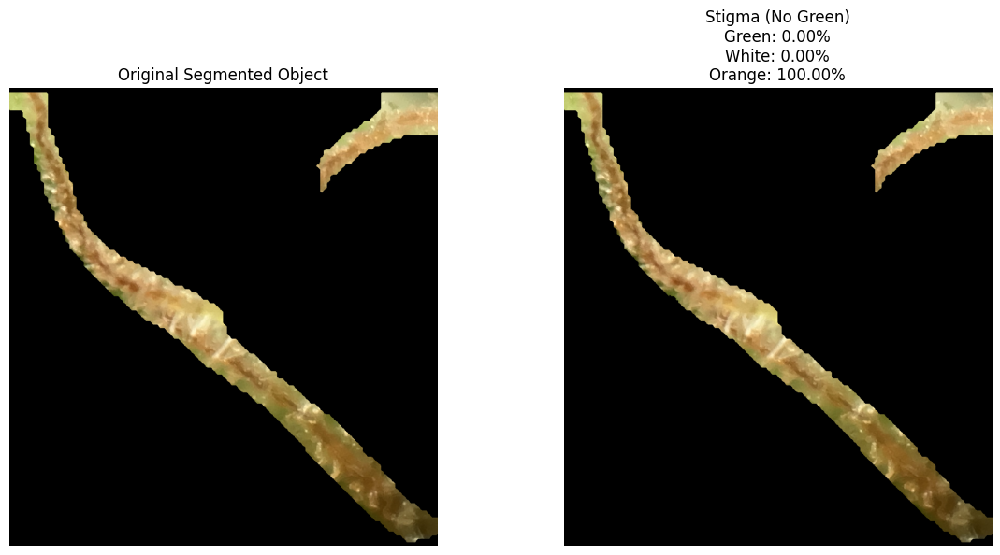

Segment 1 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 2

0: 640x640 1 green, 7.4ms
Speed: 2.8ms preprocess, 7.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


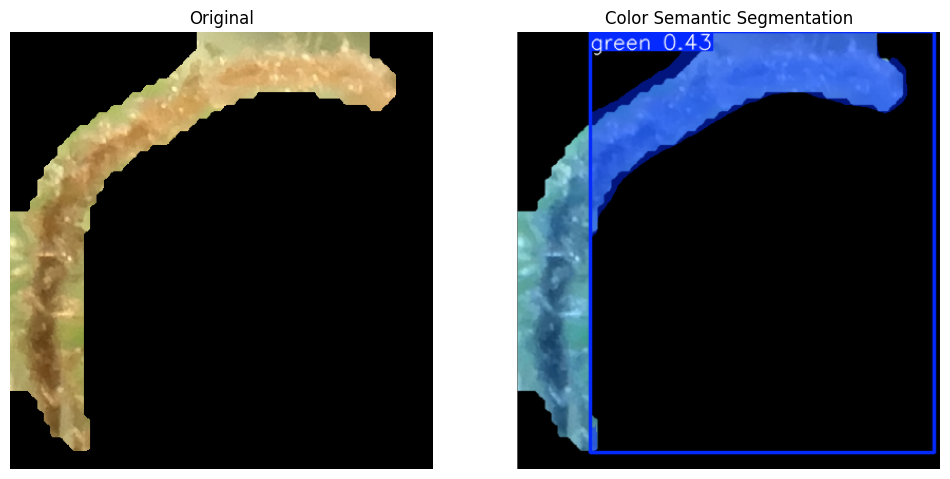

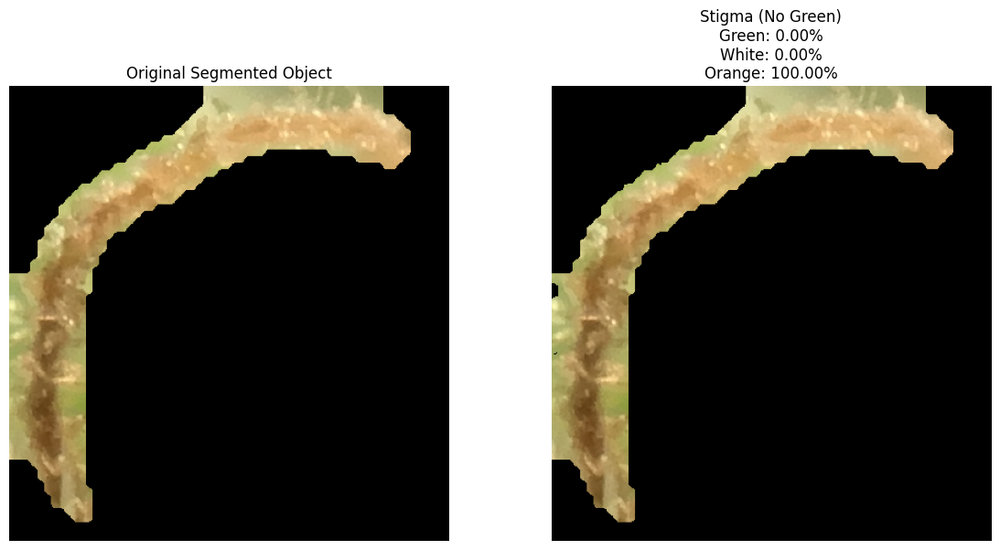

Segment 2 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 3

0: 384x640 1 green, 9.8ms
Speed: 1.5ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


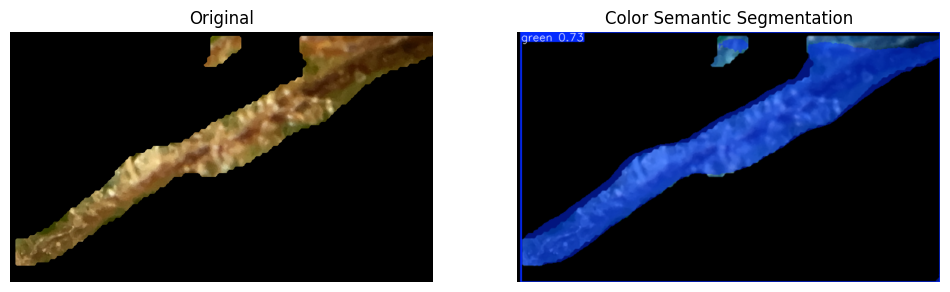

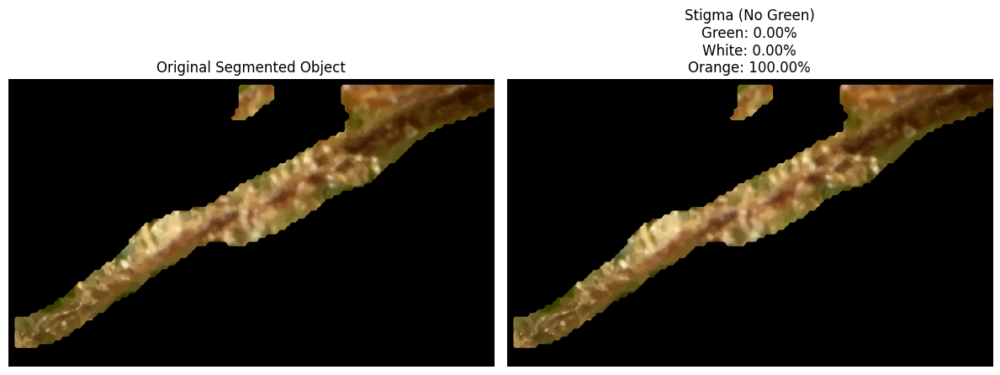

Segment 3 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 4

0: 608x640 1 green, 7.1ms
Speed: 1.9ms preprocess, 7.1ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)


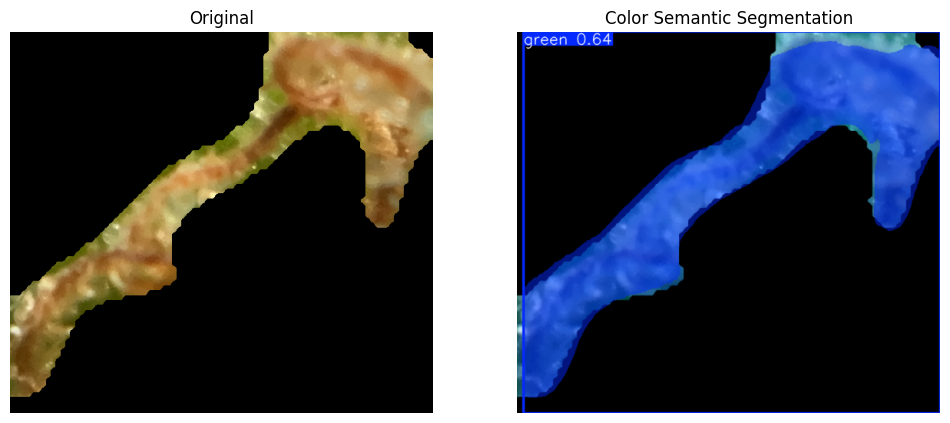

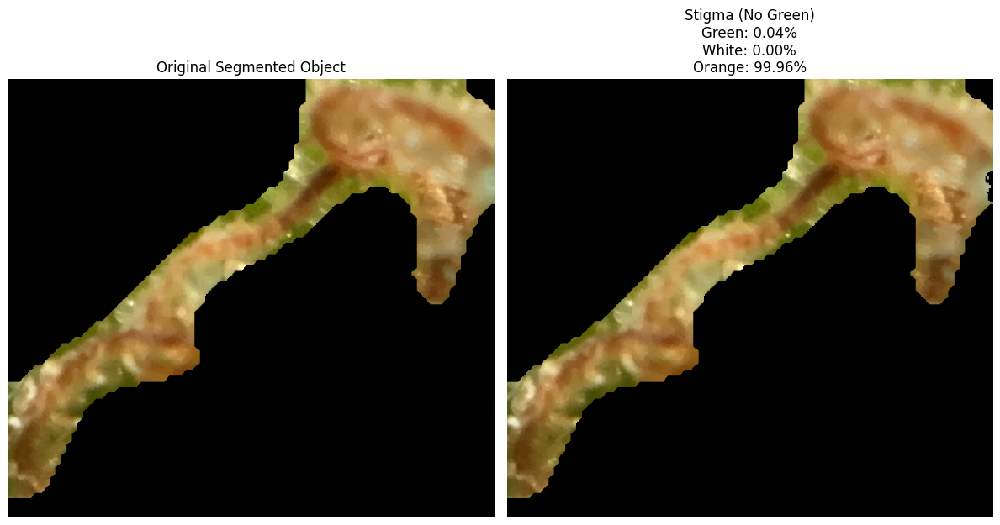

Segment 4 ratios (Fallback): Green: 0.04%, White: 0.00%, Orange: 99.96%

Processing segmented pistil 5

0: 192x640 1 green, 11.2ms
Speed: 1.3ms preprocess, 11.2ms inference, 2.1ms postprocess per image at shape (1, 3, 192, 640)


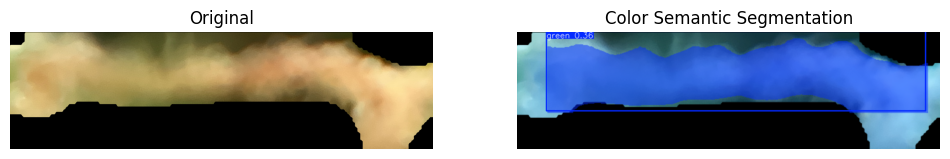

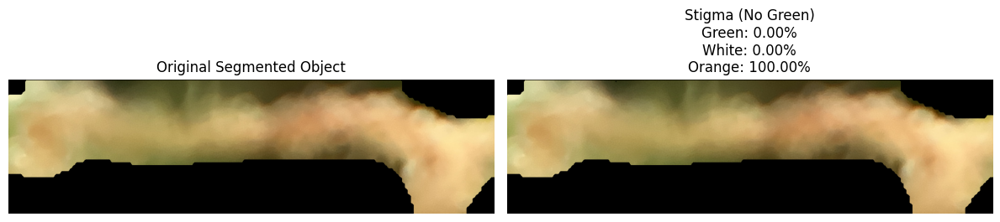

Segment 5 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 6

0: 480x640 1 green, 53.1ms
Speed: 1.5ms preprocess, 53.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


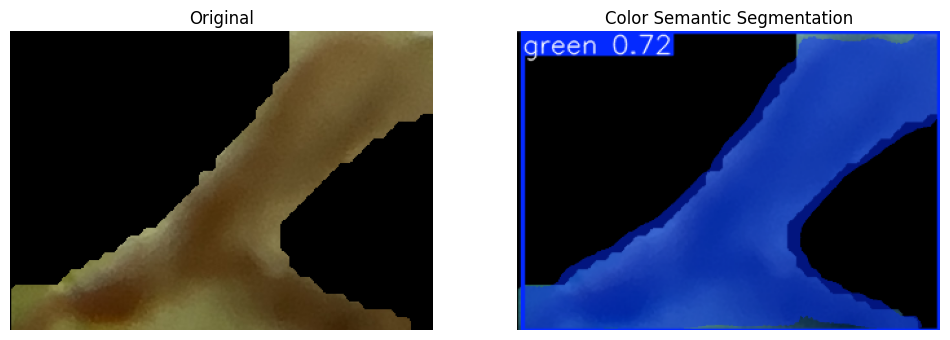

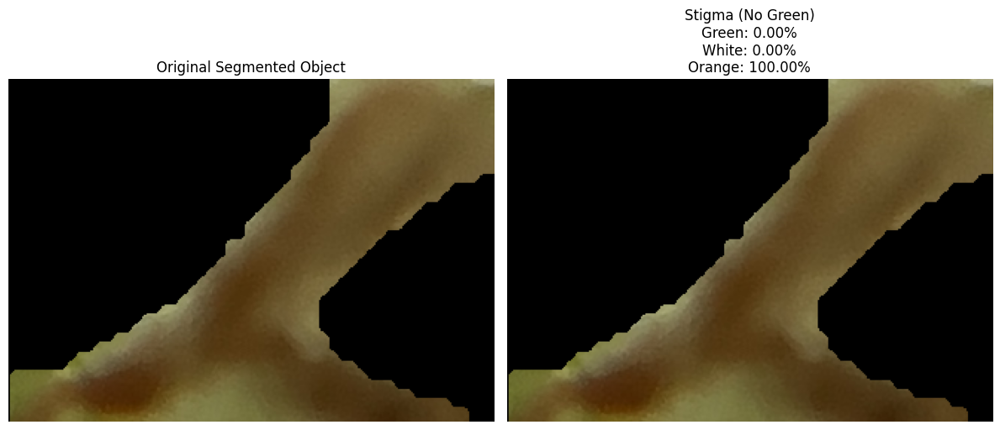

Segment 6 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 7

0: 640x480 1 green, 50.8ms
Speed: 1.9ms preprocess, 50.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


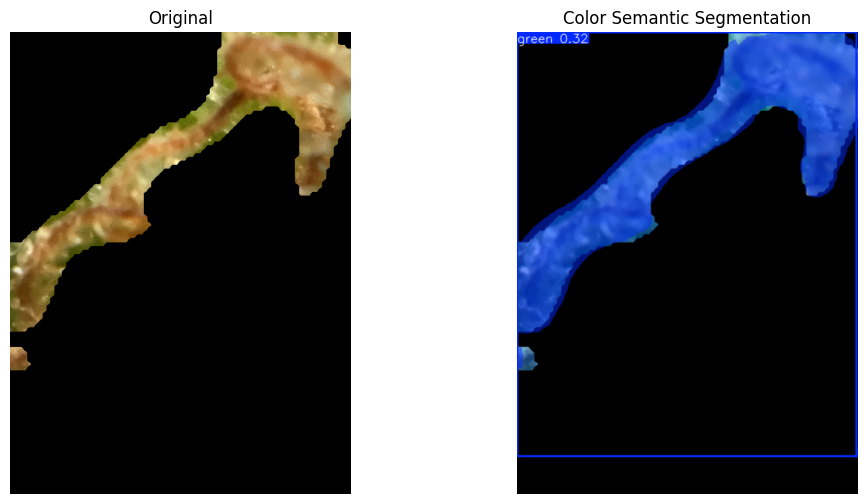

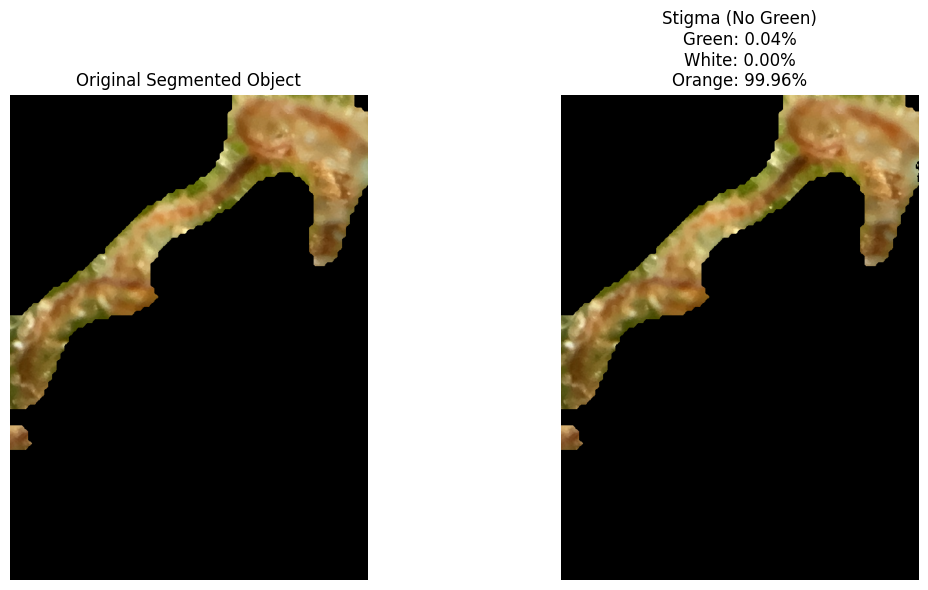

Segment 7 ratios (Fallback): Green: 0.04%, White: 0.00%, Orange: 99.96%

Processing segmented pistil 8

0: 448x640 1 green, 10.0ms
Speed: 2.6ms preprocess, 10.0ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


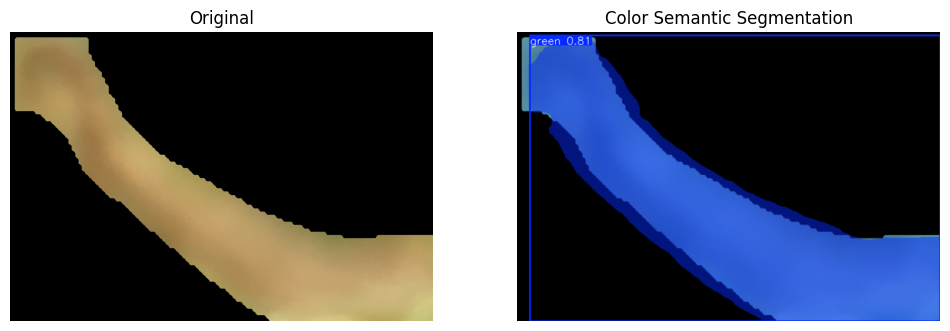

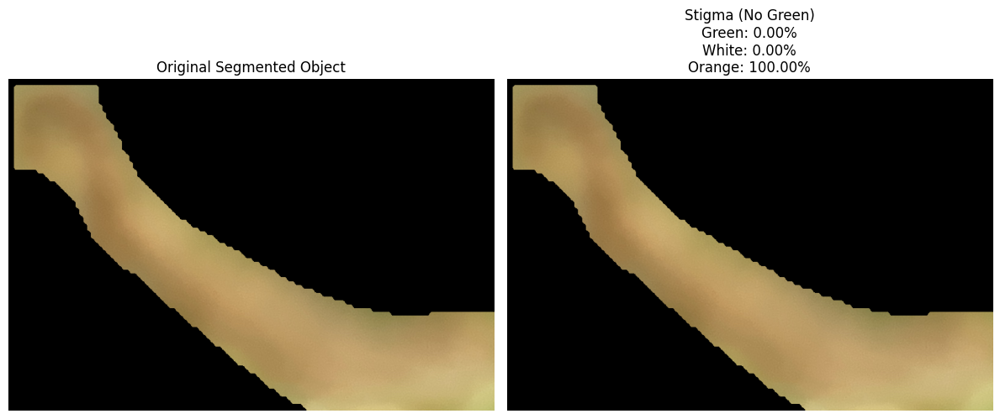

Segment 8 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 9

0: 640x288 1 green, 63.9ms
Speed: 1.8ms preprocess, 63.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 288)


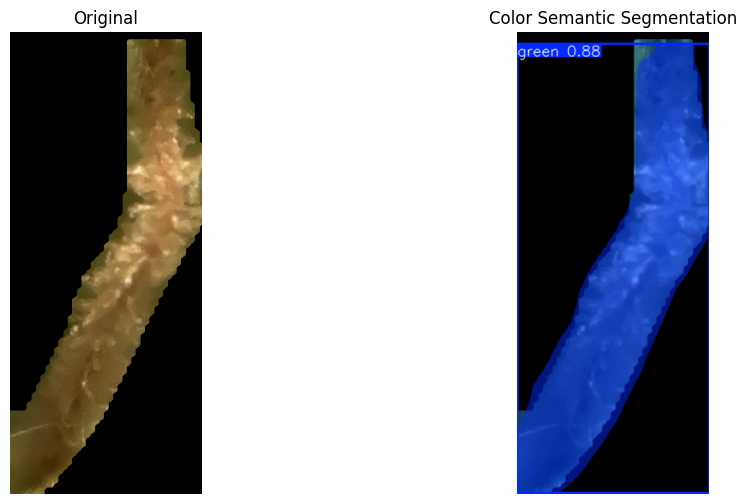

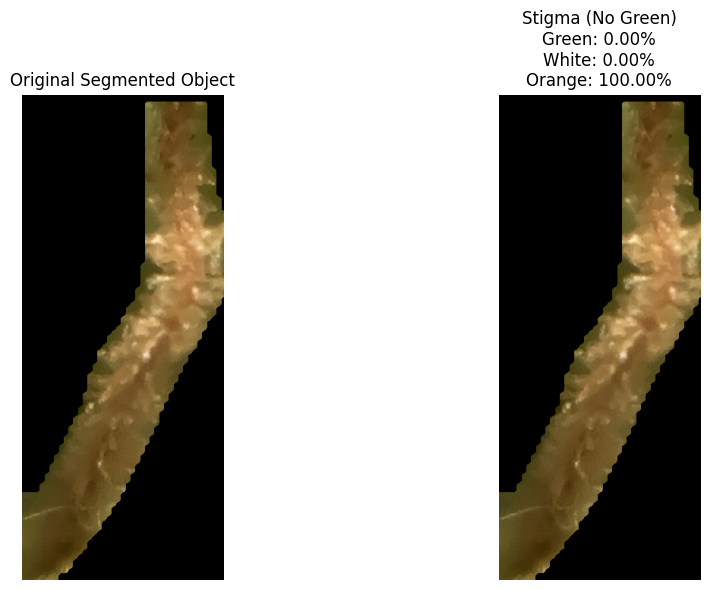

Segment 9 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 10

0: 640x640 1 green, 7.2ms
Speed: 2.2ms preprocess, 7.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


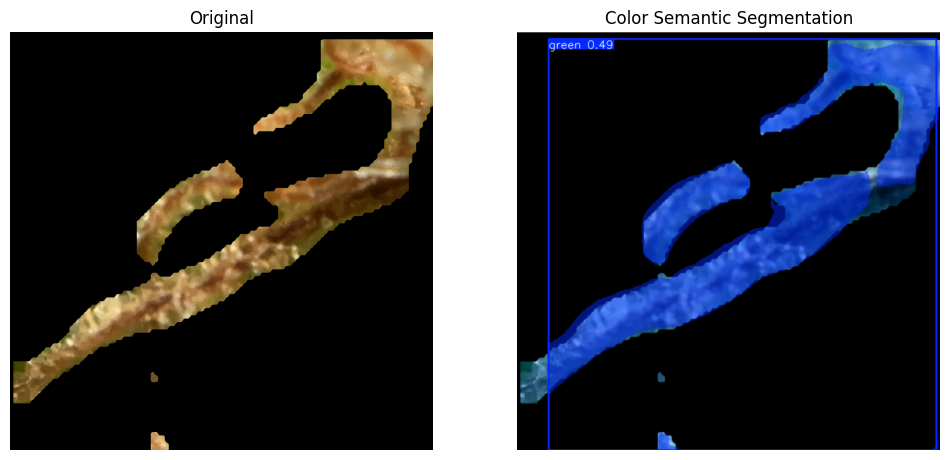

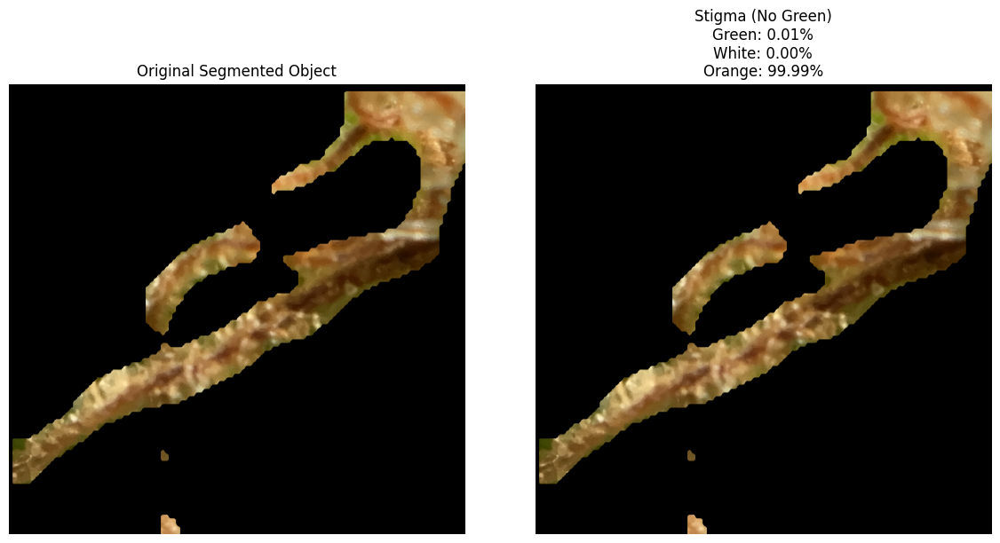

Segment 10 ratios (Fallback): Green: 0.01%, White: 0.00%, Orange: 99.99%

Processing segmented pistil 11

0: 256x640 3 greens, 10.8ms
Speed: 1.4ms preprocess, 10.8ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 640)


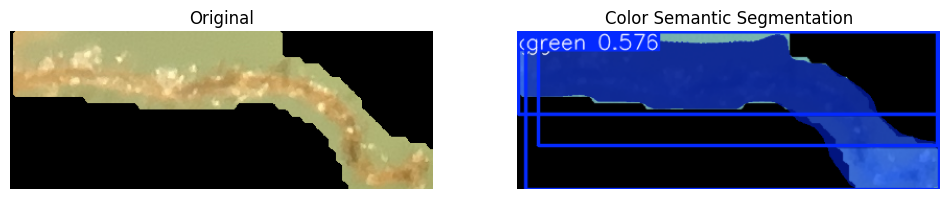

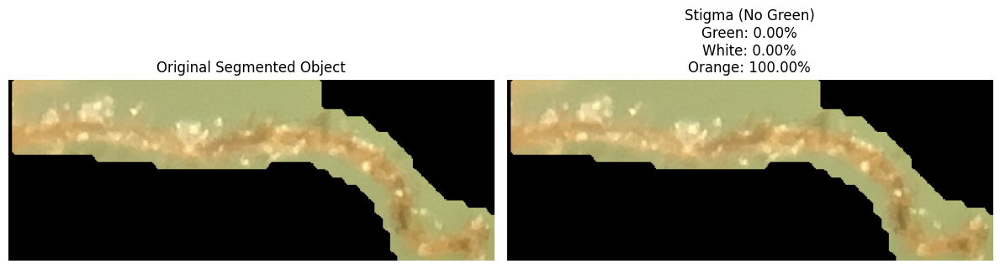

Segment 11 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 12

0: 640x256 1 green, 7.9ms
Speed: 1.1ms preprocess, 7.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 256)


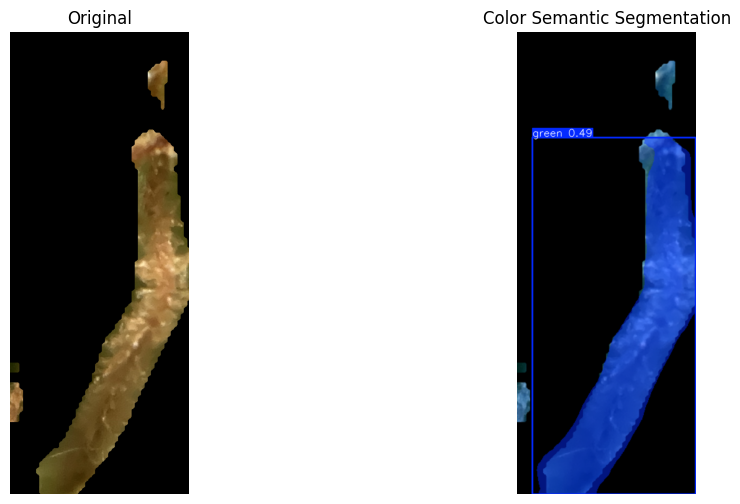

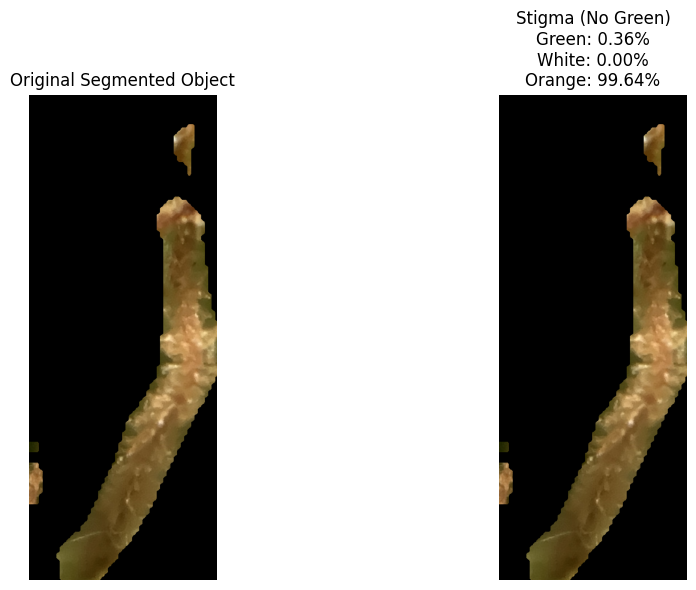

Segment 12 ratios (Fallback): Green: 0.36%, White: 0.00%, Orange: 99.64%

Processing segmented pistil 13

0: 192x640 1 green, 9.2ms
Speed: 0.9ms preprocess, 9.2ms inference, 1.6ms postprocess per image at shape (1, 3, 192, 640)


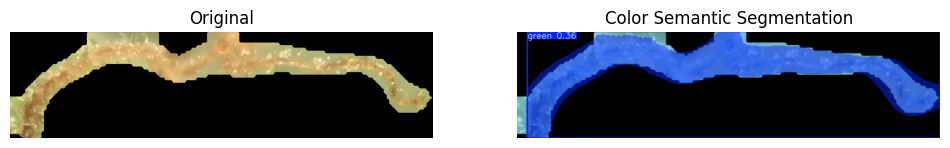

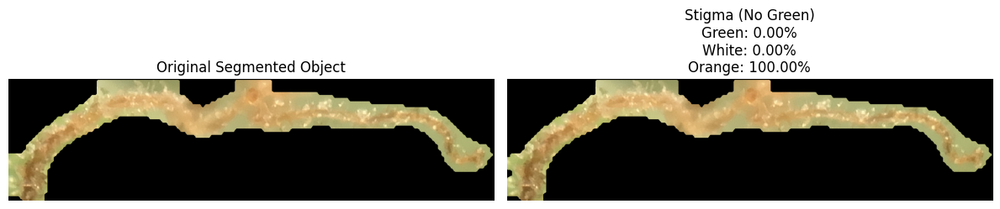

Segment 13 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 14

0: 160x640 1 green, 12.2ms
Speed: 1.2ms preprocess, 12.2ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


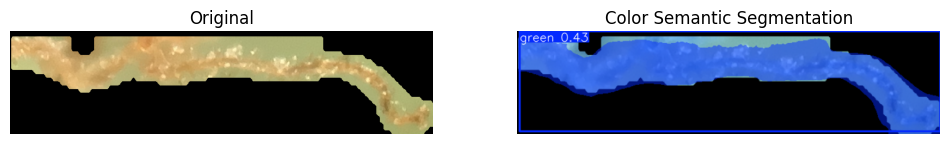

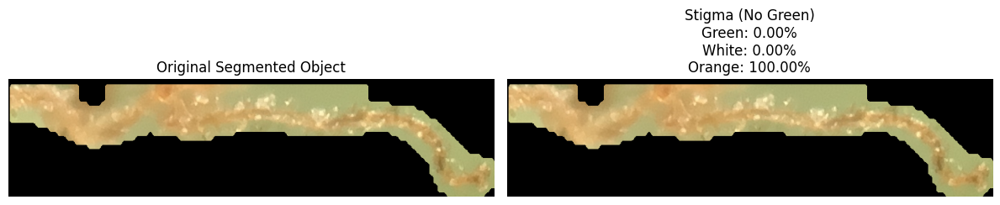

Segment 14 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 15

0: 256x640 1 green, 8.1ms
Speed: 1.2ms preprocess, 8.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 640)


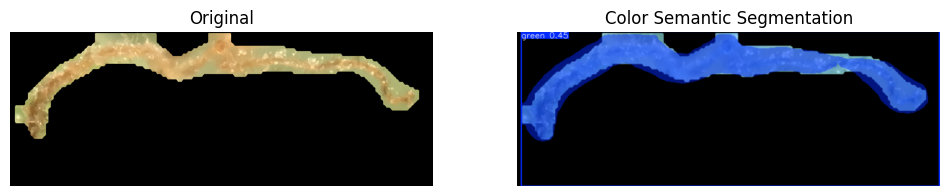

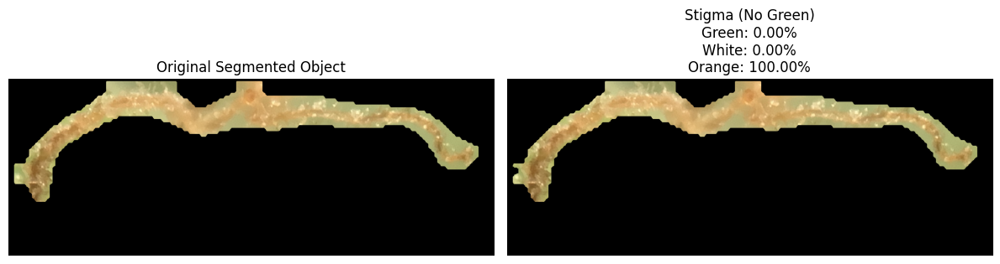

Segment 15 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%

Processing segmented pistil 16

0: 640x384 1 green, 51.3ms
Speed: 1.4ms preprocess, 51.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)


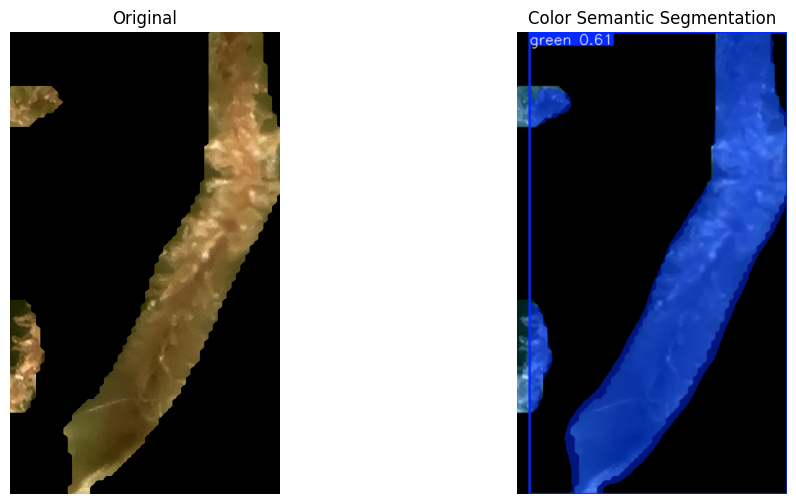

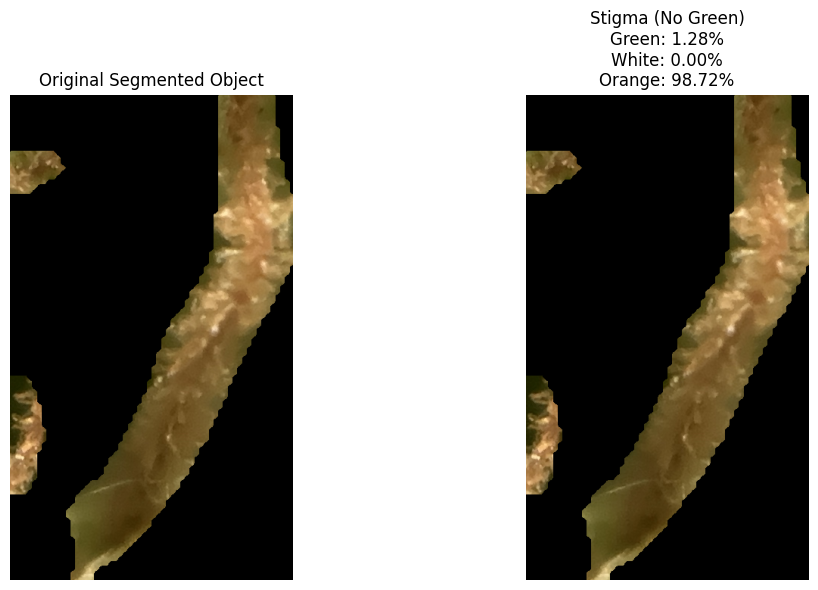

Segment 16 ratios (Fallback): Green: 1.28%, White: 0.00%, Orange: 98.72%

Processing segmented pistil 17

0: 640x288 2 greens, 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 288)


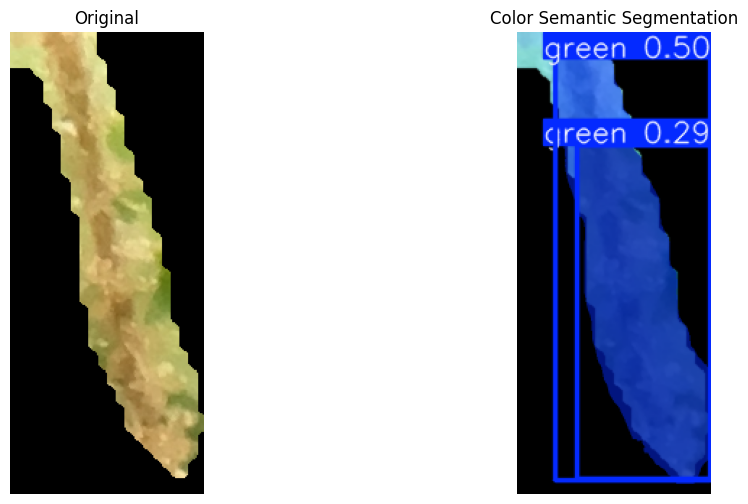

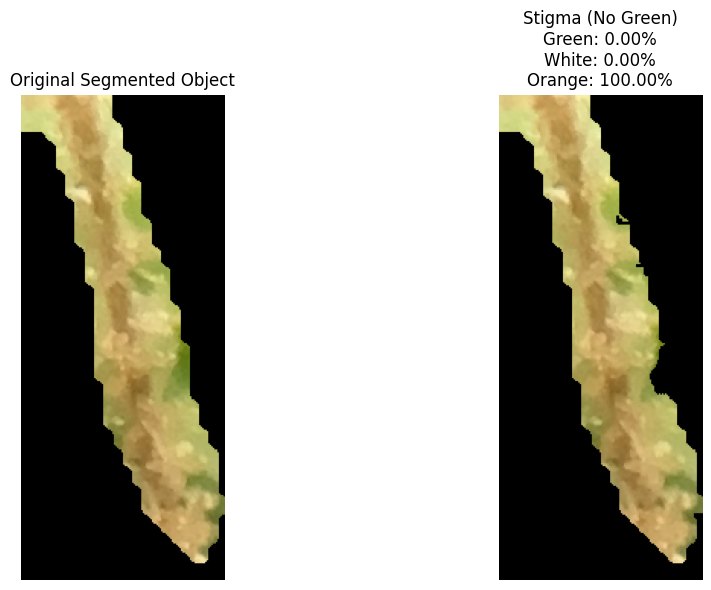

Segment 17 ratios (Fallback): Green: 0.00%, White: 0.00%, Orange: 100.00%


In [6]:
# Define checkpoint paths and input image
pistils_model_checkpoint = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/yolo/fine_tuned/yolov8s_seg_fine_tuned.pt"
color_model_checkpoint = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_color_segmentation/yolo/fine_tuned/yolov8n_seg_fine_tuned.pt"
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_9_2024_06_27/greenhouse/243/IMG_8720.JPG"

# Optional: directory to save segmented objects
# save_dir = "/home/etaylor/code_projects/thesis/segmented_pistils"

# Run the full pipeline
main_pipeline(image_path, pistils_model_checkpoint, color_model_checkpoint)

### Second version with color mask segmentation

In [7]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

# =============================================================================
# 1. YOLO Model Loading
# =============================================================================

def load_yolo_model(checkpoint_path):
    """Loads a YOLO model from the given checkpoint."""
    return YOLO(checkpoint_path)

# =============================================================================
# 2. Pistil Segmentation (YOLO Model #1)
# =============================================================================

def segment_pistils(image_bgr, model):
    """
    Runs the pistil segmentation model on a BGR image.
    Returns the first YOLO result object.
    """
    results = model.predict(image_bgr)
    return results[0]

def extract_segmented_objects(image_rgb, result, save_dir=None):
    """
    Extracts individual pistils from the YOLO segmentation result.
    
    Args:
        image_rgb:  The original image in RGB format.
        result:     The YOLO result (must have segmentation masks).
        save_dir:   Optional directory to save each extracted pistil.
        
    Returns:
        A list of cropped pistils (each in RGB).
    """
    if result.masks is None or result.masks.data is None:
        print("No pistils detected.")
        return []
    
    masks = result.masks.data.cpu().numpy()
    boxes = result.boxes.xyxy.cpu().numpy()

    extracted_segments = []
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for i, mask in enumerate(masks):
        # Resize mask to the image size and binarize
        resized_mask = cv2.resize(mask, (image_rgb.shape[1], image_rgb.shape[0]))
        binary_mask = (resized_mask > 0.5).astype(np.uint8)

        # Apply mask to the RGB image
        segmented_object = cv2.bitwise_and(image_rgb, image_rgb, mask=binary_mask)

        # Crop using bounding box
        x_min, y_min, x_max, y_max = map(int, boxes[i])
        cropped_object = segmented_object[y_min:y_max, x_min:x_max]
        extracted_segments.append(cropped_object)

        if save_dir:
            save_path = os.path.join(save_dir, f"pistil_{i + 1}.png")
            cv2.imwrite(save_path, cv2.cvtColor(cropped_object, cv2.COLOR_RGB2BGR))
            print(f"Saved pistil: {save_path}")

    return extracted_segments

def visualize_segmented_objects(segmented_objects):
    """Displays each extracted pistil side by side."""
    if not segmented_objects:
        print("No pistils to display.")
        return

    fig, axes = plt.subplots(1, len(segmented_objects), figsize=(16, 8))
    if len(segmented_objects) == 1:
        axes.imshow(segmented_objects[0])
        axes.set_title("Segment 1")
        axes.axis("off")
    else:
        for idx, obj in enumerate(segmented_objects):
            axes[idx].imshow(obj)
            axes[idx].set_title(f"Segment {idx + 1}")
            axes[idx].axis("off")
    plt.tight_layout()
    plt.show()

# =============================================================================
# 3. Color Segmentation (YOLO Model #2)
# =============================================================================

def run_color_semantic_segmentation(seg_obj_rgb, model):
    """
    Runs the color segmentation model (YOLO) on a pistil in RGB.
    If the model was trained on BGR, we convert from RGB->BGR first.
    """
    image_bgr = cv2.cvtColor(seg_obj_rgb, cv2.COLOR_RGB2BGR)
    results = model.predict(image_bgr)
    return results[0]

def visualize_color_segmentation(original_rgb, annotated_bgr):
    """
    Displays the original pistil (RGB) vs. YOLO's annotated output (BGR).
    """
    annotated_rgb = cv2.cvtColor(annotated_bgr, cv2.COLOR_BGR2RGB)
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(original_rgb)
    axes[0].set_title("Original Pistil (RGB)")
    axes[0].axis("off")
    axes[1].imshow(annotated_rgb)
    axes[1].set_title("Color Model Segmentation")
    axes[1].axis("off")
    plt.show()

def extract_color_model_masks(result, image_shape):
    """
    Extracts predicted masks for green (class 0) and orange (class 1) 
    from the YOLO color segmentation result.
    
    NOTE: If your classes differ, update the class indices accordingly.
    """
    if result.masks is None or result.masks.data is None:
        # No predictions
        height, width = image_shape[:2]
        empty = np.zeros((height, width), dtype=np.uint8)
        return empty, empty

    masks = result.masks.data.cpu().numpy()
    classes = result.boxes.cls.cpu().numpy()

    height, width = image_shape[:2]
    pred_green_mask  = np.zeros((height, width), dtype=np.uint8)
    pred_orange_mask = np.zeros((height, width), dtype=np.uint8)

    for i, mask in enumerate(masks):
        resized_mask = cv2.resize(mask, (width, height))
        binary_mask = (resized_mask > 0.5).astype(np.uint8) * 255

        # If your color model has 0 => green, 1 => orange:
        if classes[i] == 0:  # green
            pred_green_mask = cv2.bitwise_or(pred_green_mask, binary_mask)
        elif classes[i] == 1:  # orange
            pred_orange_mask = cv2.bitwise_or(pred_orange_mask, binary_mask)

    return pred_green_mask, pred_orange_mask

# =============================================================================
# 4. HSV Fallback (Orange > Green)
# =============================================================================

def hsv_fallback_orange_green(seg_obj_rgb):
    """
    Classifies the entire pistil as either orange or green, with priority orange>green.
    Returns (fallback_orange, fallback_green) as 0/255 masks.
    
    Adjust HSV ranges to match your data.
    """
    hsv = cv2.cvtColor(seg_obj_rgb, cv2.COLOR_RGB2HSV)

    # Example ranges
    lower_orange = np.array([0,  50, 50], dtype=np.uint8)
    upper_orange = np.array([40,255,255], dtype=np.uint8)

    lower_green  = np.array([40, 30, 30], dtype=np.uint8)
    upper_green  = np.array([95,255,255], dtype=np.uint8)

    orange_raw = cv2.inRange(hsv, lower_orange, upper_orange)
    green_raw  = cv2.inRange(hsv, lower_green,  upper_green)

    # Priority 1: Orange
    fallback_orange = orange_raw.copy()

    # Priority 2: Green => only where not orange
    not_orange = cv2.bitwise_not(fallback_orange)
    fallback_green = cv2.bitwise_and(green_raw, not_orange)

    return fallback_orange, fallback_green

# =============================================================================
# 5. Combine Model + Fallback => Ensure Sum=1
# =============================================================================

def combine_model_and_fallback(
    seg_obj_rgb,
    object_mask,
    pred_orange_mask,
    pred_green_mask,
    fallback_func
):
    """
    1) Takes the color model's orange/green predictions (priority).
    2) Fallback HSV classification for missing pixels (orange>green).
    3) Removes overlap (orange overrides green).
    4) Forces leftover => green.
    5) Computes final orange/green ratio => sum=1.
    
    Returns:
      final_orange_mask, final_green_mask, orange_ratio, green_ratio
    """
    # (A) Identify missing area = object_mask - (model union)
    model_union = cv2.bitwise_or(pred_orange_mask, pred_green_mask)
    model_union_in_obj = cv2.bitwise_and(model_union, object_mask)
    missing_mask = cv2.bitwise_and(object_mask, cv2.bitwise_not(model_union_in_obj))

    # (B) Fallback classification only on missing region
    fb_orange_full, fb_green_full = fallback_func(seg_obj_rgb)
    fb_orange = cv2.bitwise_and(fb_orange_full, missing_mask)
    fb_green  = cv2.bitwise_and(fb_green_full,  missing_mask)

    # (C) Merge with model predictions
    final_orange = cv2.bitwise_or(pred_orange_mask, fb_orange)
    final_green  = cv2.bitwise_or(pred_green_mask,  fb_green)

    # (D) Remove overlap => ORANGE PRIORITY
    overlap = cv2.bitwise_and(final_orange, final_green)
    if cv2.countNonZero(overlap) > 0:
        # remove overlap from green
        final_green = cv2.bitwise_and(final_green, cv2.bitwise_not(final_orange))

    # (E) Force leftover => green
    union_now = cv2.bitwise_or(final_orange, final_green)
    union_in_obj = cv2.bitwise_and(union_now, object_mask)
    leftover = cv2.bitwise_and(object_mask, cv2.bitwise_not(union_in_obj))
    final_green = cv2.bitwise_or(final_green, leftover) 

    # (F) Compute final ratios
    total_pixels = cv2.countNonZero(object_mask)
    orange_count = cv2.countNonZero(final_orange)
    green_count  = cv2.countNonZero(final_green)

    if total_pixels > 0:
        orange_ratio = orange_count / float(total_pixels)
        green_ratio  = green_count  / float(total_pixels)
    else:
        orange_ratio = 0
        green_ratio  = 0

    return final_orange, final_green, orange_ratio, green_ratio

# =============================================================================
# 6. Main Pipeline
# =============================================================================

def main_pipeline(
    image_path,
    pistils_model_checkpoint,
    color_model_checkpoint,
    save_dir=None
):
    # (A) Load Models
    pistils_model = load_yolo_model(pistils_model_checkpoint)
    color_model   = load_yolo_model(color_model_checkpoint)

    # (B) Read & Show Original Image
    image_bgr = cv2.imread(image_path)
    if image_bgr is None:
        print(f"Error: cannot load image at {image_path}")
        return
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    # (C) Pistil Segmentation
    print(f"Segmenting pistils in: {os.path.basename(image_path)}")
    pistils_result = segment_pistils(image_bgr, pistils_model)
    annotated_bgr = pistils_result.plot()
    annotated_rgb = cv2.cvtColor(annotated_bgr, cv2.COLOR_BGR2RGB)

    # Show original vs. pistil segmentation
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(image_rgb)
    axes[0].set_title("Original")
    axes[0].axis("off")
    axes[1].imshow(annotated_rgb)
    axes[1].set_title("Pistils Segmentation")
    axes[1].axis("off")
    plt.show()

    # (D) Extract Pistils
    pistils = extract_segmented_objects(image_rgb, pistils_result, save_dir=save_dir)
    visualize_segmented_objects(pistils)

    # (E) Process Each Pistil
    for i, seg_obj in enumerate(pistils):
        print(f"\nProcessing Pistil {i+1}")

        # 1. Color Model Prediction
        color_result = run_color_semantic_segmentation(seg_obj, color_model)
        annotated_color_bgr = color_result.plot()
        visualize_color_segmentation(seg_obj, annotated_color_bgr)

        # 2. Extract model masks (green/orange)
        height, width = seg_obj.shape[:2]
        pred_green_mask, pred_orange_mask = extract_color_model_masks(color_result, (height, width))

        # 3. object_mask = all non-black pixels of the pistil
        gray_obj = cv2.cvtColor(seg_obj, cv2.COLOR_RGB2GRAY)
        _, object_mask = cv2.threshold(gray_obj, 1, 255, cv2.THRESH_BINARY)

        # 4. Combine with fallback => sum=1
        final_orange, final_green, orange_ratio, green_ratio = combine_model_and_fallback(
            seg_obj_rgb=seg_obj,
            object_mask=object_mask,
            pred_orange_mask=pred_orange_mask,
            pred_green_mask=pred_green_mask,
            fallback_func=hsv_fallback_orange_green
        )

        # 5. Visualization
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(seg_obj)
        axes[0].set_title("Segmented Pistil (RGB)")
        axes[0].axis("off")
        axes[1].imshow(final_green, cmap="gray")
        axes[1].set_title("Final Green Mask")
        axes[1].axis("off")
        axes[2].imshow(final_orange, cmap="gray")
        axes[2].set_title("Final Orange Mask")
        axes[2].axis("off")
        plt.show()

        total_ratio = green_ratio + orange_ratio
        print(
            f"Pistil {i+1} => Green: {green_ratio*100:.2f}%, "
            f"Orange: {orange_ratio*100:.2f}% (Sum={total_ratio*100:.2f}%)"
        )

Segmenting pistils in: day_4_IMG_5942.jpg

0: 480x640 16 stigmas, 9.5ms
Speed: 7.8ms preprocess, 9.5ms inference, 15.7ms postprocess per image at shape (1, 3, 480, 640)


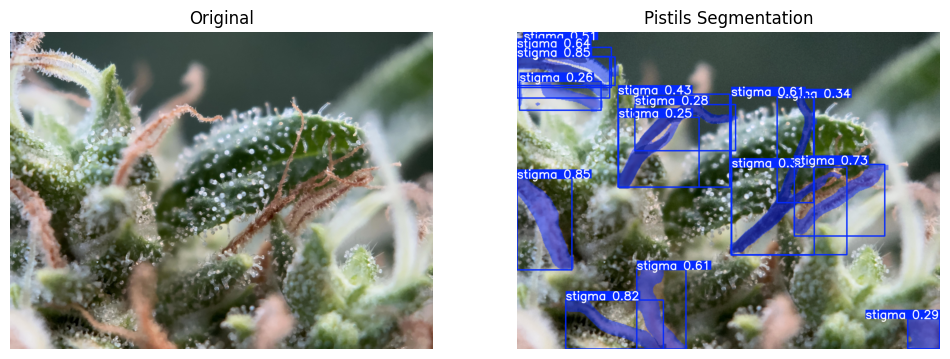

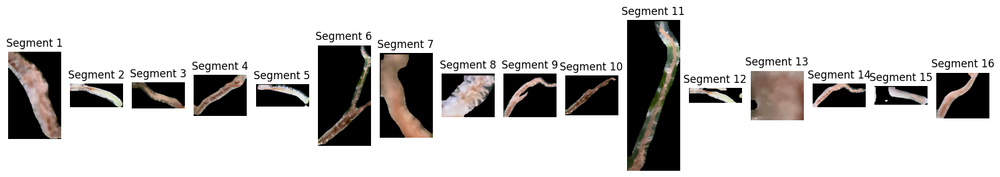


Processing Pistil 1

0: 640x416 1 orange, 13.9ms
Speed: 1.5ms preprocess, 13.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 416)


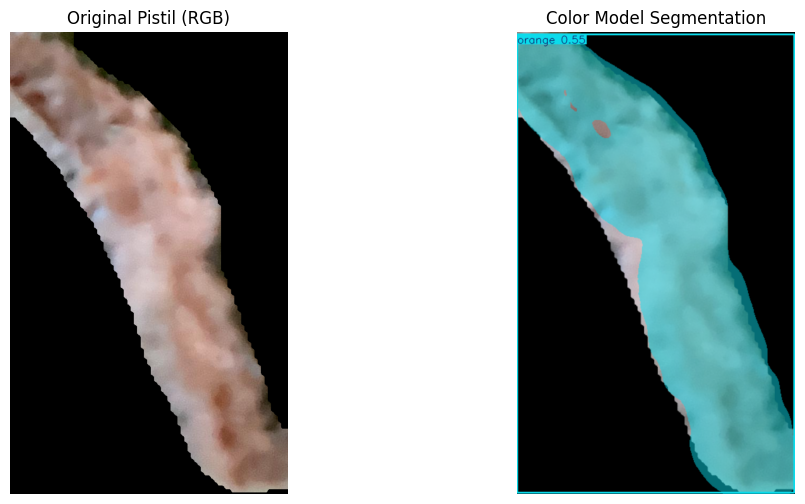

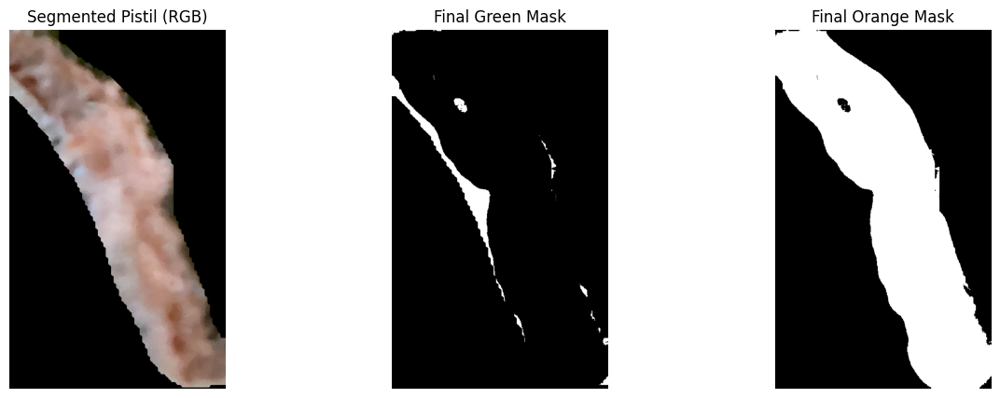

Pistil 1 => Green: 7.09%, Orange: 96.60% (Sum=103.69%)

Processing Pistil 2

0: 288x640 1 green, 1 orange, 13.3ms
Speed: 18.3ms preprocess, 13.3ms inference, 1.6ms postprocess per image at shape (1, 3, 288, 640)


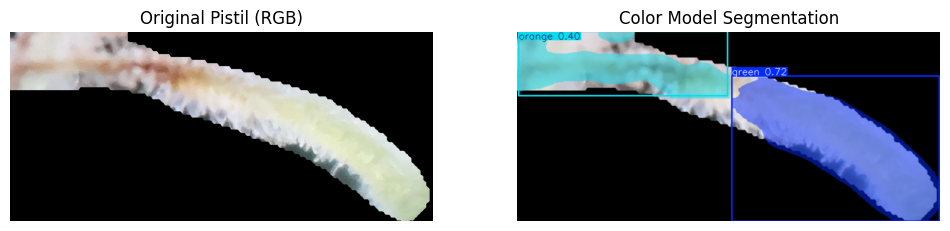

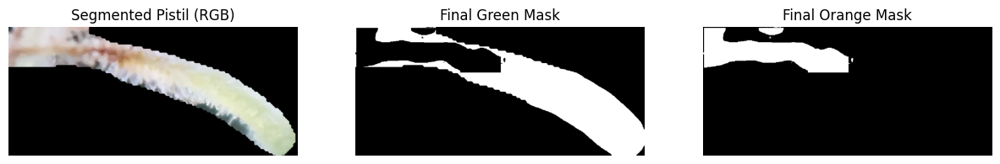

Pistil 2 => Green: 75.77%, Orange: 29.78% (Sum=105.55%)

Processing Pistil 3

0: 320x640 1 orange, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 640)


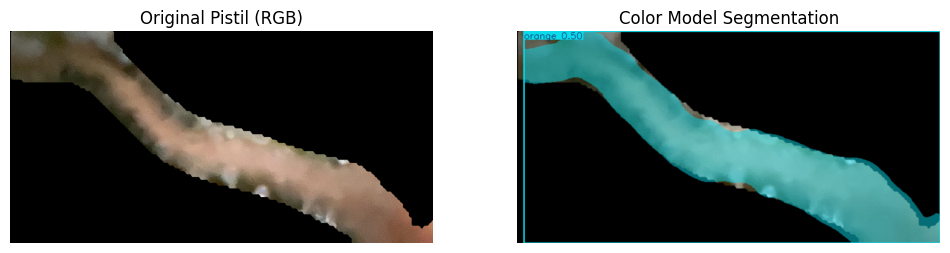

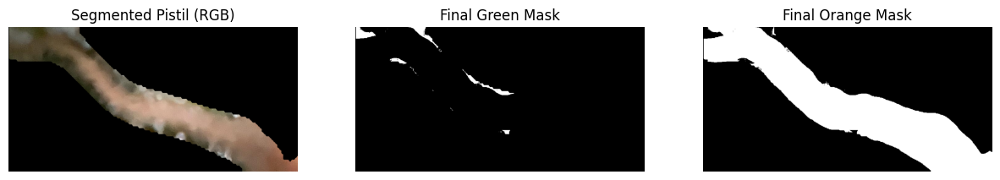

Pistil 3 => Green: 4.16%, Orange: 101.39% (Sum=105.55%)

Processing Pistil 4

0: 512x640 1 orange, 16.2ms
Speed: 1.9ms preprocess, 16.2ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


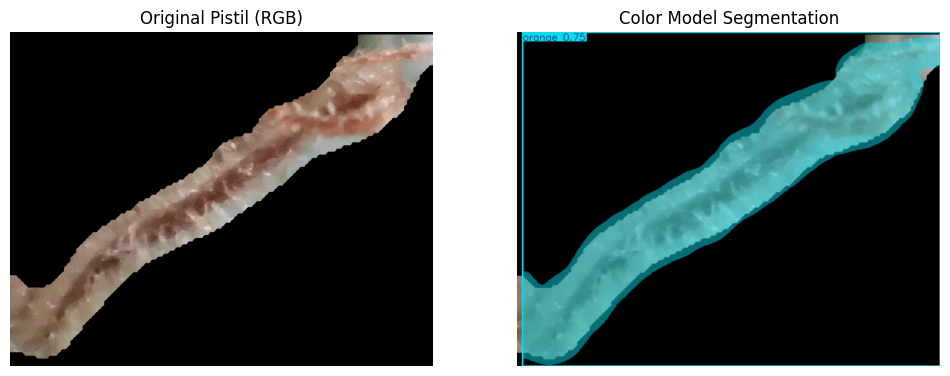

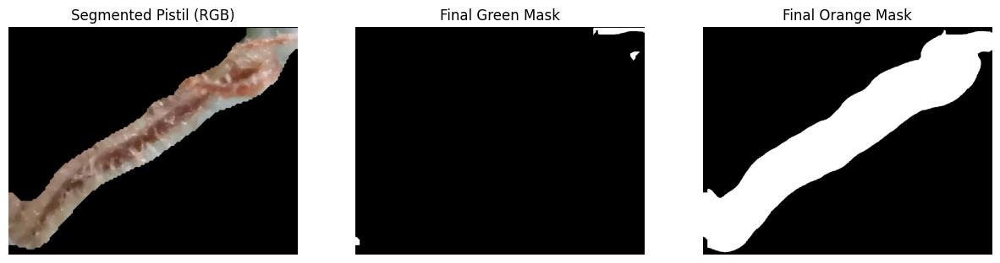

Pistil 4 => Green: 2.27%, Orange: 114.17% (Sum=116.44%)

Processing Pistil 5

0: 288x640 1 green, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.7ms postprocess per image at shape (1, 3, 288, 640)


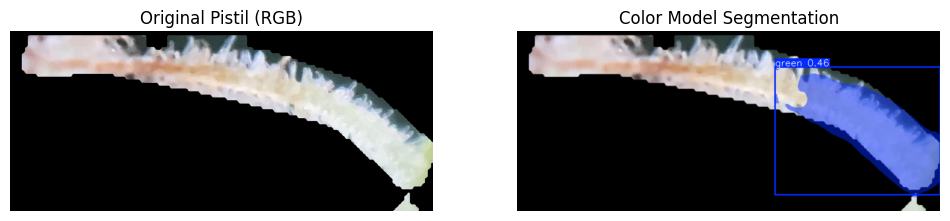

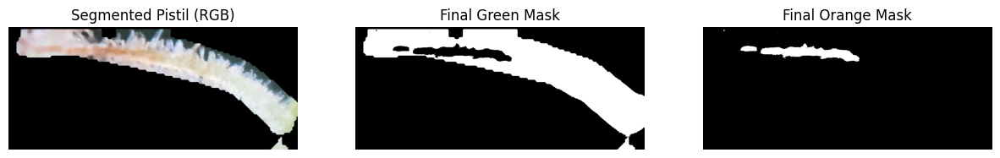

Pistil 5 => Green: 94.99%, Orange: 8.68% (Sum=103.68%)

Processing Pistil 6

0: 640x352 2 oranges, 14.7ms
Speed: 1.8ms preprocess, 14.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 352)


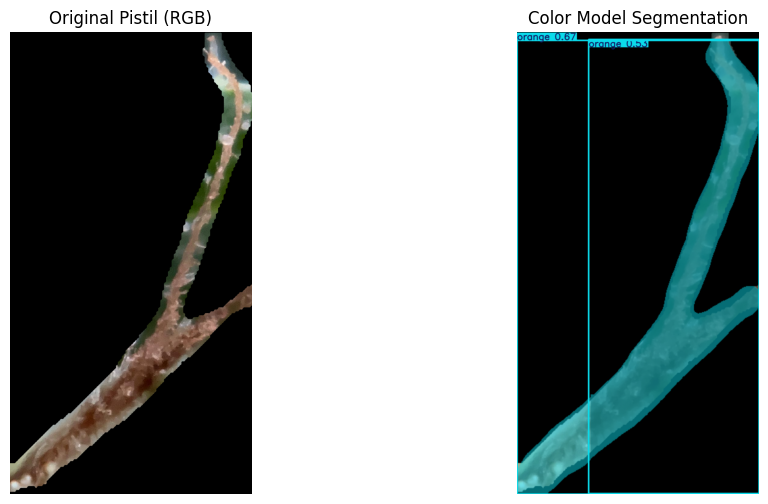

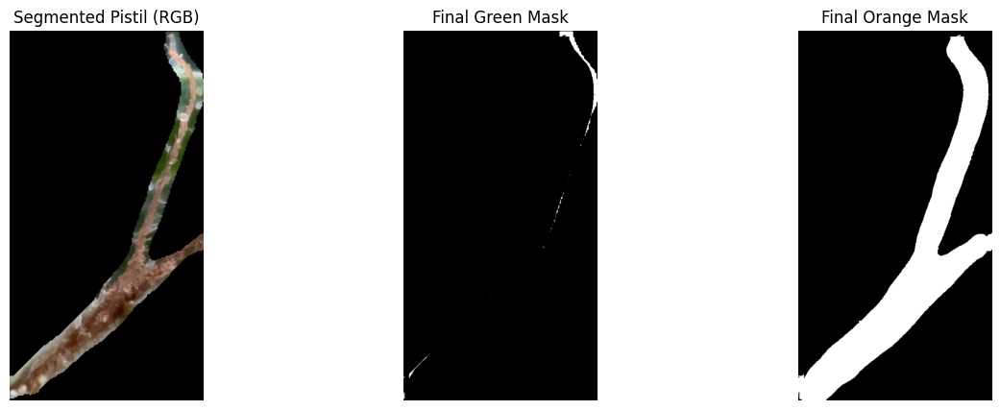

Pistil 6 => Green: 3.55%, Orange: 118.13% (Sum=121.68%)

Processing Pistil 7

0: 640x416 2 oranges, 13.9ms
Speed: 1.6ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 416)


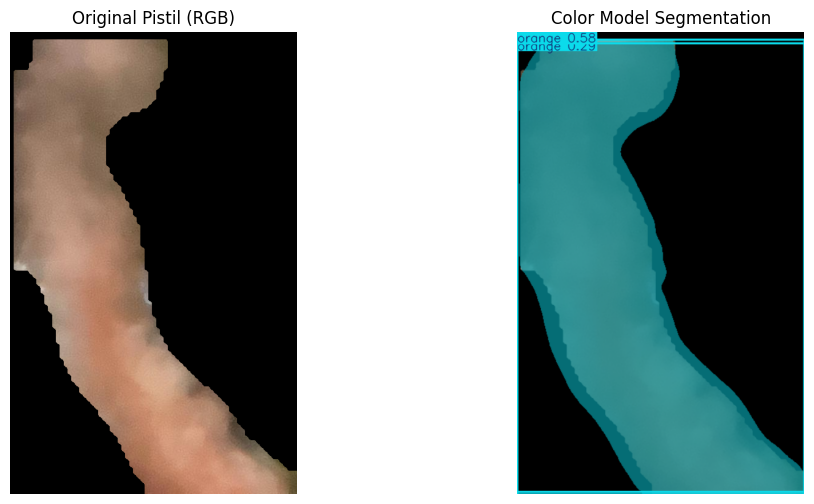

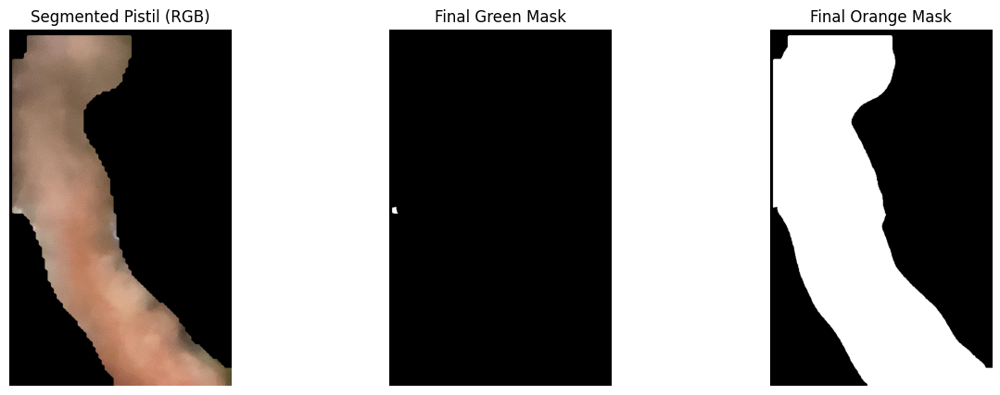

Pistil 7 => Green: 0.09%, Orange: 111.92% (Sum=112.01%)

Processing Pistil 8

0: 544x640 1 orange, 17.0ms
Speed: 1.5ms preprocess, 17.0ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)


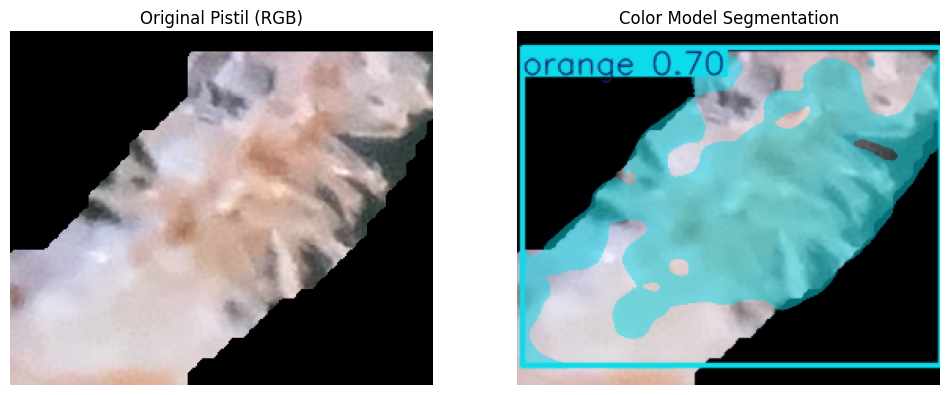

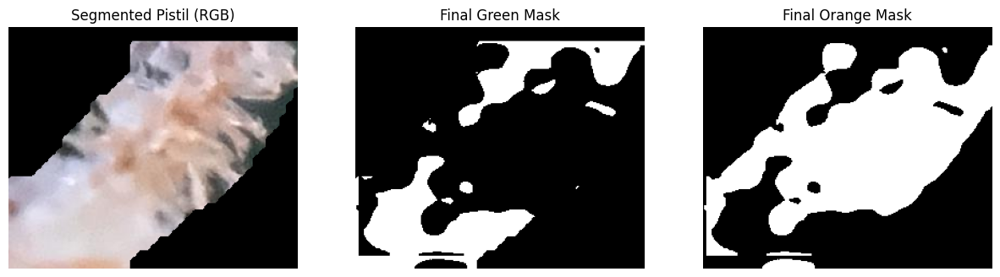

Pistil 8 => Green: 34.71%, Orange: 67.66% (Sum=102.37%)

Processing Pistil 9

0: 544x640 1 orange, 16.3ms
Speed: 2.2ms preprocess, 16.3ms inference, 2.2ms postprocess per image at shape (1, 3, 544, 640)


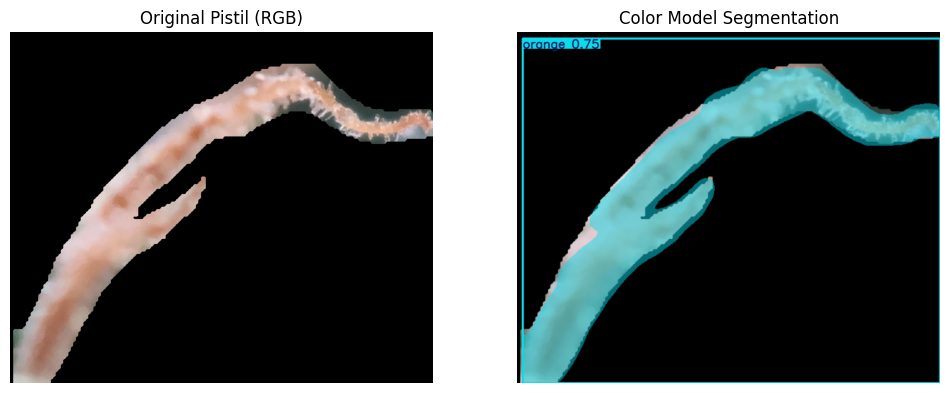

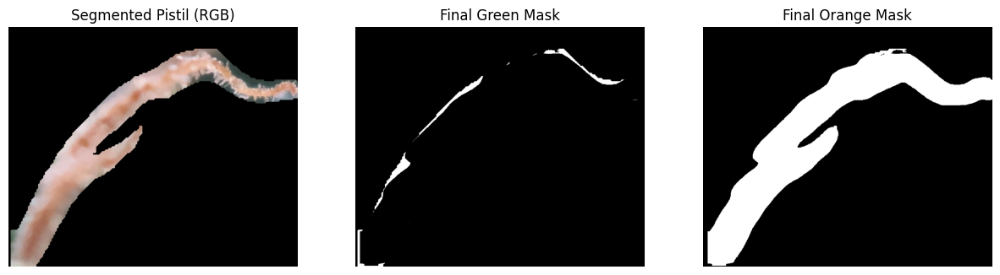

Pistil 9 => Green: 7.24%, Orange: 102.91% (Sum=110.15%)

Processing Pistil 10

0: 512x640 1 orange, 16.8ms
Speed: 2.2ms preprocess, 16.8ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 640)


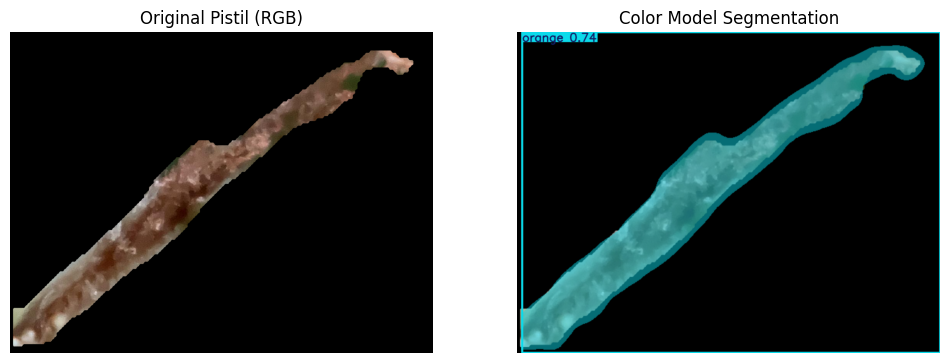

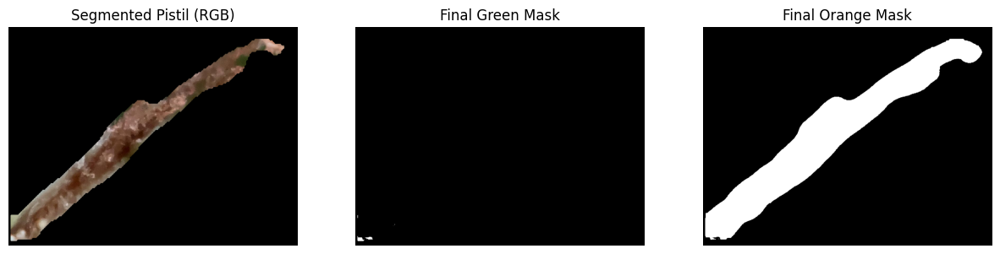

Pistil 10 => Green: 0.42%, Orange: 121.18% (Sum=121.60%)

Processing Pistil 11

0: 640x224 1 orange, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 224)


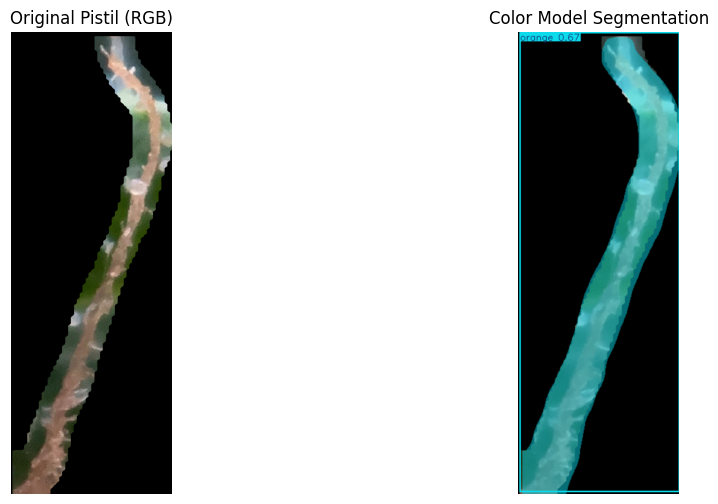

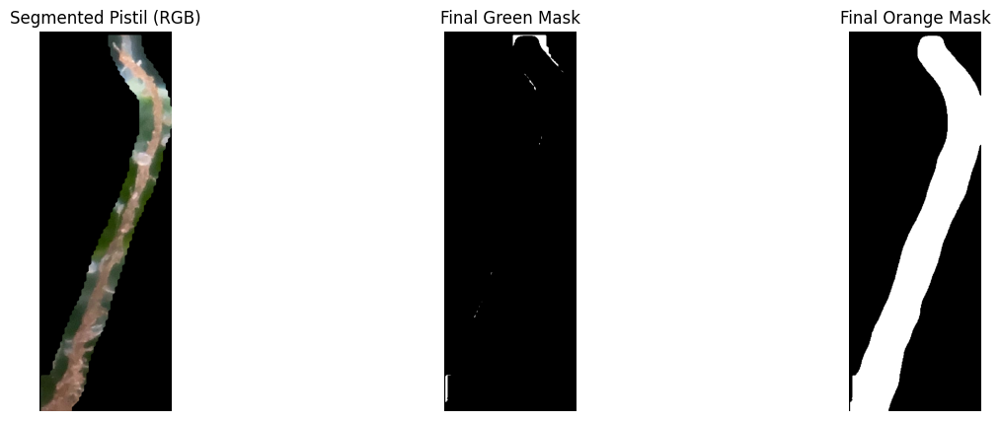

Pistil 11 => Green: 2.19%, Orange: 109.61% (Sum=111.80%)

Processing Pistil 12

0: 192x640 1 green, 2 oranges, 12.0ms
Speed: 0.9ms preprocess, 12.0ms inference, 1.8ms postprocess per image at shape (1, 3, 192, 640)


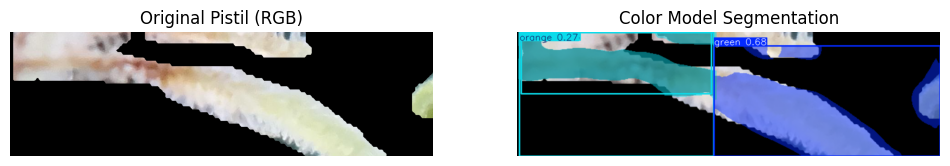

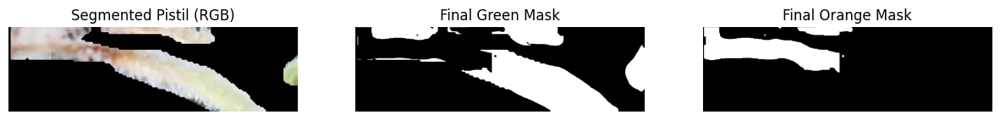

Pistil 12 => Green: 74.99%, Orange: 35.60% (Sum=110.59%)

Processing Pistil 13

0: 608x640 2 oranges, 18.0ms
Speed: 2.0ms preprocess, 18.0ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)


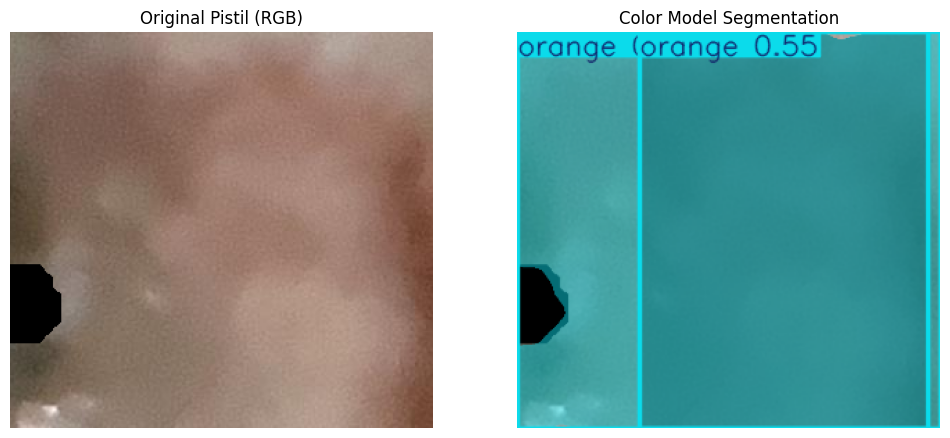

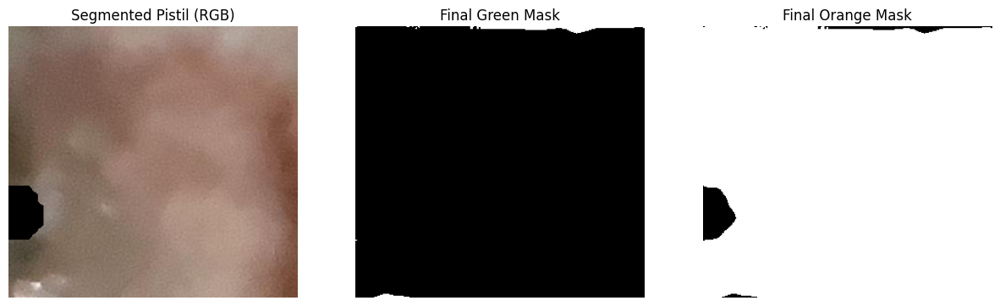

Pistil 13 => Green: 0.78%, Orange: 99.68% (Sum=100.45%)

Processing Pistil 14

0: 320x640 1 orange, 13.8ms
Speed: 2.0ms preprocess, 13.8ms inference, 1.7ms postprocess per image at shape (1, 3, 320, 640)


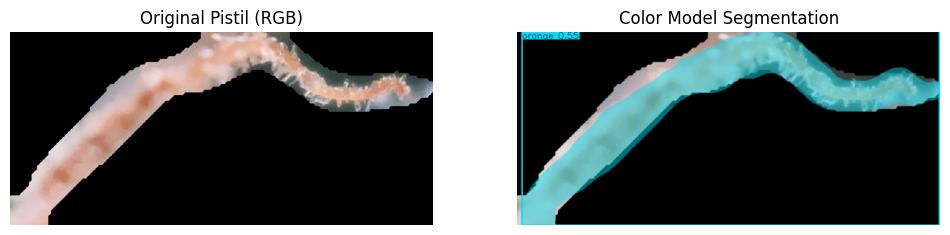

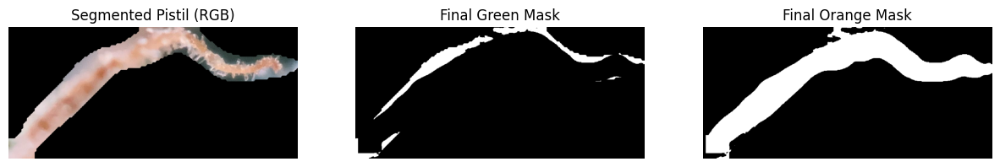

Pistil 14 => Green: 21.84%, Orange: 85.63% (Sum=107.46%)

Processing Pistil 15

0: 256x640 1 orange, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 640)


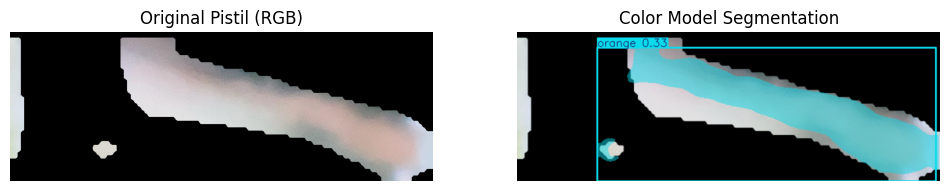

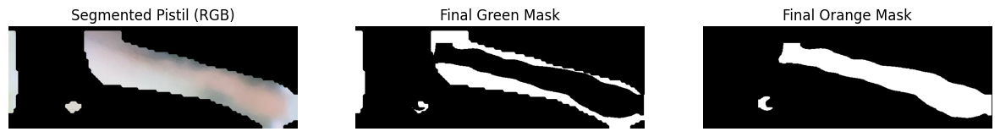

Pistil 15 => Green: 46.89%, Orange: 53.99% (Sum=100.88%)

Processing Pistil 16

0: 576x640 1 orange, 17.5ms
Speed: 2.5ms preprocess, 17.5ms inference, 1.7ms postprocess per image at shape (1, 3, 576, 640)


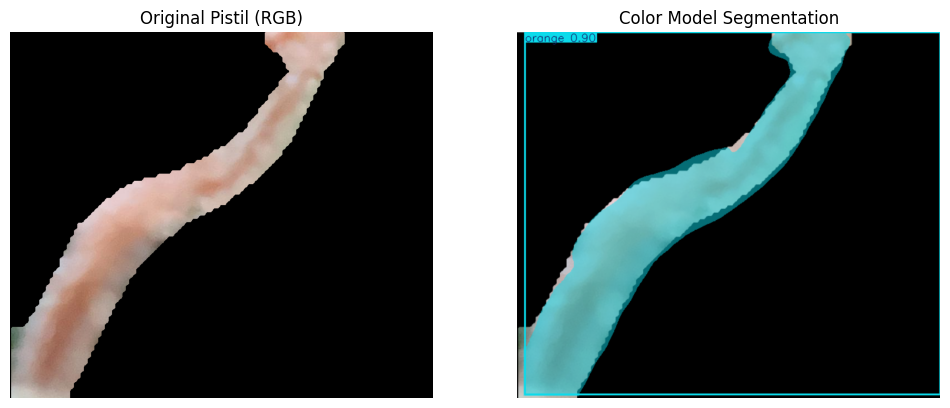

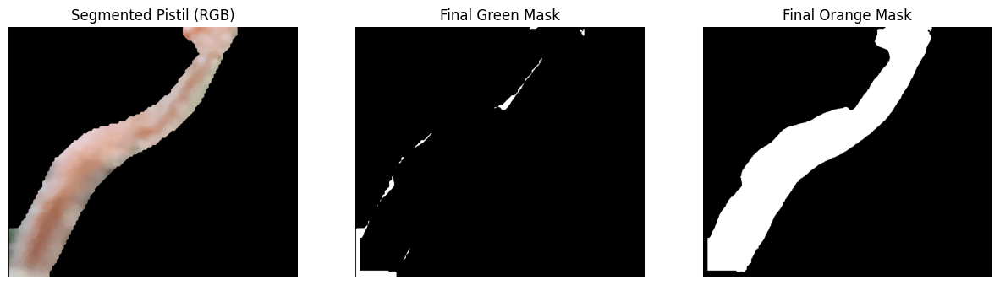

Pistil 16 => Green: 5.57%, Orange: 103.05% (Sum=108.62%)


In [4]:
# Define checkpoint paths and input image
pistils_model_checkpoint = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/yolo/fine_tuned/yolov8s_seg_fine_tuned.pt"
color_model_checkpoint = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_color_segmentation/yolo/fine_tuned/yolov8m_seg_fine_tuned.pt"
image_path = "/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_dataset/yolo_formatted/images/val/day_4_IMG_5942.jpg"

# Optional: directory to save segmented objects
save_dir = "/home/etaylor/code_projects/thesis/segmented_pistils"

# Run the full pipeline
main_pipeline(image_path, pistils_model_checkpoint, color_model_checkpoint)

Segmenting pistils in: day_4_IMG_5942.jpg

0: 480x640 16 stigmas, 11.8ms
Speed: 3.2ms preprocess, 11.8ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)


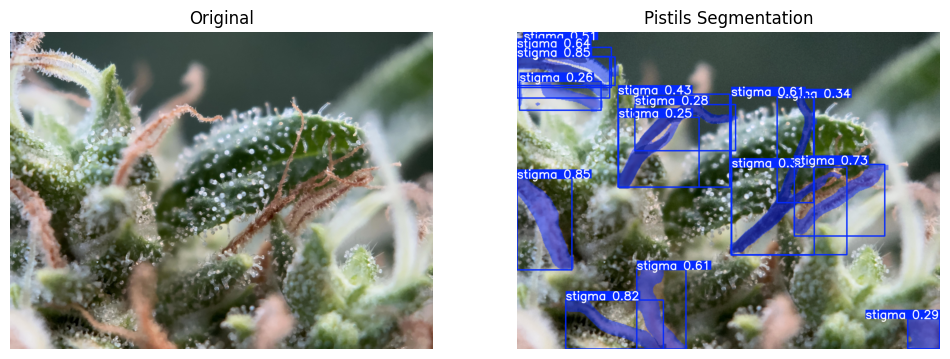

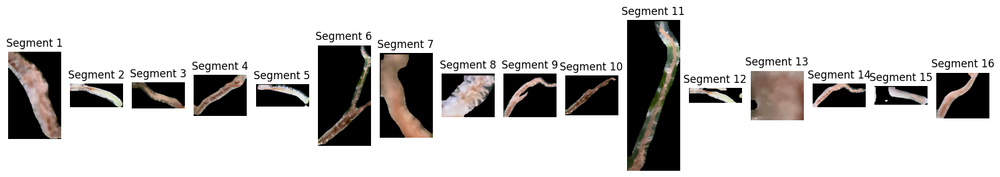


Processing Pistil 1

0: 640x416 (no detections), 42.9ms
Speed: 1.6ms preprocess, 42.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 416)


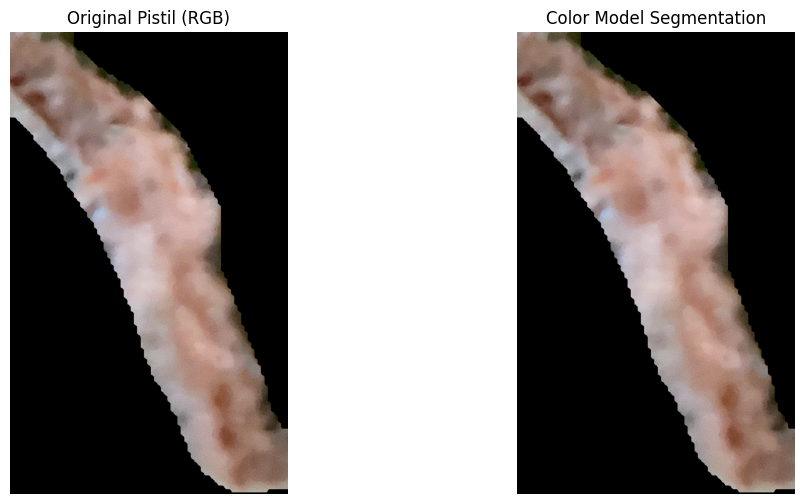

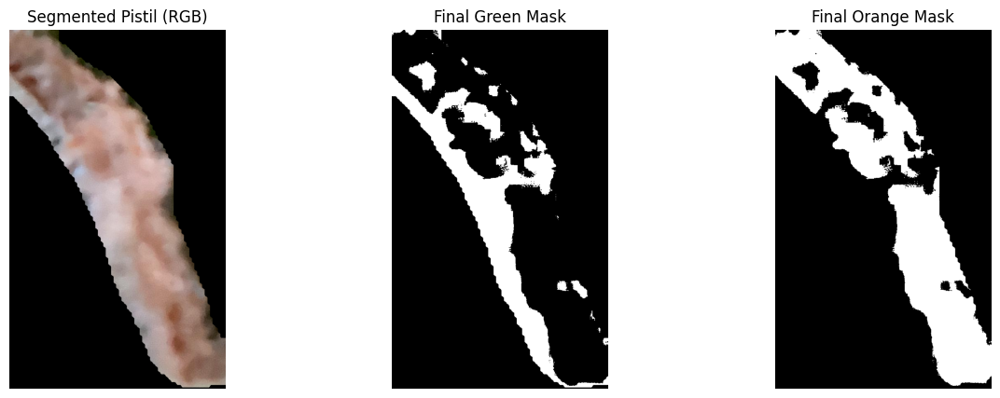

Pistil 1 => Green: 37.33%, Orange: 62.67% (Sum=100.00%)

Processing Pistil 2

0: 288x640 (no detections), 49.8ms
Speed: 1.3ms preprocess, 49.8ms inference, 0.4ms postprocess per image at shape (1, 3, 288, 640)


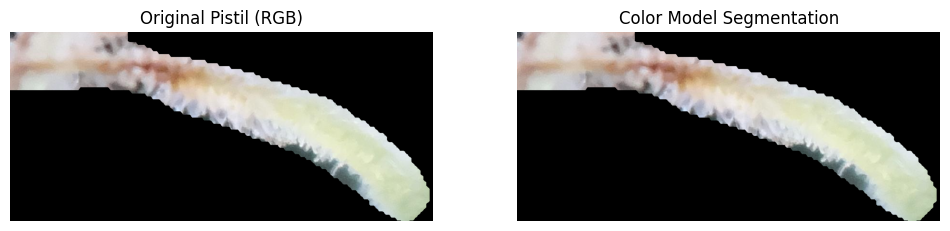

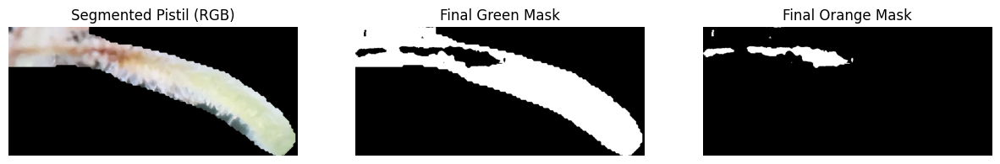

Pistil 2 => Green: 90.19%, Orange: 9.81% (Sum=100.00%)

Processing Pistil 3

0: 320x640 (no detections), 59.9ms
Speed: 2.0ms preprocess, 59.9ms inference, 0.4ms postprocess per image at shape (1, 3, 320, 640)


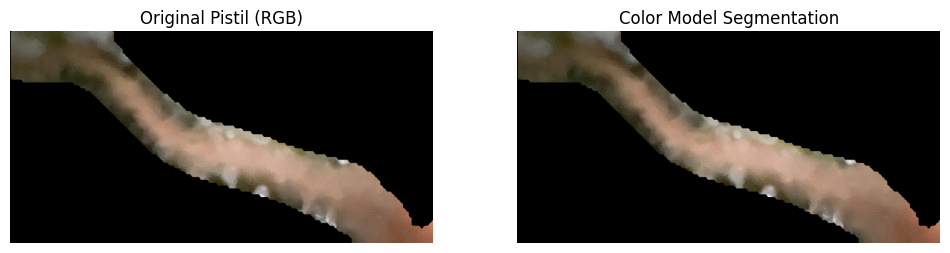

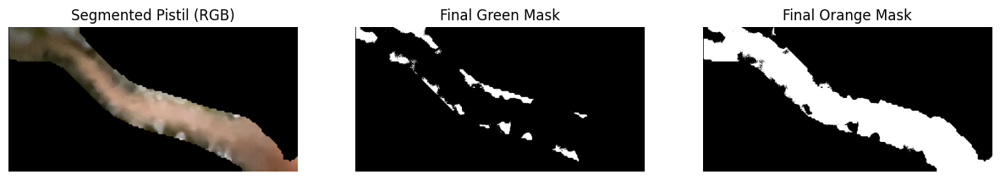

Pistil 3 => Green: 13.74%, Orange: 86.26% (Sum=100.00%)

Processing Pistil 4

0: 512x640 (no detections), 74.2ms
Speed: 3.1ms preprocess, 74.2ms inference, 0.4ms postprocess per image at shape (1, 3, 512, 640)


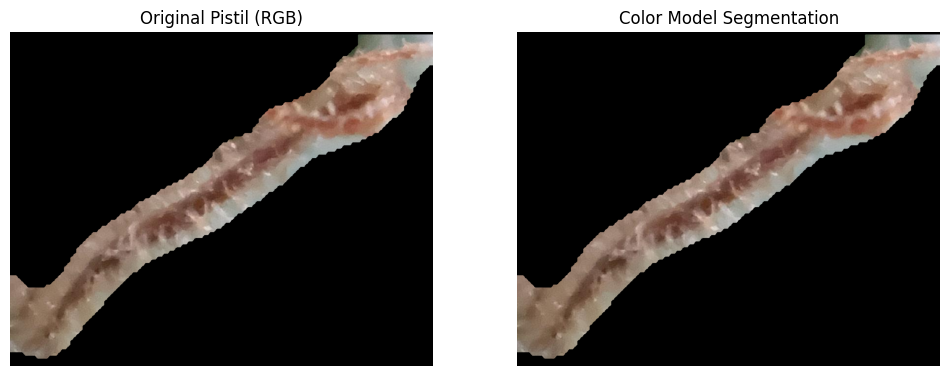

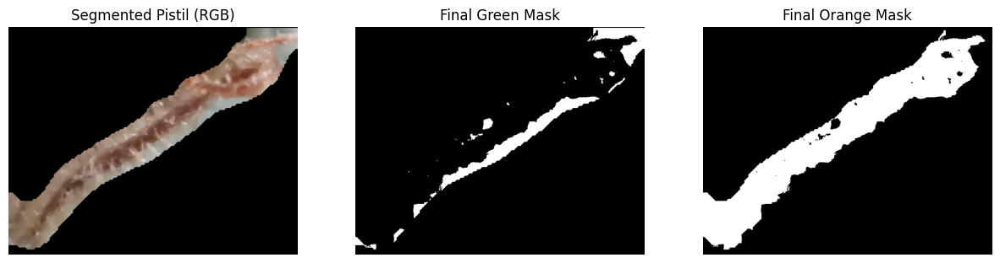

Pistil 4 => Green: 21.20%, Orange: 78.80% (Sum=100.00%)

Processing Pistil 5

0: 288x640 (no detections), 11.0ms
Speed: 1.3ms preprocess, 11.0ms inference, 0.4ms postprocess per image at shape (1, 3, 288, 640)


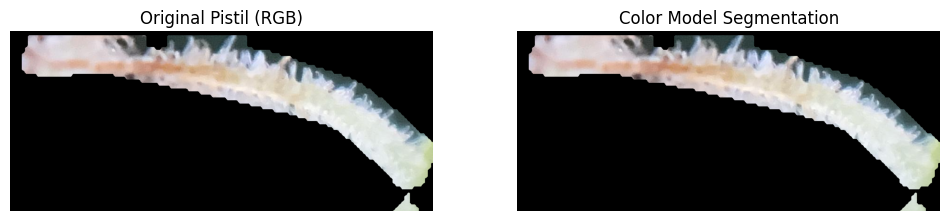

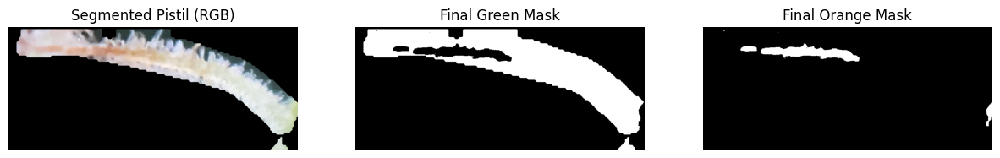

Pistil 5 => Green: 90.44%, Orange: 9.56% (Sum=100.00%)

Processing Pistil 6

0: 640x352 (no detections), 52.3ms
Speed: 1.9ms preprocess, 52.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 352)


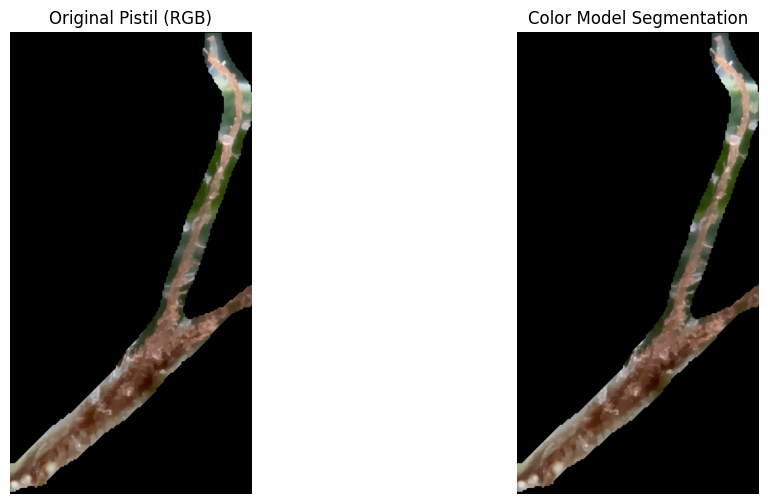

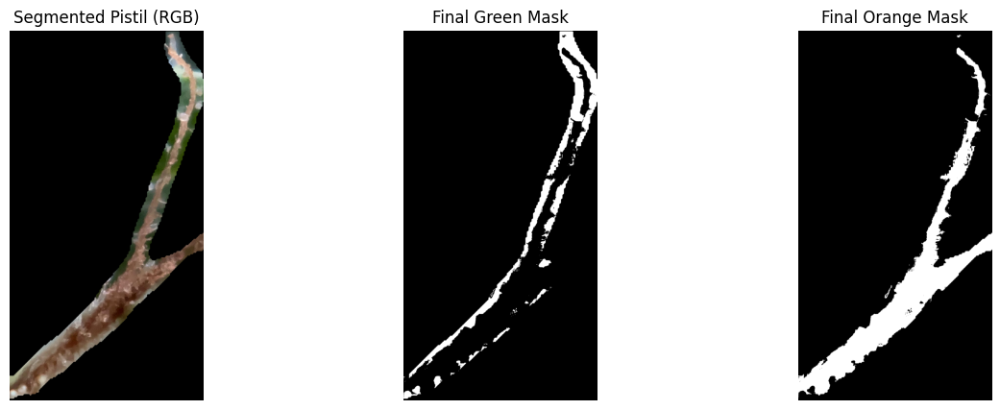

Pistil 6 => Green: 33.47%, Orange: 66.53% (Sum=100.00%)

Processing Pistil 7

0: 640x416 (no detections), 9.4ms
Speed: 3.6ms preprocess, 9.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 416)


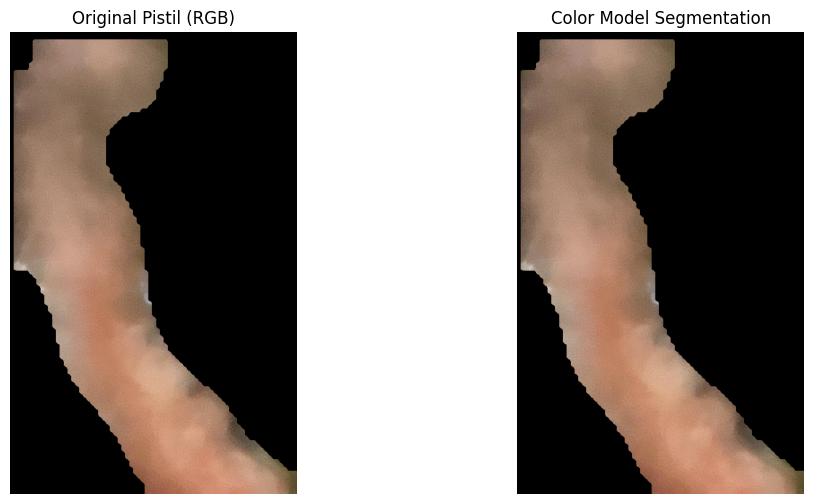

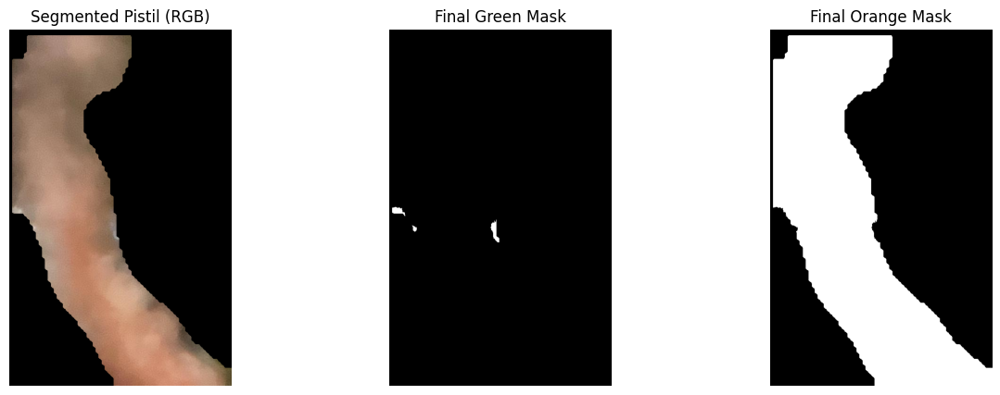

Pistil 7 => Green: 0.52%, Orange: 99.48% (Sum=100.00%)

Processing Pistil 8

0: 544x640 (no detections), 85.9ms
Speed: 2.5ms preprocess, 85.9ms inference, 0.4ms postprocess per image at shape (1, 3, 544, 640)


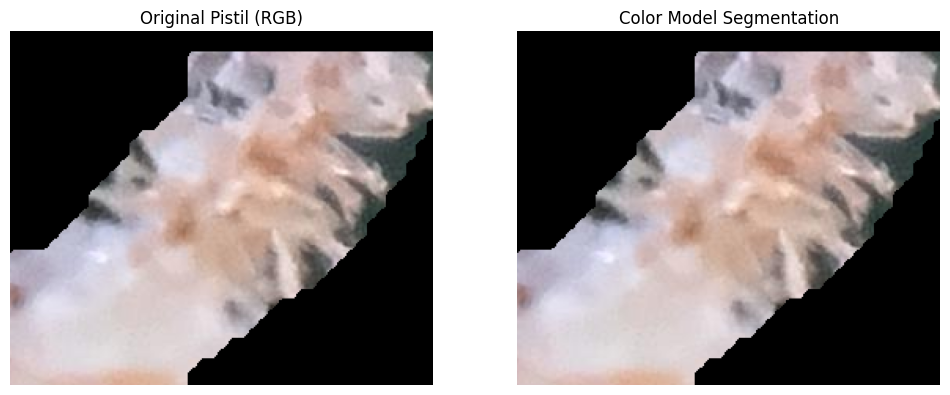

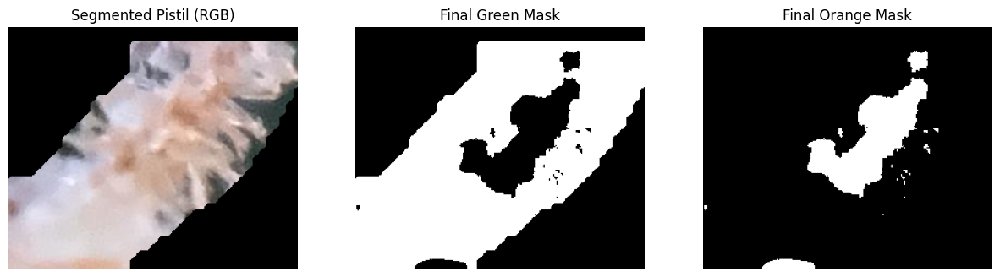

Pistil 8 => Green: 83.77%, Orange: 16.23% (Sum=100.00%)

Processing Pistil 9

0: 544x640 (no detections), 8.2ms
Speed: 2.1ms preprocess, 8.2ms inference, 0.5ms postprocess per image at shape (1, 3, 544, 640)


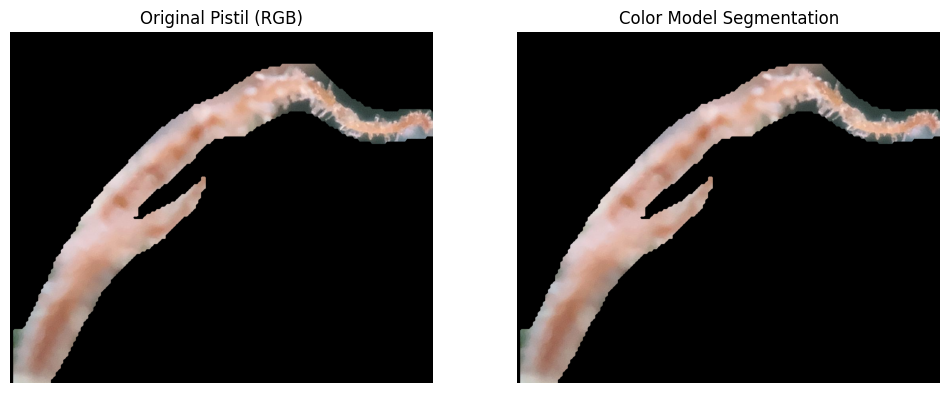

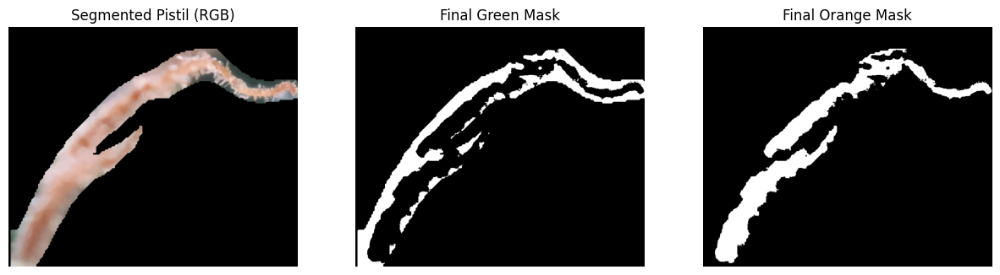

Pistil 9 => Green: 48.11%, Orange: 51.89% (Sum=100.00%)

Processing Pistil 10

0: 512x640 (no detections), 8.7ms
Speed: 1.9ms preprocess, 8.7ms inference, 0.4ms postprocess per image at shape (1, 3, 512, 640)


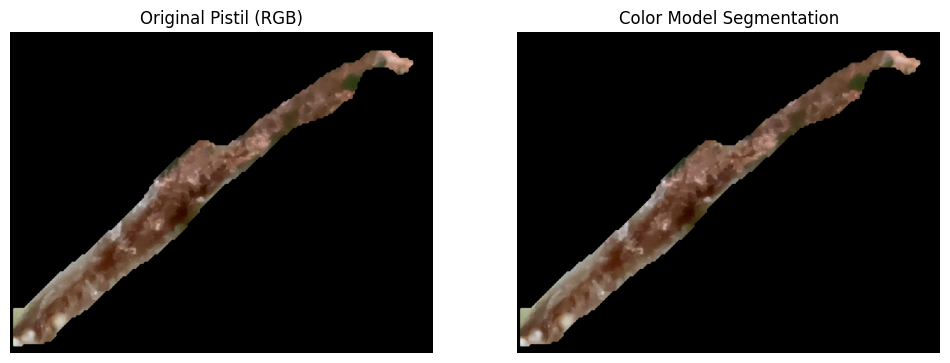

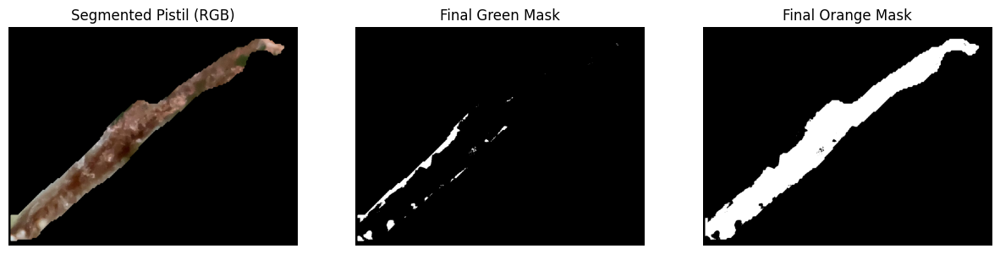

Pistil 10 => Green: 9.24%, Orange: 90.76% (Sum=100.00%)

Processing Pistil 11

0: 640x224 (no detections), 45.5ms
Speed: 1.1ms preprocess, 45.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 224)


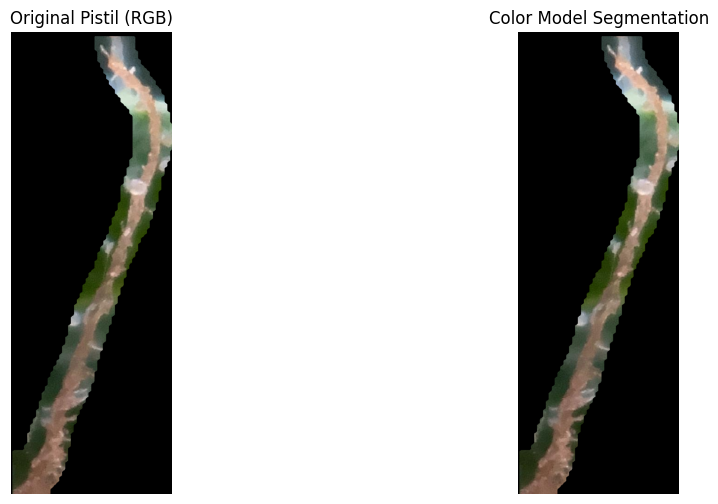

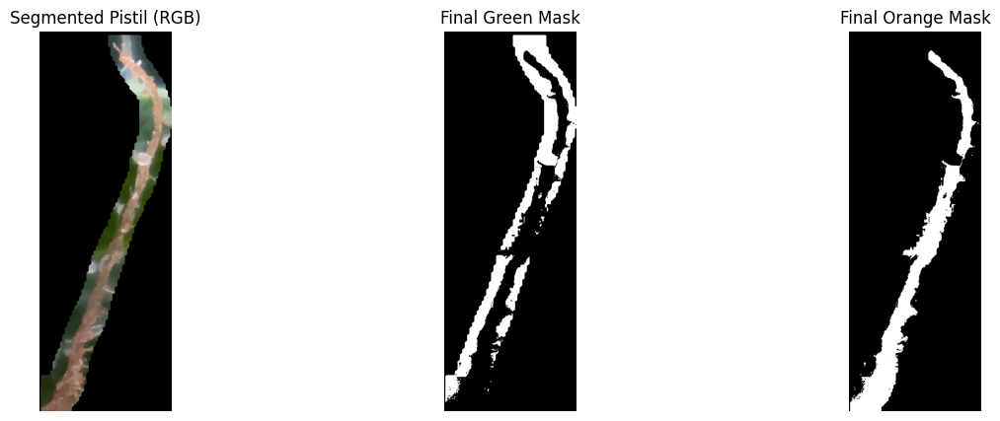

Pistil 11 => Green: 52.63%, Orange: 47.37% (Sum=100.00%)

Processing Pistil 12

0: 192x640 (no detections), 43.1ms
Speed: 1.0ms preprocess, 43.1ms inference, 0.4ms postprocess per image at shape (1, 3, 192, 640)


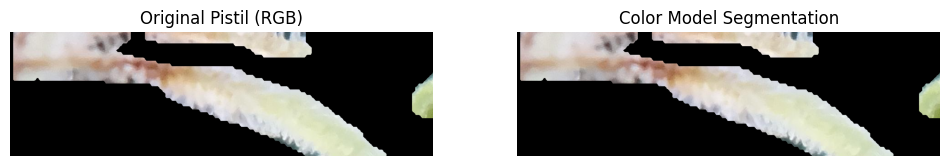

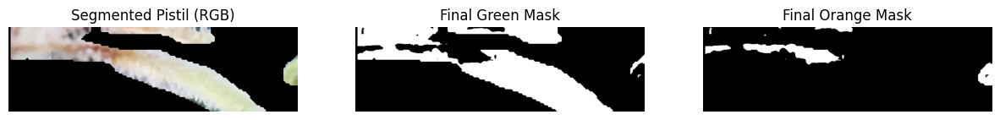

Pistil 12 => Green: 85.07%, Orange: 14.93% (Sum=100.00%)

Processing Pistil 13

0: 608x640 (no detections), 68.3ms
Speed: 2.3ms preprocess, 68.3ms inference, 0.5ms postprocess per image at shape (1, 3, 608, 640)


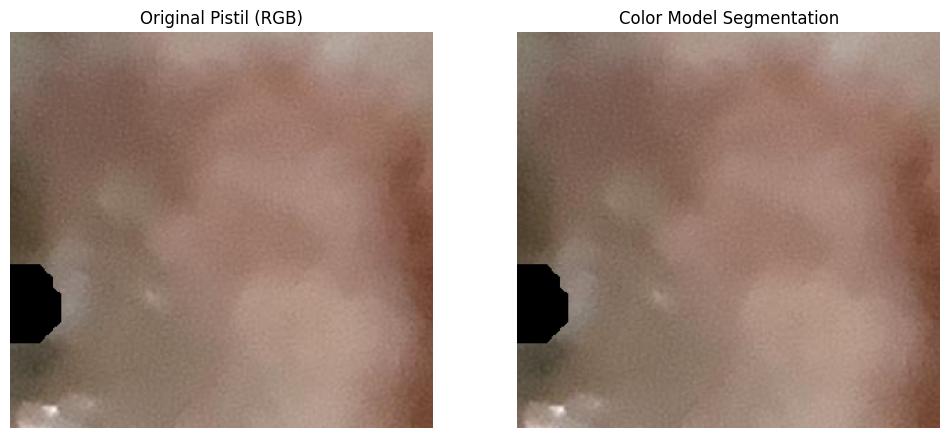

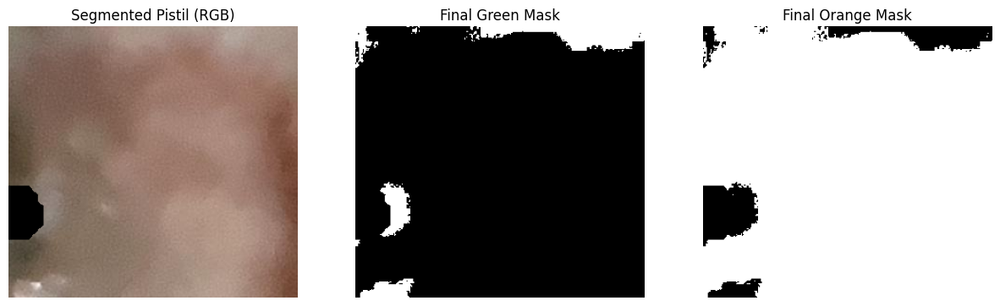

Pistil 13 => Green: 5.81%, Orange: 94.19% (Sum=100.00%)

Processing Pistil 14

0: 320x640 (no detections), 15.2ms
Speed: 2.2ms preprocess, 15.2ms inference, 0.5ms postprocess per image at shape (1, 3, 320, 640)


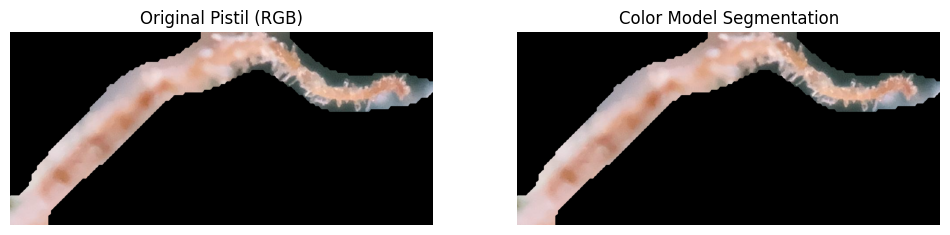

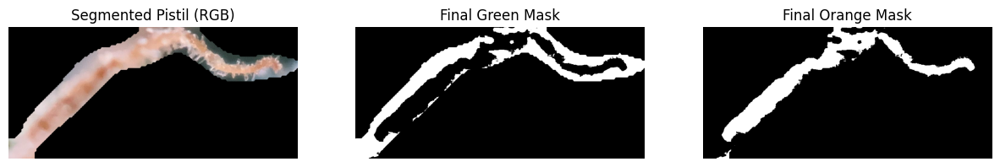

Pistil 14 => Green: 56.02%, Orange: 43.98% (Sum=100.00%)

Processing Pistil 15

0: 256x640 (no detections), 43.8ms
Speed: 1.0ms preprocess, 43.8ms inference, 0.4ms postprocess per image at shape (1, 3, 256, 640)


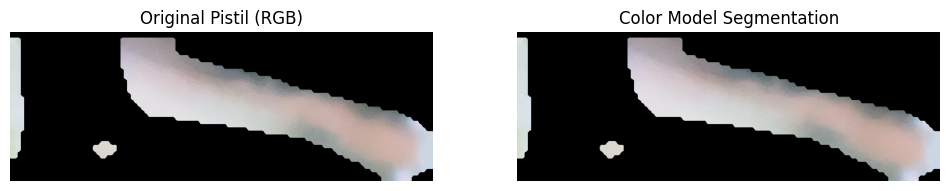

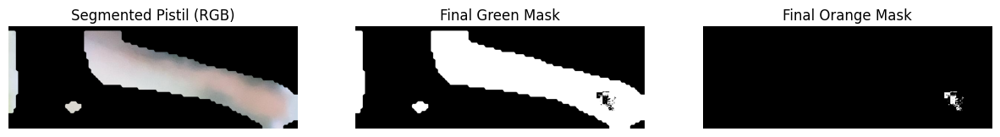

Pistil 15 => Green: 98.86%, Orange: 1.14% (Sum=100.00%)

Processing Pistil 16

0: 576x640 (no detections), 68.0ms
Speed: 2.2ms preprocess, 68.0ms inference, 0.4ms postprocess per image at shape (1, 3, 576, 640)


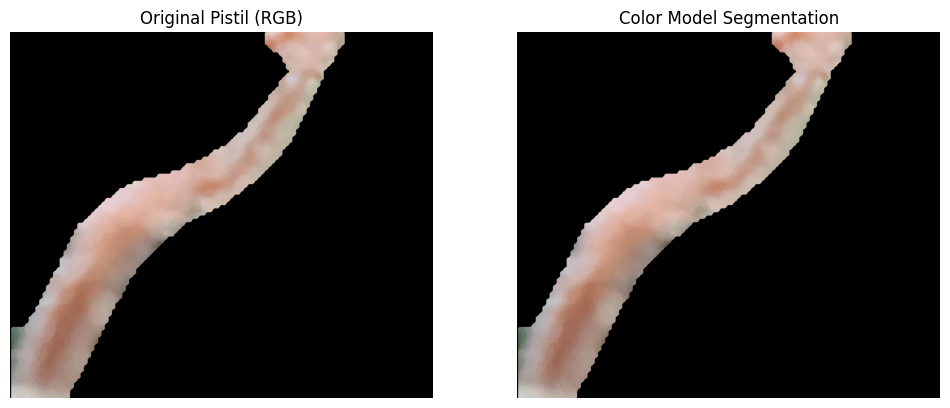

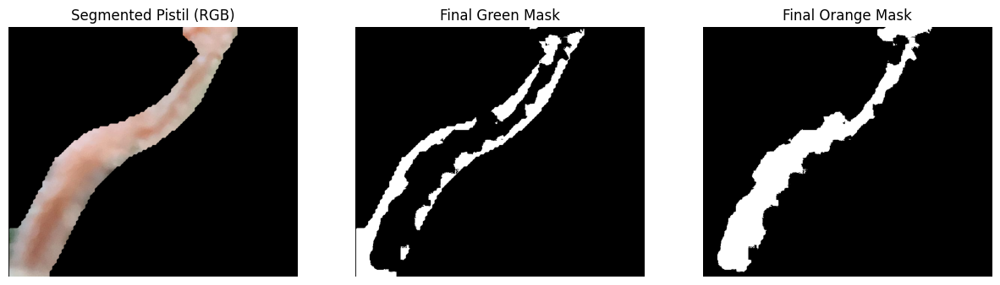

Pistil 16 => Green: 43.45%, Orange: 56.55% (Sum=100.00%)


In [5]:
# Define checkpoint paths and input image
pistils_model_checkpoint = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/yolo/fine_tuned/yolov8s_seg_fine_tuned.pt"
color_model_checkpoint = "/home/etaylor/code_projects/thesis/checkpoints/stigmas_color_segmentation/yolo/fine_tuned/yolov8n-seg_fine_tuned.pt"
image_path = "/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_dataset/yolo_formatted/images/val/day_4_IMG_5942.jpg"

# Run the full pipeline
main_pipeline(image_path, pistils_model_checkpoint, color_model_checkpoint)

### RGB Color Threshold Technique

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

green_data = [
    (214,217,162), (202,207,149), (195,201,155), (216,222,194), (195,199,140),
    (233,237,210), (203,207,148), (192,196,120), (200,204,130), (198,204,134),
    (208,213,159), (221,225,175), (236,240,203), (212,218,180), (203,209,173),
    (232,237,197), (198,202,151), (241,244,215), (127,135,76),  (130,134,73),
    (127,126,70),  (211,216,162), (216,219,166), (210,213,156), (207,213,151),
    (220,224,173), (210,218,169), (211,219,172), (205,214,167), (198,209,151),
    (174,189,146), (206,212,174), (208,215,173), (208,215,181), (208,214,168),
    (127,137,76),  (185,190,132), (154,143,87),  (210,205,149), (217,215,154),
    (218,221,168), (240,236,201), (245,250,218), (218,223,159), (218,221,164),
    (212,218,146), (212,219,139), (216,223,146), (206,209,138), (195,193,118),
    (211,209,158), (223,221,173), (212,211,167)
]

orange_data = [
    (136,90,77),  (95,47,27),   (135,99,67),  (145,99,65),   (128,88,62),
    (141,100,56), (172,146,89), (227,206,163),(225,198,145),(231,207,159),
    (240,220,193),(214,193,148),(156,109,53), (163,121,63), (150,99,46),
    (164,132,93), (179,142,90), (150,105,50), (161,118,67), (193,169,125),
    (206,192,165),(191,165,106),(189,145,98), (213,169,124),(209,177,136),
    (211,176,134),(209,179,143),(207,181,148),(200,176,142),(192,163,131),
    (160,115,58), (167,133,96), (167,127,68), (185,146,105),(193,172,141),
    (141,99,74),  (183,148,116),(173,136,107),(185,154,123),(187,165,141)
]


def classify_pistil_knn_rgb_exclude_black(pistil_bgr, green_data, orange_data, black_threshold=10):
    """
    Classify each pixel as green or orange using 1-NN in RGB space,
    but exclude black/near-black background pixels from classification and ratio counts.

    Args:
        pistil_bgr:       Image loaded with cv2.imread (BGR format).
        green_data:       List of (R, G, B) tuples for green samples.
        orange_data:      List of (R, G, B) tuples for orange samples.
        black_threshold:  Threshold below which a pixel is considered black in each channel.

    Returns:
        (green_ratio, orange_ratio) among non-black pixels.
    """

    # 1) Convert BGR -> RGB if your sample data is in RGB
    pistil_rgb = cv2.cvtColor(pistil_bgr, cv2.COLOR_BGR2RGB)
    h, w = pistil_rgb.shape[:2]

    # 2) Identify black/near-black background pixels
    #    If R,G,B < black_threshold, call it black.
    #    bg_mask is True for background pixels, False for valid pistil.
    bg_mask = np.all(pistil_rgb < black_threshold, axis=-1)  # shape: (H, W)

    # 3) Flatten the image for distance calculations, ignoring black pixels
    pistil_float = pistil_rgb.astype(np.float32).reshape(-1, 3)  # shape: (H*W, 3)
    bg_mask_flat = bg_mask.reshape(-1)                           # shape: (H*W,)

    # valid_indices = array of pixel indices that are NOT black
    valid_indices = np.where(bg_mask_flat == False)[0]

    # If no valid pixels, return 0,0
    if len(valid_indices) == 0:
        print("No valid (non-black) pixels found!")
        return 0.0, 0.0

    # Subset the flattened array to only the valid (non-black) pixels
    valid_pixels = pistil_float[valid_indices]  # shape: (N_valid, 3)

    # 4) Prepare sample data in float arrays
    green_data_arr = np.array(green_data, dtype=np.float32)  # (num_g, 3)
    orange_data_arr = np.array(orange_data, dtype=np.float32)

    # 5) For each valid pixel, compute distance to all green samples, all orange samples
    pixel_expanded = valid_pixels[:, np.newaxis, :]        # (N_valid, 1, 3)
    green_expanded = green_data_arr[np.newaxis, :, :]      # (1, num_g, 3)
    orange_expanded = orange_data_arr[np.newaxis, :, :]

    dist2_green = np.sum((pixel_expanded - green_expanded)**2, axis=2)  # (N_valid, num_g)
    dist2_orange = np.sum((pixel_expanded - orange_expanded)**2, axis=2)

    min_dist2_green = np.min(dist2_green, axis=1)  # (N_valid,)
    min_dist2_orange = np.min(dist2_orange, axis=1)

    # 6) Classify valid pixels
    green_mask_valid = min_dist2_green < min_dist2_orange  # True => green, else orange

    # 7) Build the full classification mask (for visualization)
    #    We'll create an array of labels for ALL pixels (including black).
    #    Label = 0 => black BG, 1 => green, 2 => orange
    labels = np.zeros((h*w,), dtype=np.uint8)
    # By default, everything is 0 (black)
    # For valid pixels, set 1 if green, 2 if orange
    labels[valid_indices[green_mask_valid]] = 1
    labels[valid_indices[~green_mask_valid]] = 2
    labels_2d = labels.reshape(h, w)

    # 8) Count
    green_count = np.count_nonzero(labels_2d == 1)
    orange_count = np.count_nonzero(labels_2d == 2)
    total_valid = green_count + orange_count  # same as len(valid_indices)

    green_ratio = green_count / total_valid
    orange_ratio = orange_count / total_valid

    # 9) Create color-coded image for visualization
    classified_img = np.zeros_like(pistil_rgb, dtype=np.uint8)

    # Mark black background as black
    classified_img[labels_2d == 0] = (0, 0, 0)
    # Mark green
    classified_img[labels_2d == 1] = (0, 255, 0)
    # Mark orange
    classified_img[labels_2d == 2] = (255, 165, 0)

    # 10) Display
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(pistil_rgb.astype(np.uint8))
    axes[0].set_title("Original Pistil (RGB)")
    axes[0].axis("off")

    axes[1].imshow(classified_img)
    axes[1].set_title("Classified (1-NN), Black BG Excluded")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

    print(f"Green Ratio (non-black):  {green_ratio*100:.2f}%")
    print(f"Orange Ratio (non-black): {orange_ratio*100:.2f}%")
    print(f"Total non-black pixels:   {total_valid}")
    return green_ratio, orange_ratio



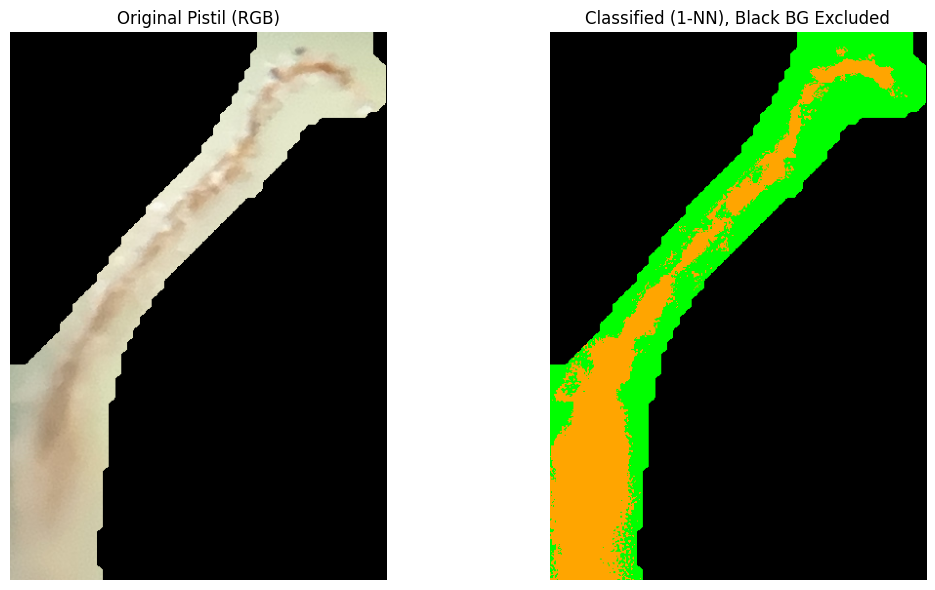

Green Ratio (non-black):  56.29%
Orange Ratio (non-black): 43.71%
Total non-black pixels:   55989
Orange Ratio: 43.71%, Green Ratio: 56.29%, Sum=100.00%


In [19]:
pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_0526_pistil_9.png")
# Example usage:
g_ratio, o_ratio = classify_pistil_knn_rgb_exclude_black(pistil_bgr, green_data, orange_data)

print(f"Orange Ratio: {o_ratio*100:.2f}%, Green Ratio: {g_ratio*100:.2f}%, Sum={(o_ratio+g_ratio)*100:.2f}%")

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data, 
                                   black_thresh=10, white_thresh=240):
    """
    Classify each pixel as green or orange using 1-NN in RGB space,
    but exclude background pixels that are near-black or near-white.

    Args:
        pistil_bgr:   Image loaded with cv2.imread (BGR format).
        green_data:   List of (R, G, B) tuples for green samples.
        orange_data:  List of (R, G, B) tuples for orange samples.
        black_thresh: Below this, a pixel is considered black background.
        white_thresh: Above this, a pixel is considered white background.

    Returns:
        (green_ratio, orange_ratio) among non-background pixels.
    """

    # 1) Convert from BGR -> RGB if sample data is in RGB
    pistil_rgb = cv2.cvtColor(pistil_bgr, cv2.COLOR_BGR2RGB)
    h, w = pistil_rgb.shape[:2]

    # 2) Identify black or near-black pixels
    bg_mask_black = np.all(pistil_rgb < black_thresh, axis=-1)
    # 3) Identify white or near-white pixels
    bg_mask_white = np.all(pistil_rgb > white_thresh, axis=-1)
    # Combine them into a single background mask
    bg_mask = bg_mask_black | bg_mask_white

    # 4) Flatten for classification
    pistil_flat = pistil_rgb.reshape(-1, 3).astype(np.float32)
    bg_mask_flat = bg_mask.reshape(-1)

    valid_indices = np.where(bg_mask_flat == False)[0]
    if len(valid_indices) == 0:
        print("No valid (non-BG) pixels found!")
        return 0.0, 0.0

    valid_pixels = pistil_flat[valid_indices]  # shape: (N_valid, 3)

    # 5) Convert your sample data to numpy arrays
    green_arr = np.array(green_data, dtype=np.float32)  # (num_green, 3)
    orange_arr = np.array(orange_data, dtype=np.float32)

    # 6) For each valid pixel, compute min distance to any green vs. any orange sample
    pixel_expanded = valid_pixels[:, np.newaxis, :]      # (N_valid, 1, 3)
    green_expanded = green_arr[np.newaxis, :, :]         # (1, num_green, 3)
    orange_expanded = orange_arr[np.newaxis, :, :]

    dist2_green = np.sum((pixel_expanded - green_expanded)**2, axis=2)  # (N_valid, num_green)
    dist2_orange = np.sum((pixel_expanded - orange_expanded)**2, axis=2)

    min_dist2_green = np.min(dist2_green, axis=1)
    min_dist2_orange = np.min(dist2_orange, axis=1)

    # 7) Determine which valid pixels are green vs. orange
    is_green_valid = min_dist2_green < min_dist2_orange  # shape: (N_valid,)
    is_orange_valid = ~is_green_valid

    # 8) Create label array for the entire image (including BG)
    #    0 => background, 1 => green, 2 => orange
    labels = np.zeros((h*w,), dtype=np.uint8)
    labels[valid_indices[is_green_valid]] = 1
    labels[valid_indices[is_orange_valid]] = 2
    labels_2d = labels.reshape(h, w)

    # 9) Compute classification ratios among valid (non-BG) pixels
    green_count = np.count_nonzero(labels_2d == 1)
    orange_count = np.count_nonzero(labels_2d == 2)
    total_valid = green_count + orange_count
    green_ratio = green_count / total_valid
    orange_ratio = orange_count / total_valid

    # 10) Build a color-coded visualization
    classified_img = np.zeros_like(pistil_rgb, dtype=np.uint8)
    # Keep BG as black (0,0,0)
    classified_img[labels_2d == 1] = (0, 255, 0)      # green
    classified_img[labels_2d == 2] = (255, 165, 0)    # orange

    # 11) Display
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(pistil_rgb)
    axes[0].set_title("Original Pistil (RGB)")
    axes[0].axis("off")

    axes[1].imshow(classified_img)
    axes[1].set_title("Classified (1-NN), BG Excluded (black/white)")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

    # 12) Print results
    print(f"Green Ratio (non-BG):  {green_ratio*100:.2f}%")
    print(f"Orange Ratio (non-BG): {orange_ratio*100:.2f}%")
    print(f"Total non-BG pixels:   {total_valid}")
    return green_ratio, orange_ratio


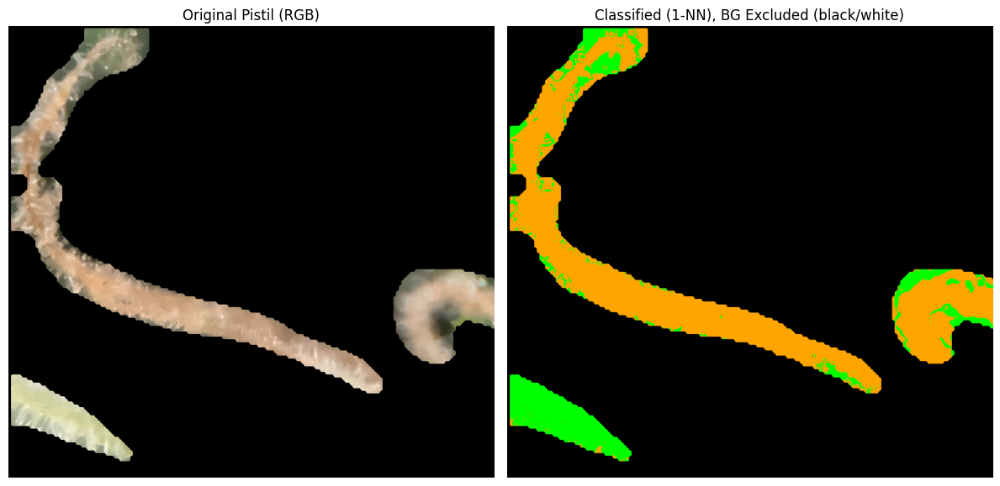

Green Ratio (non-BG):  25.98%
Orange Ratio (non-BG): 74.02%
Total non-BG pixels:   183214


In [25]:
# Usage:
pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_5312_pistil_7.png")
g_ratio, o_ratio = classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data)

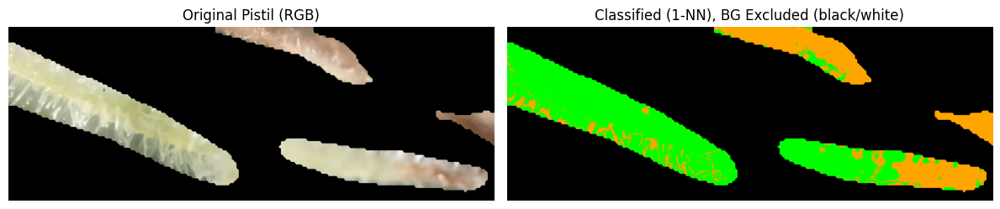

Green Ratio (non-BG):  64.47%
Orange Ratio (non-BG): 35.53%
Total non-BG pixels:   162004


In [27]:
pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_5312_pistil_11.png")
g_ratio, o_ratio = classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data)

In [28]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def classify_pistil_knn_3classes(
    pistil_bgr,
    green_data,
    orange_data,
    white_bg_data,
    black_threshold=10
):
    """
    Classify each pixel into:
      - 1 = Green   (closest to any green sample)
      - 2 = Orange  (closest to any orange sample)
      - 3 = WhiteBG (closest to any white/off-white sample)
      - 0 = BlackBG (pixels below black_threshold)

    Then compute green/orange ratios among non-background pixels (i.e., labels 1 or 2).
    """

    # 1) Convert from BGR -> RGB if your sample data is in RGB
    pistil_rgb = cv2.cvtColor(pistil_bgr, cv2.COLOR_BGR2RGB)
    h, w = pistil_rgb.shape[:2]

    # 2) Identify black/near-black background (optional)
    #    If a pixel's R,G,B are all < black_threshold, call it black background.
    #    This can handle pure black or dark shadows.
    black_bg_mask = np.all(pistil_rgb < black_threshold, axis=-1)  # shape: (H, W)

    # 3) Flatten the image for distance calculations
    pistil_flat = pistil_rgb.reshape(-1, 3).astype(np.float32)  # (H*W, 3)
    black_bg_mask_flat = black_bg_mask.reshape(-1)

    # We'll only run nearest-neighbor on non-black pixels.
    valid_indices = np.where(black_bg_mask_flat == False)[0]
    if len(valid_indices) == 0:
        print("No non-black pixels found!")
        return 0.0, 0.0

    valid_pixels = pistil_flat[valid_indices]  # shape: (N_valid, 3)

    # 4) Convert sample data to numpy arrays
    green_arr  = np.array(green_data,  dtype=np.float32)  # (num_green, 3)
    orange_arr = np.array(orange_data, dtype=np.float32)  # (num_orange, 3)
    white_arr  = np.array(white_bg_data, dtype=np.float32)# (num_white, 3)

    # 5) For each valid pixel, compute distance to each sample in green, orange, white
    #    We'll find which class is closest.
    pixel_expanded  = valid_pixels[:, np.newaxis, :]  # (N_valid, 1, 3)
    
    # Expand green/orange/white arrays for broadcasting
    green_expanded  = green_arr[np.newaxis, :, :]     # (1, num_green, 3)
    orange_expanded = orange_arr[np.newaxis, :, :]
    white_expanded  = white_arr[np.newaxis, :, :]

    dist2_green  = np.sum((pixel_expanded - green_expanded) ** 2, axis=2)   # (N_valid, num_green)
    dist2_orange = np.sum((pixel_expanded - orange_expanded) ** 2, axis=2)
    dist2_white  = np.sum((pixel_expanded - white_expanded)  ** 2, axis=2)

    # Minimum distance to each class
    min_dist2_green  = np.min(dist2_green,  axis=1)
    min_dist2_orange = np.min(dist2_orange, axis=1)
    min_dist2_white  = np.min(dist2_white,  axis=1)

    # 6) Determine which class is closest for each valid pixel
    #    We'll store them in an integer array, e.g. 1=green, 2=orange, 3=whiteBG
    labels_valid = np.zeros((len(valid_pixels),), dtype=np.uint8)

    # For each pixel, compare the three distances
    # A quick way: stack them, find argmin
    dist_stack = np.stack([min_dist2_green, min_dist2_orange, min_dist2_white], axis=1)
    # shape: (N_valid, 3). Each row => [distGreen, distOrange, distWhite]
    closest_class = np.argmin(dist_stack, axis=1)  # 0 => green, 1 => orange, 2 => white

    # Assign labels: +1 so that 0->1, 1->2, 2->3
    labels_valid = closest_class + 1

    # 7) Build a label array for the entire image
    #    0 => blackBG, 1 => green, 2 => orange, 3 => whiteBG
    labels_full = np.zeros((h*w,), dtype=np.uint8)
    labels_full[valid_indices] = labels_valid
    labels_2d = labels_full.reshape(h, w)

    # 8) Create a visualization
    #    We'll mark black BG as black, green as (0,255,0), orange as (255,165,0),
    #    white BG as (255,255,255).
    classified_img = np.zeros_like(pistil_rgb, dtype=np.uint8)

    classified_img[labels_2d == 0] = (0, 0, 0)          # black
    classified_img[labels_2d == 1] = (0, 255, 0)        # green
    classified_img[labels_2d == 2] = (255, 165, 0)      # orange
    classified_img[labels_2d == 3] = (255, 255, 255)    # white

    # 9) Compute ratios among non-background pixels (labels 1 or 2)
    green_count  = np.count_nonzero(labels_2d == 1)
    orange_count = np.count_nonzero(labels_2d == 2)
    total_pistil = green_count + orange_count
    if total_pistil == 0:
        # If the entire non-black region was classified as white BG,
        # then we have no actual pistil pixels left to measure.
        print("No green/orange pixels found after excluding backgrounds!")
        return 0.0, 0.0

    green_ratio  = green_count / total_pistil
    orange_ratio = orange_count / total_pistil

    # 10) Display
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(pistil_rgb)
    axes[0].set_title("Original Pistil (RGB)")
    axes[0].axis("off")

    axes[1].imshow(classified_img)
    axes[1].set_title("Classified (Green, Orange, WhiteBG, BlackBG)")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

    print(f"Green Ratio (non-BG):  {green_ratio*100:.2f}%")
    print(f"Orange Ratio (non-BG): {orange_ratio*100:.2f}%")
    return green_ratio, orange_ratio


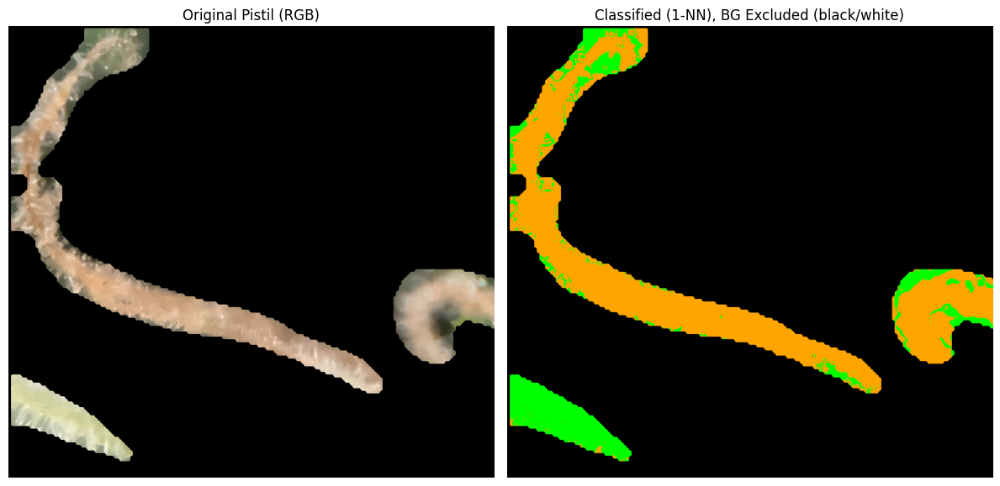

Green Ratio (non-BG):  25.98%
Orange Ratio (non-BG): 74.02%
Total non-BG pixels:   183214


In [38]:
white_bg_data = [
    (222,218,192), (221,220,192), (229,232,203),
    (225,228,197), (207,213,179), (184,186,164),
    (209,206,180), (208,207,179), (229,225,198)
]

pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_5312_pistil_7.png")


g_ratio, o_ratio = classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data)

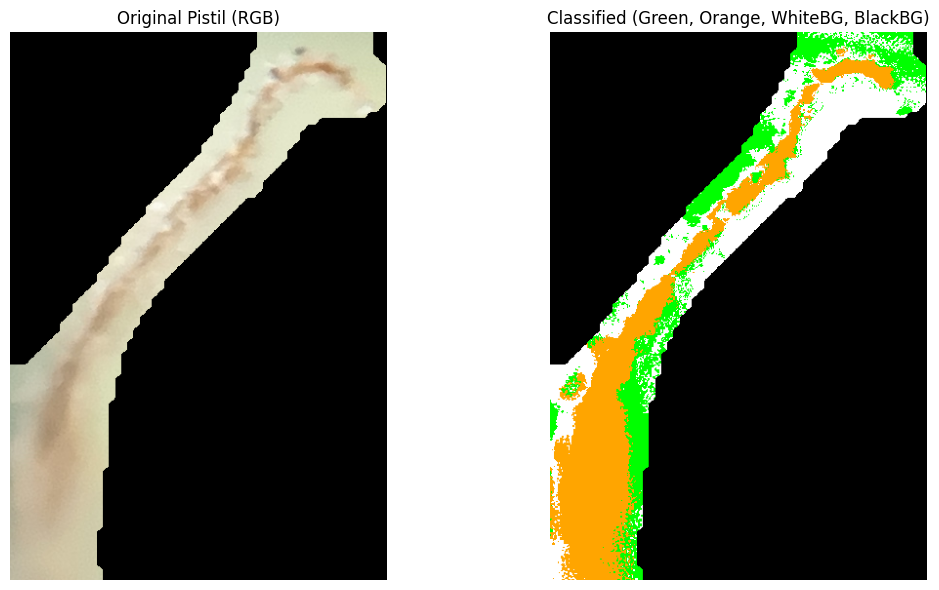

Green Ratio (non-BG):  37.33%
Orange Ratio (non-BG): 62.67%


In [32]:
pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_0526_pistil_9.png")

g_ratio, o_ratio = classify_pistil_knn_3classes(pistil_bgr, green_data, orange_data, white_bg_data)

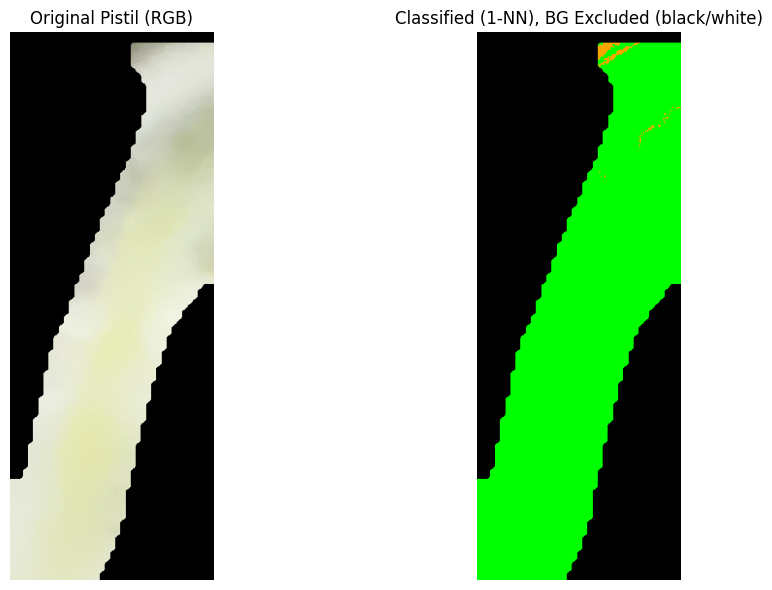

Green Ratio (non-BG):  99.32%
Orange Ratio (non-BG): 0.68%
Total non-BG pixels:   83572


In [37]:
pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_5312_pistil_9.png")

g_ratio, o_ratio = classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data)

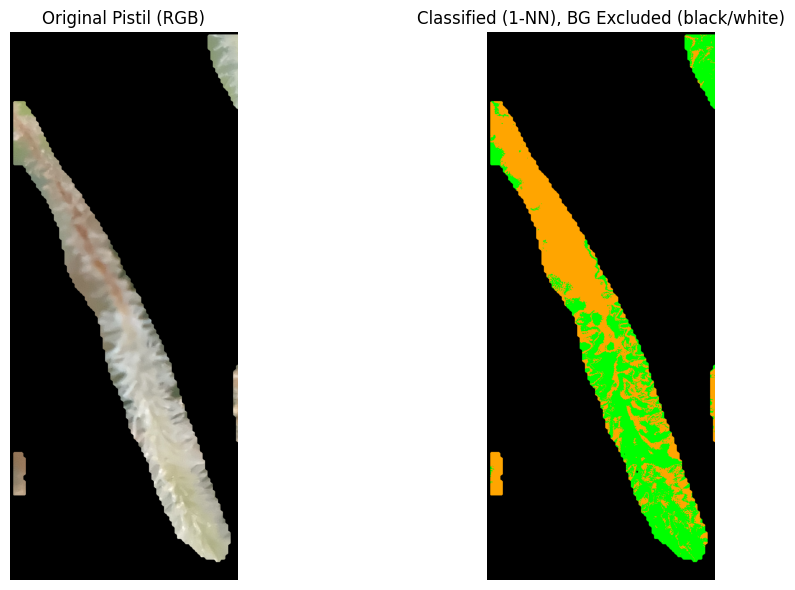

Green Ratio (non-BG):  46.47%
Orange Ratio (non-BG): 53.53%
Total non-BG pixels:   153424


In [36]:
pistil_bgr = cv2.imread("/home/etaylor/code_projects/thesis/segments/etaylor_stigmas_color_dataset/v0.2/IMG_5312_pistil_10.png")

g_ratio, o_ratio = classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data)

In [42]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

###############################################################################
# 1) YOLO Model Loading
###############################################################################

def load_yolo_model(checkpoint_path):
    """Loads a YOLO model from the given checkpoint path."""
    return YOLO(checkpoint_path)

###############################################################################
# 2) Pistil Segmentation with YOLO
###############################################################################

def segment_pistils(image_bgr, model):
    """
    Runs the pistil segmentation model on a BGR image.
    Returns the first YOLO result object.
    """
    results = model.predict(
    source=image_bgr,
    conf=0.3,   
    iou=0.45
    )
    return results[0]

def extract_segmented_objects(image_rgb, result, save_dir=None):
    """
    Extracts individual pistils from the YOLO segmentation result.

    Args:
        image_rgb:  The original image in RGB format.
        result:     The YOLO result (must have segmentation masks).
        save_dir:   Optional directory to save each extracted pistil.

    Returns:
        A list of cropped pistils (each in RGB).
    """
    if result.masks is None or result.masks.data is None:
        print("No pistils detected.")
        return []

    masks = result.masks.data.cpu().numpy()
    boxes = result.boxes.xyxy.cpu().numpy()

    extracted_segments = []
    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for i, mask in enumerate(masks):
        # Resize mask to match the original image size and binarize
        resized_mask = cv2.resize(mask, (image_rgb.shape[1], image_rgb.shape[0]))
        binary_mask = (resized_mask > 0.5).astype(np.uint8)

        # Apply mask to the RGB image
        segmented_object = cv2.bitwise_and(image_rgb, image_rgb, mask=binary_mask)

        # Crop using bounding box
        x_min, y_min, x_max, y_max = map(int, boxes[i])
        cropped_object = segmented_object[y_min:y_max, x_min:x_max]
        extracted_segments.append(cropped_object)

        # Optionally save each pistil
        if save_dir:
            save_path = os.path.join(save_dir, f"pistil_{i+1}.png")
            cv2.imwrite(save_path, cv2.cvtColor(cropped_object, cv2.COLOR_RGB2BGR))
            print(f"Saved pistil: {save_path}")

    return extracted_segments

def visualize_segmented_objects(segmented_objects):
    """Displays each extracted pistil side by side."""
    if not segmented_objects:
        print("No pistils to display.")
        return

    fig, axes = plt.subplots(1, len(segmented_objects), figsize=(16, 8))
    if len(segmented_objects) == 1:
        axes.imshow(segmented_objects[0])
        axes.set_title("Segment 1")
        axes.axis("off")
    else:
        for idx, obj in enumerate(segmented_objects):
            axes[idx].imshow(obj)
            axes[idx].set_title(f"Segment {idx+1}")
            axes[idx].axis("off")
    plt.tight_layout()
    plt.show()

###############################################################################
# 3) Your 1-NN Color Classification Function
###############################################################################

def classify_pistil_colors_with_knn(pistil_bgr, green_data, orange_data, 
                                   black_thresh=10, white_thresh=240):
    """
    Classify each pixel as green or orange using 1-NN in RGB space,
    but exclude background pixels that are near-black or near-white.

    Args:
        pistil_bgr:   Image loaded with cv2.imread (BGR format).
        green_data:   List of (R, G, B) tuples for green samples.
        orange_data:  List of (R, G, B) tuples for orange samples.
        black_thresh: Below this, a pixel is considered black background.
        white_thresh: Above this, a pixel is considered white background.

    Returns:
        (green_ratio, orange_ratio) among non-background pixels.
    """

    # 1) Convert from BGR -> RGB if sample data is in RGB
    pistil_rgb = cv2.cvtColor(pistil_bgr, cv2.COLOR_BGR2RGB)
    h, w = pistil_rgb.shape[:2]

    # 2) Identify black or near-black pixels
    bg_mask_black = np.all(pistil_rgb < black_thresh, axis=-1)
    # 3) Identify white or near-white pixels
    bg_mask_white = np.all(pistil_rgb > white_thresh, axis=-1)
    # Combine them into a single background mask
    bg_mask = bg_mask_black | bg_mask_white

    # 4) Flatten for classification
    pistil_flat = pistil_rgb.reshape(-1, 3).astype(np.float32)
    bg_mask_flat = bg_mask.reshape(-1)

    valid_indices = np.where(bg_mask_flat == False)[0]
    if len(valid_indices) == 0:
        print("No valid (non-BG) pixels found!")
        return 0.0, 0.0

    valid_pixels = pistil_flat[valid_indices]  # shape: (N_valid, 3)

    # 5) Convert your sample data to numpy arrays
    green_arr = np.array(green_data, dtype=np.float32)  # (num_green, 3)
    orange_arr = np.array(orange_data, dtype=np.float32)

    # 6) For each valid pixel, compute min distance to any green vs. any orange sample
    pixel_expanded = valid_pixels[:, np.newaxis, :]      # (N_valid, 1, 3)
    green_expanded = green_arr[np.newaxis, :, :]         # (1, num_green, 3)
    orange_expanded = orange_arr[np.newaxis, :, :]

    dist2_green = np.sum((pixel_expanded - green_expanded)**2, axis=2)  # (N_valid, num_green)
    dist2_orange = np.sum((pixel_expanded - orange_expanded)**2, axis=2)

    min_dist2_green = np.min(dist2_green, axis=1)
    min_dist2_orange = np.min(dist2_orange, axis=1)

    # 7) Determine which valid pixels are green vs. orange
    is_green_valid = min_dist2_green < min_dist2_orange
    is_orange_valid = ~is_green_valid

    # 8) Create label array for the entire image (including BG)
    labels = np.zeros((h*w,), dtype=np.uint8)
    labels[valid_indices[is_green_valid]] = 1  # 1 => green
    labels[valid_indices[is_orange_valid]] = 2  # 2 => orange
    labels_2d = labels.reshape(h, w)

    # 9) Compute classification ratios among valid (non-BG) pixels
    green_count = np.count_nonzero(labels_2d == 1)
    orange_count = np.count_nonzero(labels_2d == 2)
    total_valid = green_count + orange_count
    green_ratio = green_count / total_valid
    orange_ratio = orange_count / total_valid

    # 10) Build a color-coded visualization
    classified_img = np.zeros_like(pistil_rgb, dtype=np.uint8)
    # Keep BG as black (0,0,0)
    classified_img[labels_2d == 1] = (0, 255, 0)      # green
    classified_img[labels_2d == 2] = (255, 165, 0)    # orange

    # 11) Display
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(pistil_rgb)
    axes[0].set_title("Original Pistil (RGB)")
    axes[0].axis("off")

    axes[1].imshow(classified_img)
    axes[1].set_title("Classified (1-NN), BG Excluded (black/white)")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

    # 12) Print results
    print(f"Green Ratio (non-BG):  {green_ratio*100:.2f}%")
    print(f"Orange Ratio (non-BG): {orange_ratio*100:.2f}%")
    print(f"Total non-BG pixels:   {total_valid}")

    return green_ratio, orange_ratio

###############################################################################
# 4) Main Pipeline - Pistil Segmentation + 1-NN Color Classification
###############################################################################

def main_pipeline(
    image_path,
    pistils_model_checkpoint,
    green_data,
    orange_data,
    save_dir=None
):
    """
    1) Loads the pistil segmentation model.
    2) Segments pistils from the input image.
    3) For each segmented pistil (cropped in RGB):
       - Convert to BGR
       - Run your 1-NN color classification function
       - Print or store the green/orange ratio
    """

    # (A) Load the YOLO pistil segmentation model
    pistils_model = load_yolo_model(pistils_model_checkpoint)

    # (B) Read the input image (BGR)
    image_bgr = cv2.imread(image_path)
    if image_bgr is None:
        print(f"Error: cannot load image at {image_path}")
        return

    # Convert to RGB for display and segmentation mask extraction
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    # (C) Run YOLO to segment pistils
    print(f"Segmenting pistils in: {os.path.basename(image_path)}")
    pistils_result = segment_pistils(image_bgr, pistils_model)

    # YOLO's annotated image for visualization
    annotated_bgr = pistils_result.plot()
    annotated_rgb = cv2.cvtColor(annotated_bgr, cv2.COLOR_BGR2RGB)

    # Show original vs. YOLO segmentation
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(image_rgb)
    axes[0].set_title("Original Image (RGB)")
    axes[0].axis("off")
    axes[1].imshow(annotated_rgb)
    axes[1].set_title("Pistils Segmentation (YOLO)")
    axes[1].axis("off")
    plt.show()

    # (D) Extract cropped pistil images (in RGB)
    pistils = extract_segmented_objects(image_rgb, pistils_result, save_dir=save_dir)
    visualize_segmented_objects(pistils)

    # (E) For each cropped pistil, run your 1-NN classification
    for i, seg_obj_rgb in enumerate(pistils):
        print(f"\n===== Pistil {i+1} =====")
        # 1) Convert from RGB -> BGR for your function
        pistil_bgr = cv2.cvtColor(seg_obj_rgb, cv2.COLOR_RGB2BGR)

        # 2) Run the 1-NN color classification
        g_ratio, o_ratio = classify_pistil_colors_with_knn(
            pistil_bgr,
            green_data,
            orange_data,
            black_thresh=10,
            white_thresh=240
        )

        # 3) Print ratio
        print(f"1-NN => Green: {g_ratio*100:.2f}%, Orange: {o_ratio*100:.2f}%")

Segmenting pistils in: IMG_8716.JPG

0: 480x640 6 stigmas, 8.2ms
Speed: 2.8ms preprocess, 8.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


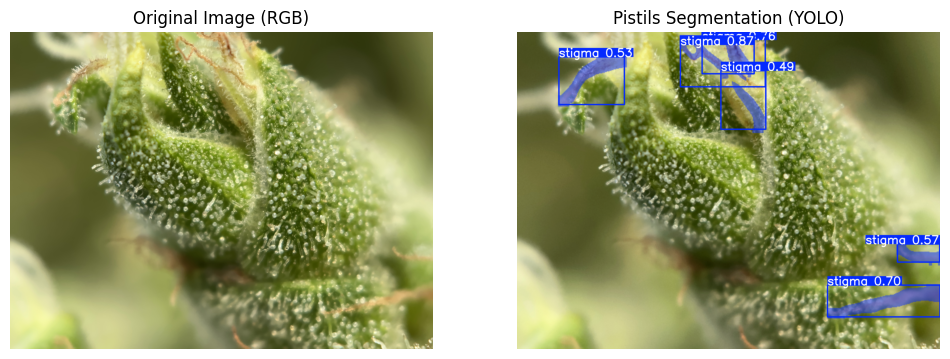

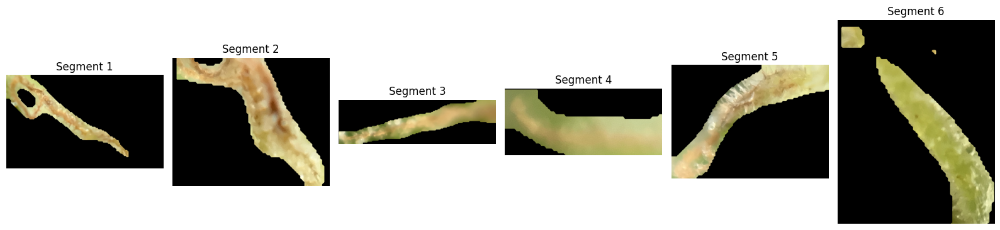


===== Pistil 1 =====


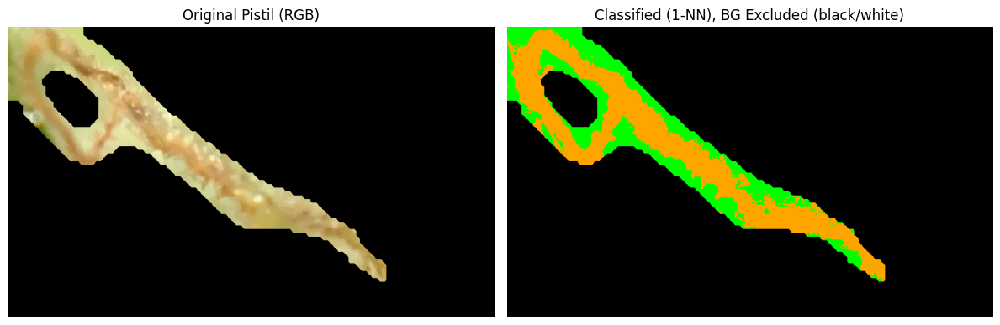

Green Ratio (non-BG):  40.11%
Orange Ratio (non-BG): 59.89%
Total non-BG pixels:   63279
1-NN => Green: 40.11%, Orange: 59.89%

===== Pistil 2 =====


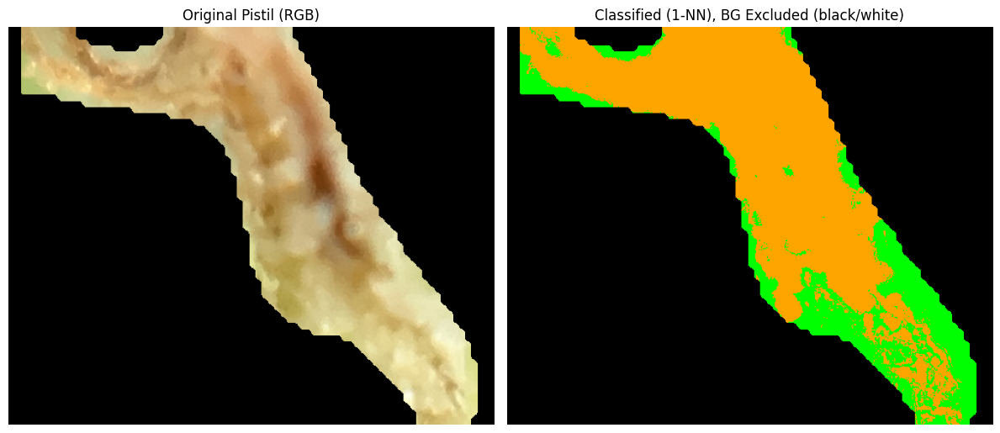

Green Ratio (non-BG):  26.11%
Orange Ratio (non-BG): 73.89%
Total non-BG pixels:   65211
1-NN => Green: 26.11%, Orange: 73.89%

===== Pistil 3 =====


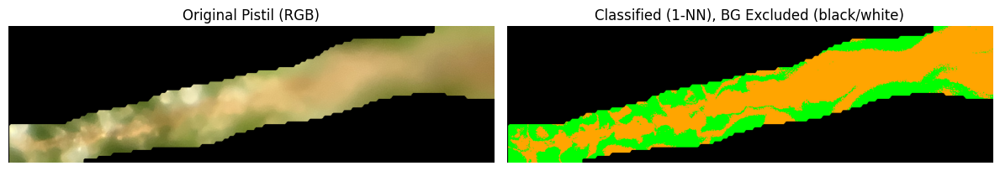

Green Ratio (non-BG):  36.96%
Orange Ratio (non-BG): 63.04%
Total non-BG pixels:   132868
1-NN => Green: 36.96%, Orange: 63.04%

===== Pistil 4 =====


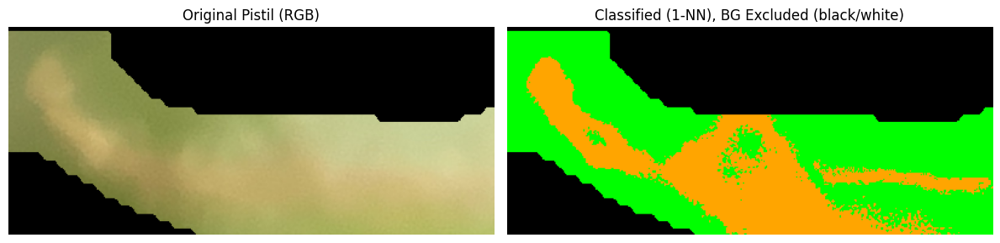

Green Ratio (non-BG):  63.00%
Orange Ratio (non-BG): 37.00%
Total non-BG pixels:   40970
1-NN => Green: 63.00%, Orange: 37.00%

===== Pistil 5 =====


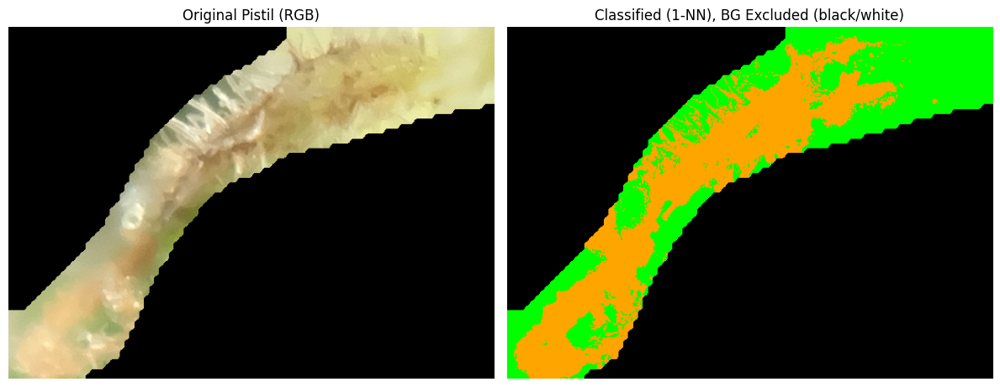

Green Ratio (non-BG):  50.68%
Orange Ratio (non-BG): 49.32%
Total non-BG pixels:   89846
1-NN => Green: 50.68%, Orange: 49.32%

===== Pistil 6 =====


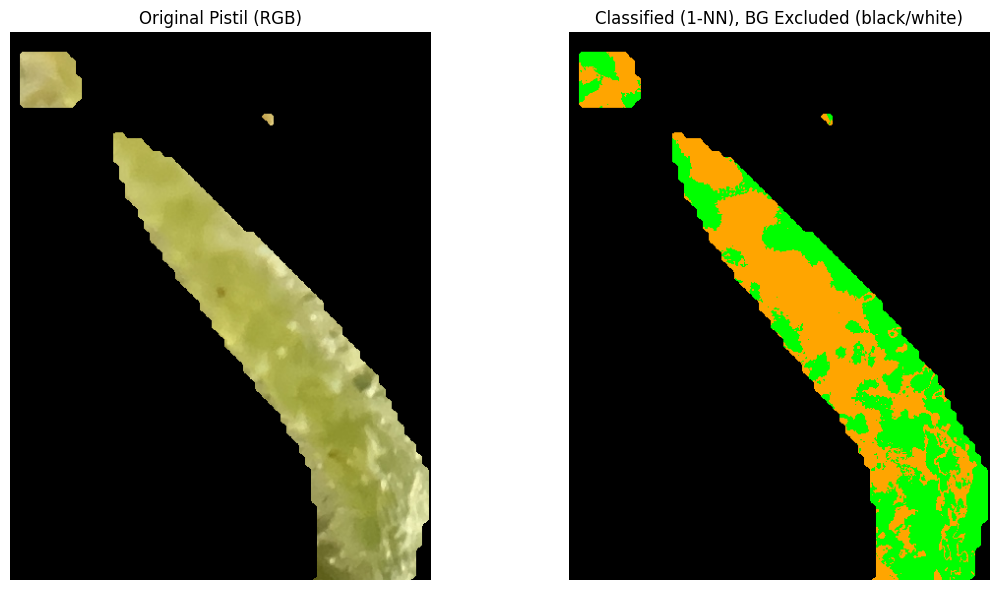

Green Ratio (non-BG):  48.40%
Orange Ratio (non-BG): 51.60%
Total non-BG pixels:   52672
1-NN => Green: 48.40%, Orange: 51.60%


In [43]:
# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)

Segmenting pistils in: IMG_8716.JPG

0: 480x640 6 stigmas, 8.0ms
Speed: 2.3ms preprocess, 8.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


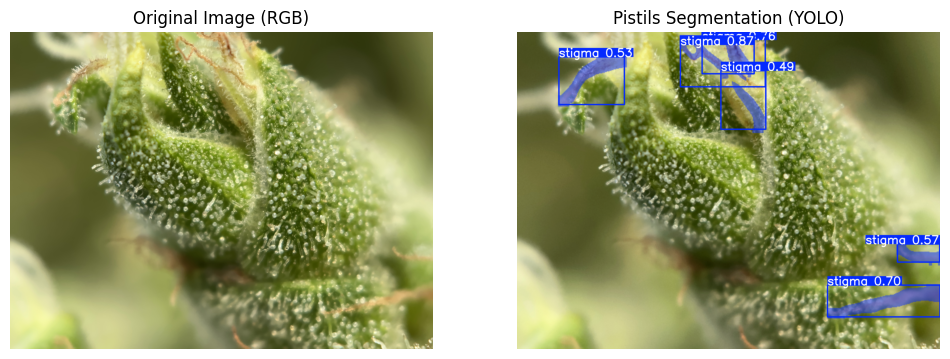

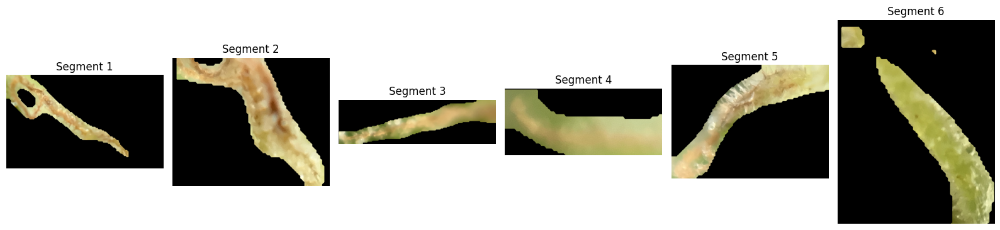


===== Pistil 1 =====


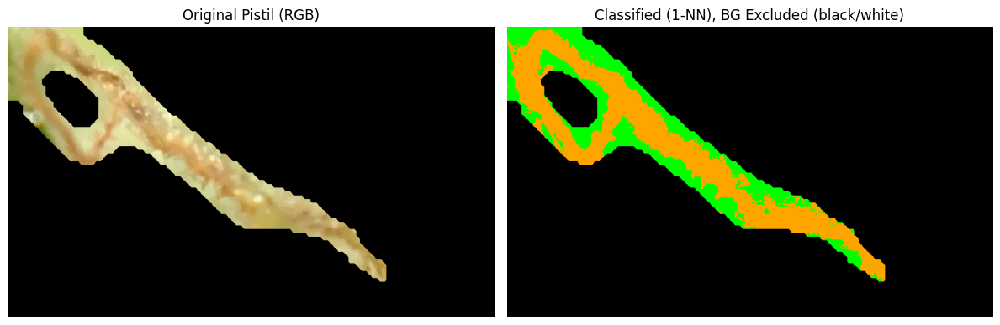

Green Ratio (non-BG):  40.11%
Orange Ratio (non-BG): 59.89%
Total non-BG pixels:   63279
1-NN => Green: 40.11%, Orange: 59.89%

===== Pistil 2 =====


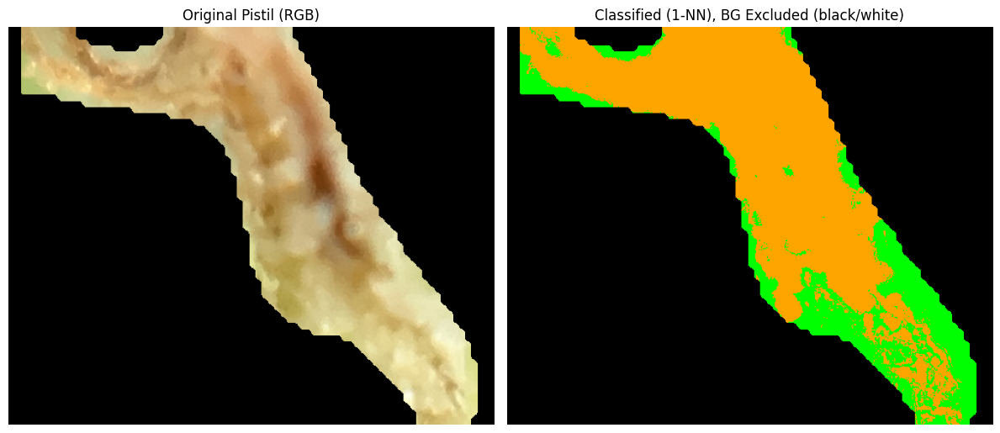

Green Ratio (non-BG):  26.11%
Orange Ratio (non-BG): 73.89%
Total non-BG pixels:   65211
1-NN => Green: 26.11%, Orange: 73.89%

===== Pistil 3 =====


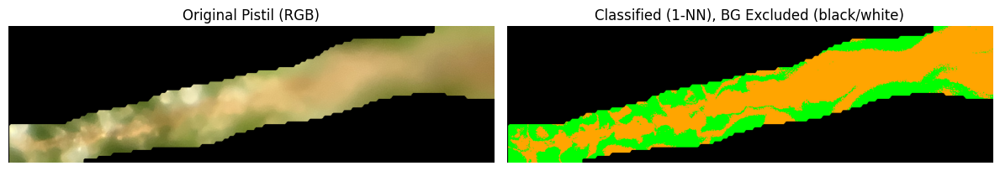

Green Ratio (non-BG):  36.96%
Orange Ratio (non-BG): 63.04%
Total non-BG pixels:   132868
1-NN => Green: 36.96%, Orange: 63.04%

===== Pistil 4 =====


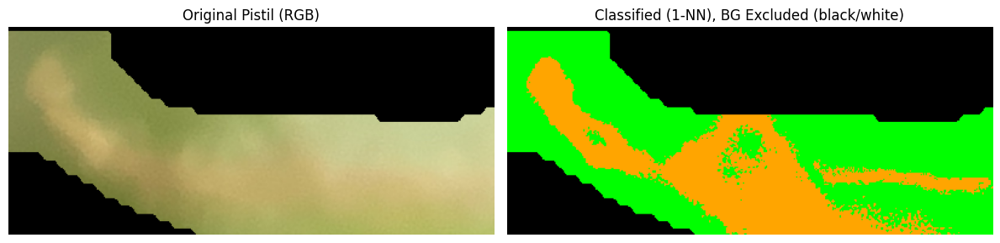

Green Ratio (non-BG):  63.00%
Orange Ratio (non-BG): 37.00%
Total non-BG pixels:   40970
1-NN => Green: 63.00%, Orange: 37.00%

===== Pistil 5 =====


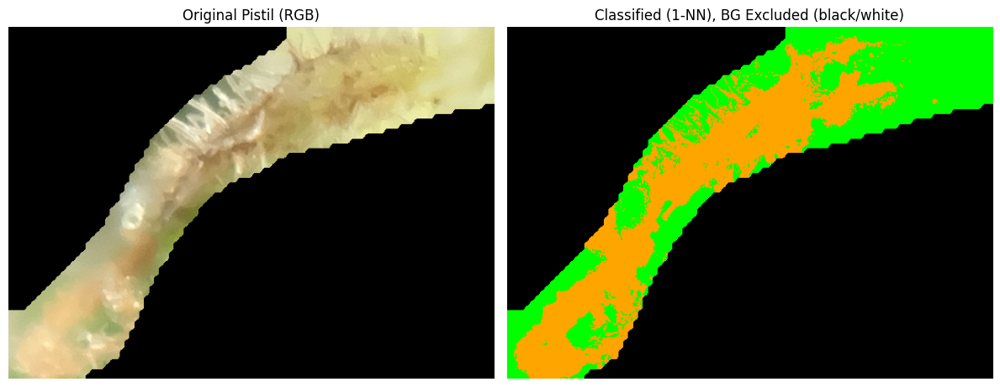

Green Ratio (non-BG):  50.68%
Orange Ratio (non-BG): 49.32%
Total non-BG pixels:   89846
1-NN => Green: 50.68%, Orange: 49.32%

===== Pistil 6 =====


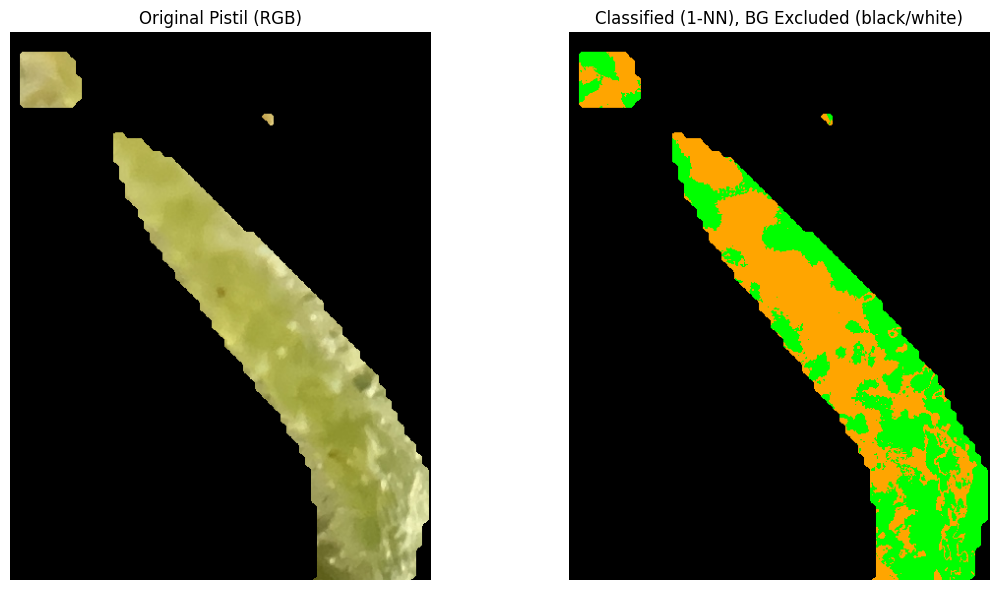

Green Ratio (non-BG):  48.40%
Orange Ratio (non-BG): 51.60%
Total non-BG pixels:   52672
1-NN => Green: 48.40%, Orange: 51.60%


In [44]:
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_9_2024_06_27/greenhouse/243/IMG_8716.JPG"

# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)

Segmenting pistils in: IMG_7939.JPG

0: 480x640 3 stigmas, 8.1ms
Speed: 2.9ms preprocess, 8.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


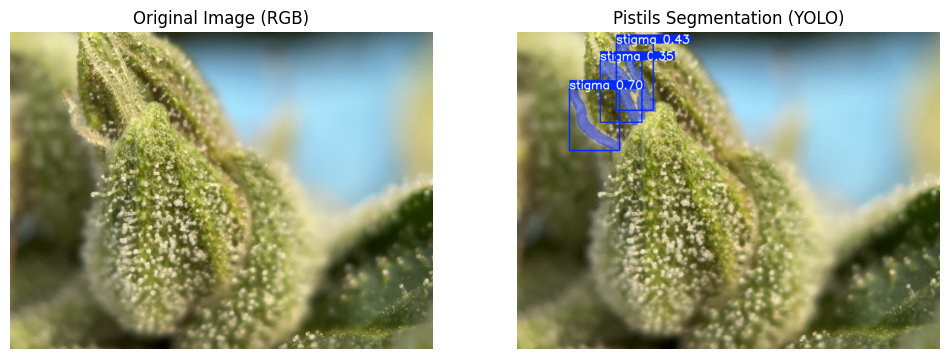

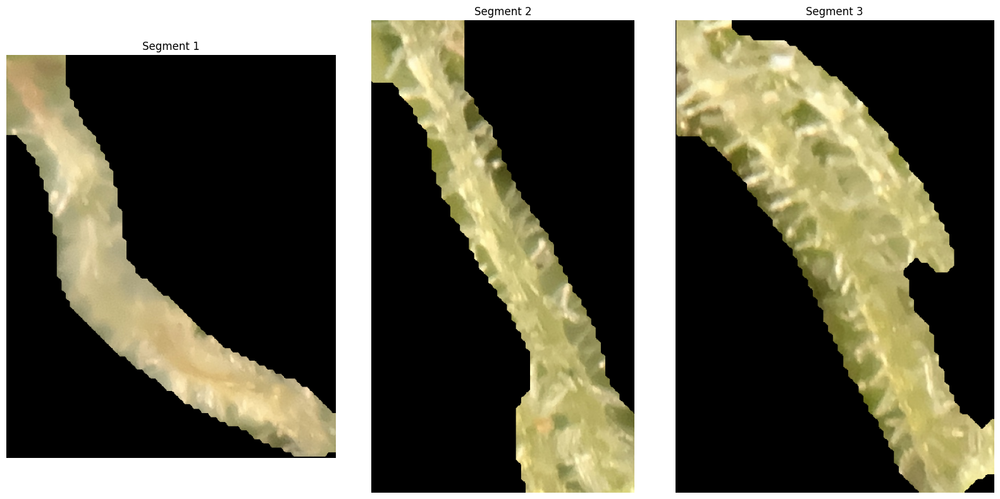


===== Pistil 1 =====


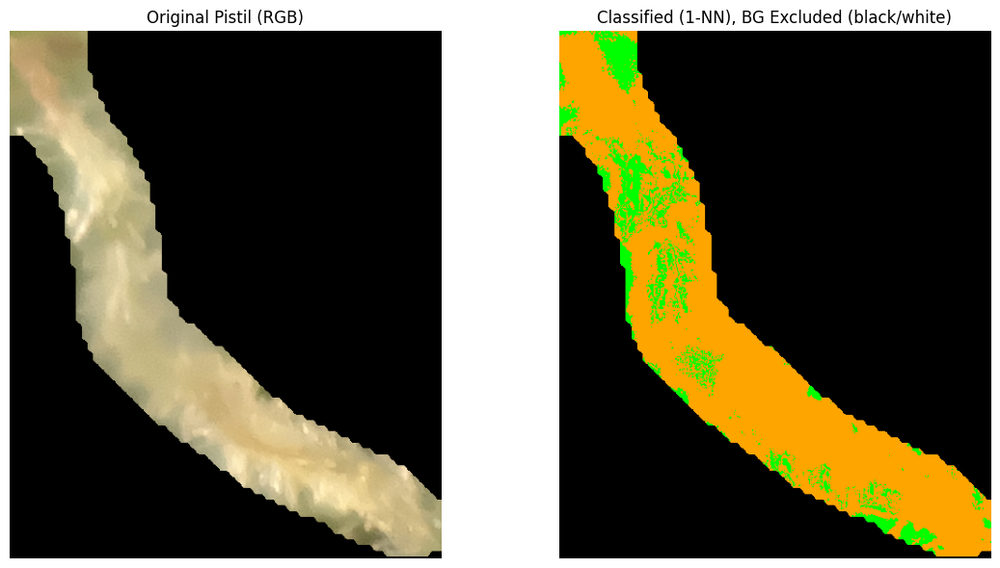

Green Ratio (non-BG):  16.00%
Orange Ratio (non-BG): 84.00%
Total non-BG pixels:   74057
1-NN => Green: 16.00%, Orange: 84.00%

===== Pistil 2 =====


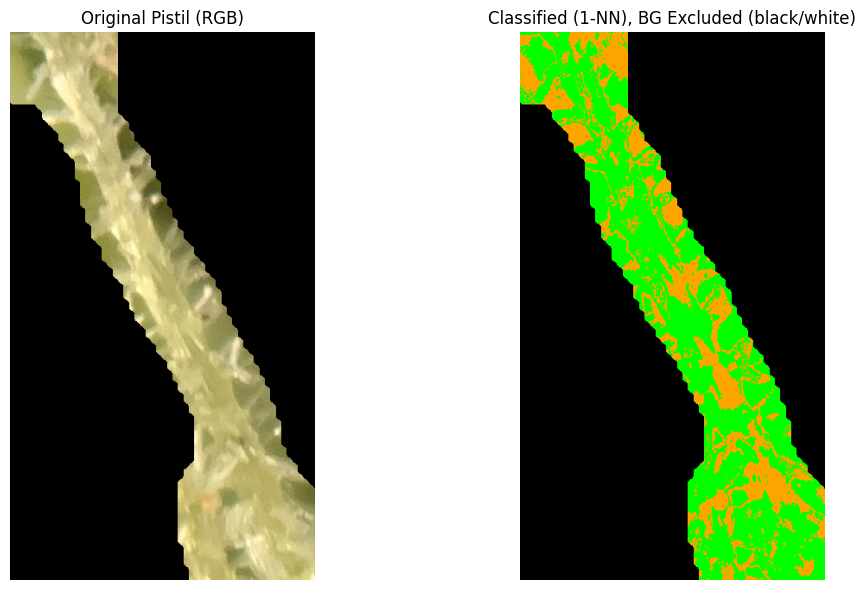

Green Ratio (non-BG):  65.82%
Orange Ratio (non-BG): 34.18%
Total non-BG pixels:   73532
1-NN => Green: 65.82%, Orange: 34.18%

===== Pistil 3 =====


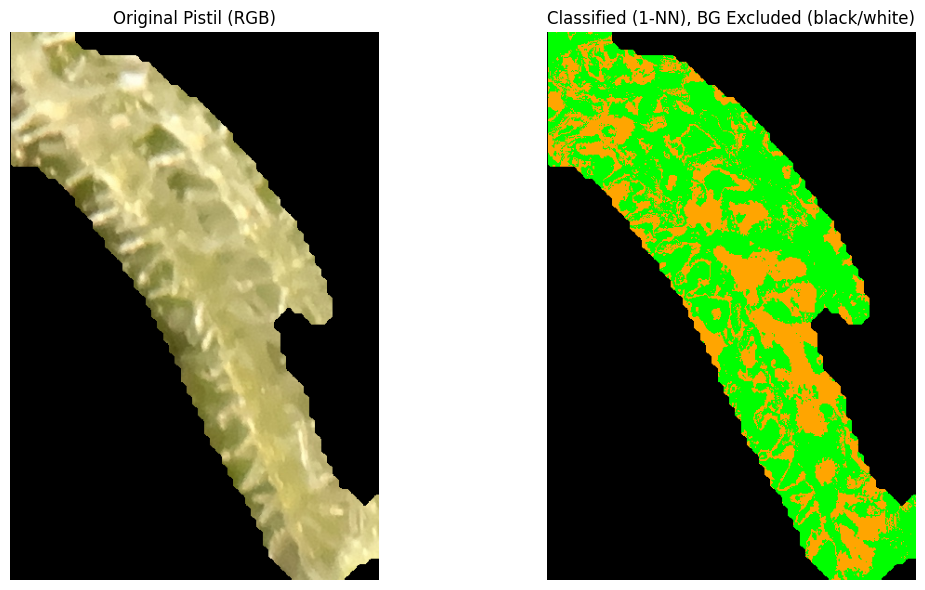

Green Ratio (non-BG):  61.48%
Orange Ratio (non-BG): 38.52%
Total non-BG pixels:   95320
1-NN => Green: 61.48%, Orange: 38.52%


In [45]:
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_7_2024_06_20/greenhouse/205/IMG_7939.JPG"

# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)

Segmenting pistils in: IMG_8036.JPG

0: 480x640 5 stigmas, 8.1ms
Speed: 2.4ms preprocess, 8.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


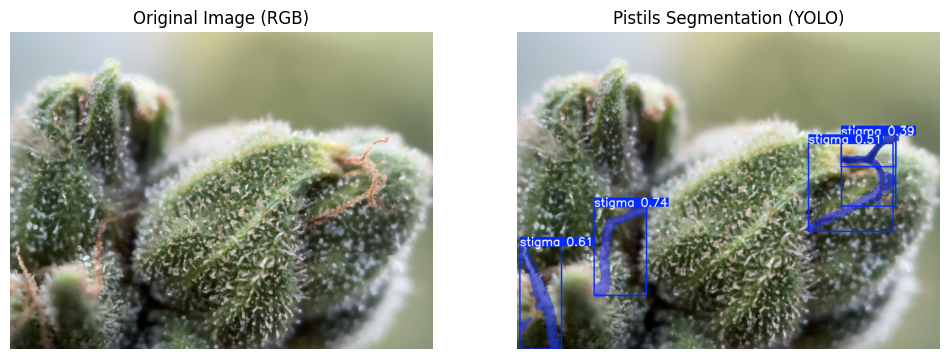

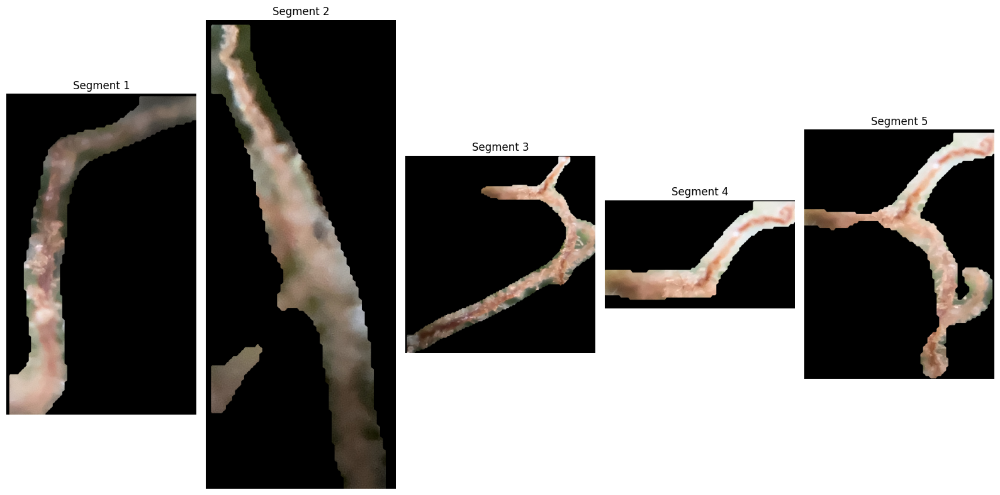


===== Pistil 1 =====


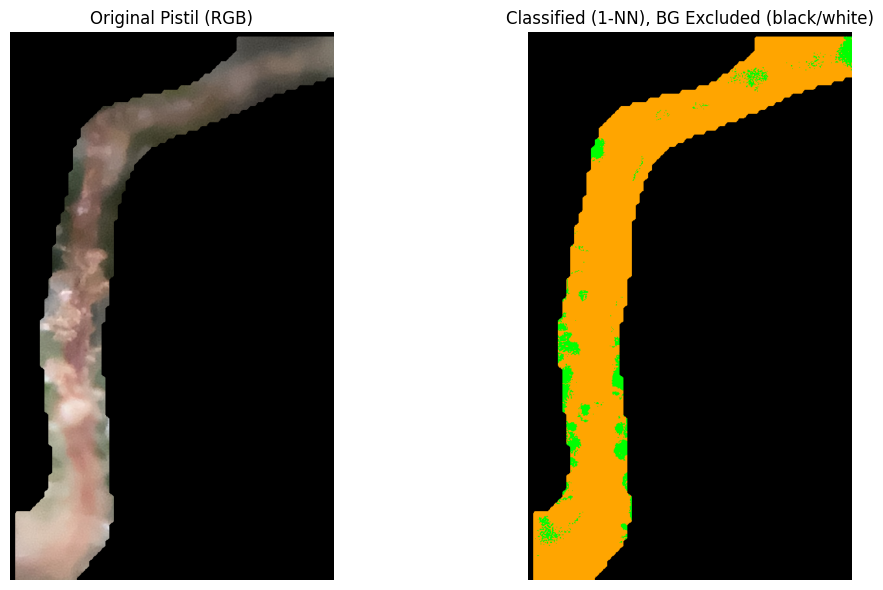

Green Ratio (non-BG):  7.64%
Orange Ratio (non-BG): 92.36%
Total non-BG pixels:   97348
1-NN => Green: 7.64%, Orange: 92.36%

===== Pistil 2 =====


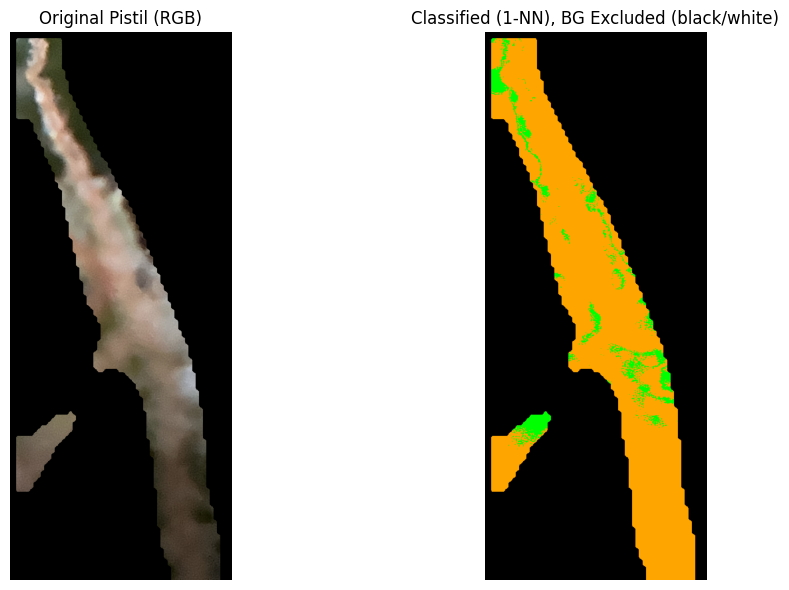

Green Ratio (non-BG):  8.76%
Orange Ratio (non-BG): 91.24%
Total non-BG pixels:   116884
1-NN => Green: 8.76%, Orange: 91.24%

===== Pistil 3 =====


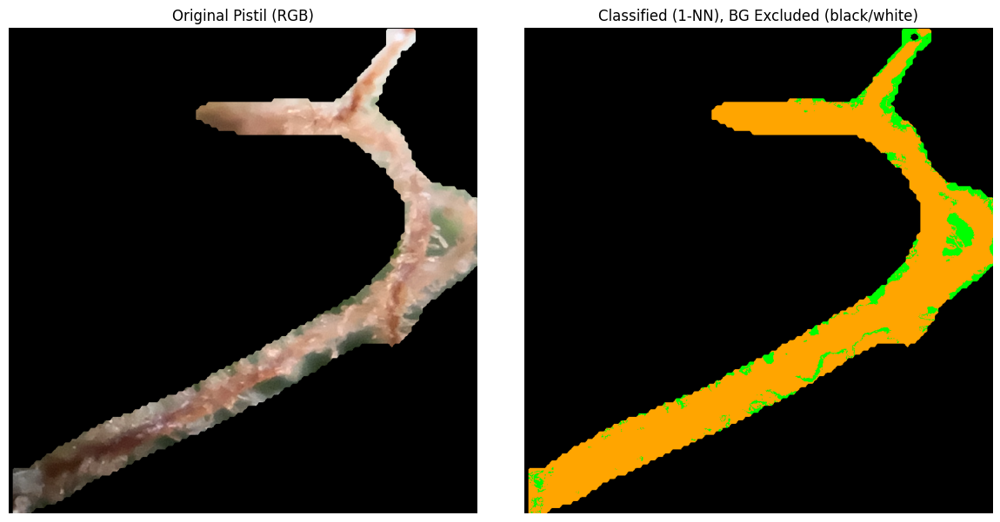

Green Ratio (non-BG):  11.46%
Orange Ratio (non-BG): 88.54%
Total non-BG pixels:   118520
1-NN => Green: 11.46%, Orange: 88.54%

===== Pistil 4 =====


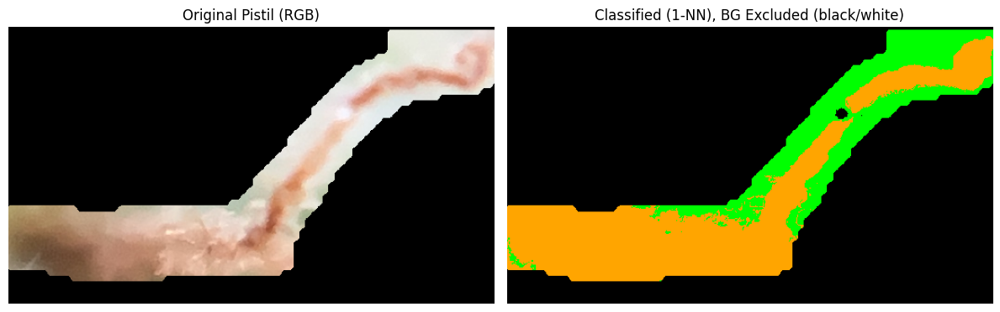

Green Ratio (non-BG):  33.57%
Orange Ratio (non-BG): 66.43%
Total non-BG pixels:   43891
1-NN => Green: 33.57%, Orange: 66.43%

===== Pistil 5 =====


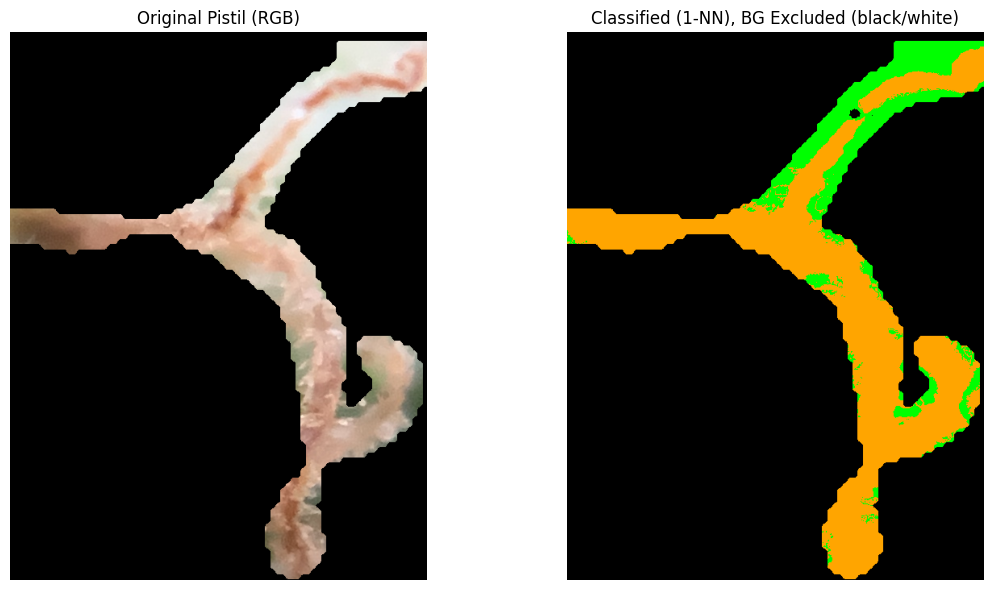

Green Ratio (non-BG):  23.65%
Orange Ratio (non-BG): 76.35%
Total non-BG pixels:   71482
1-NN => Green: 23.65%, Orange: 76.35%


In [46]:
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_7_2024_06_20/greenhouse/204/IMG_8036.JPG"

# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)

Segmenting pistils in: IMG_5579.JPG

0: 480x640 6 stigmas, 8.0ms
Speed: 2.4ms preprocess, 8.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


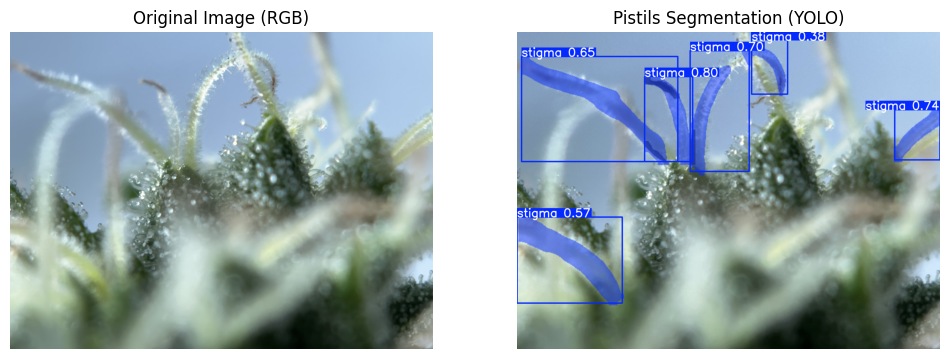

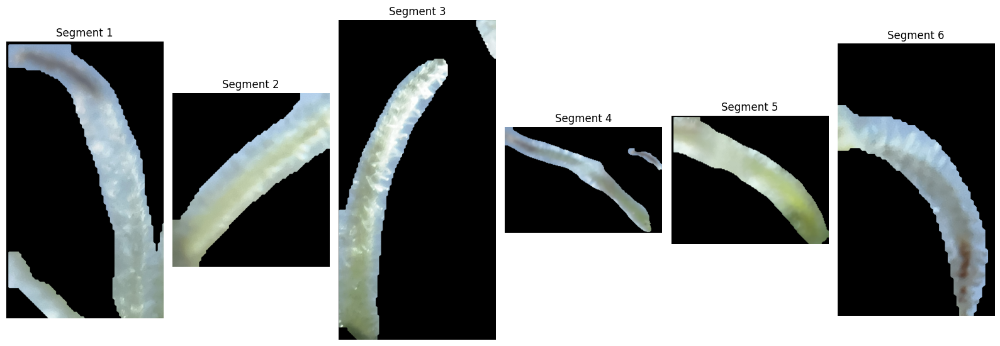


===== Pistil 1 =====


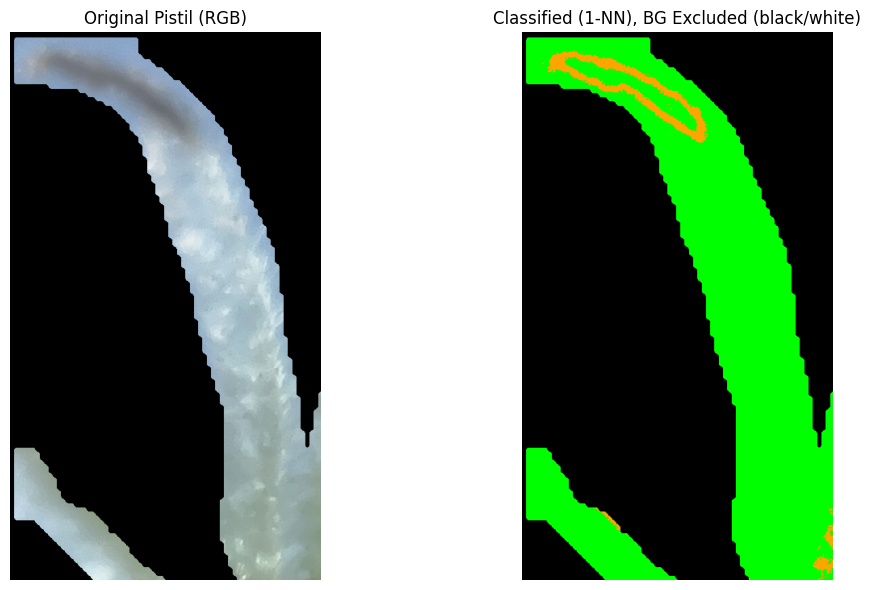

Green Ratio (non-BG):  94.79%
Orange Ratio (non-BG): 5.21%
Total non-BG pixels:   129961
1-NN => Green: 94.79%, Orange: 5.21%

===== Pistil 2 =====


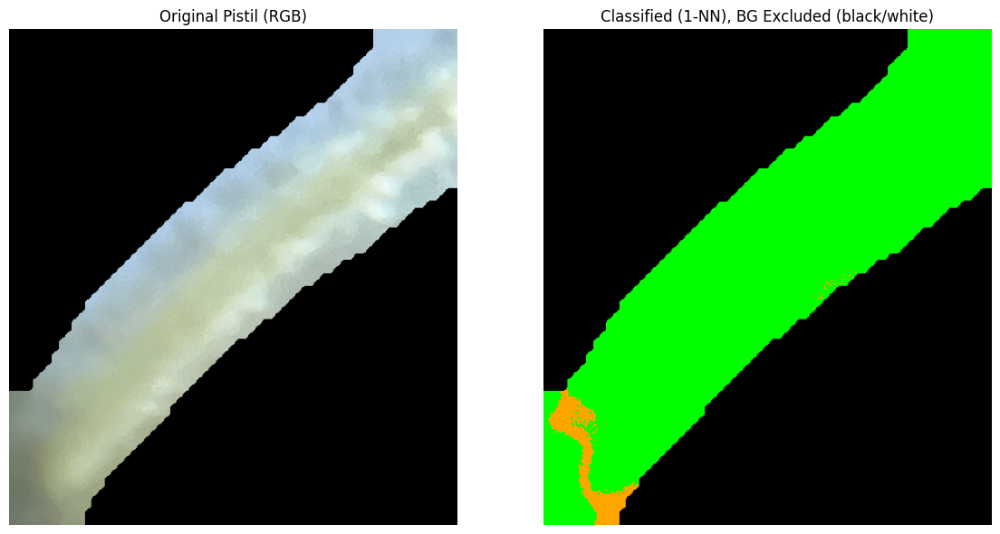

Green Ratio (non-BG):  96.26%
Orange Ratio (non-BG): 3.74%
Total non-BG pixels:   75553
1-NN => Green: 96.26%, Orange: 3.74%

===== Pistil 3 =====


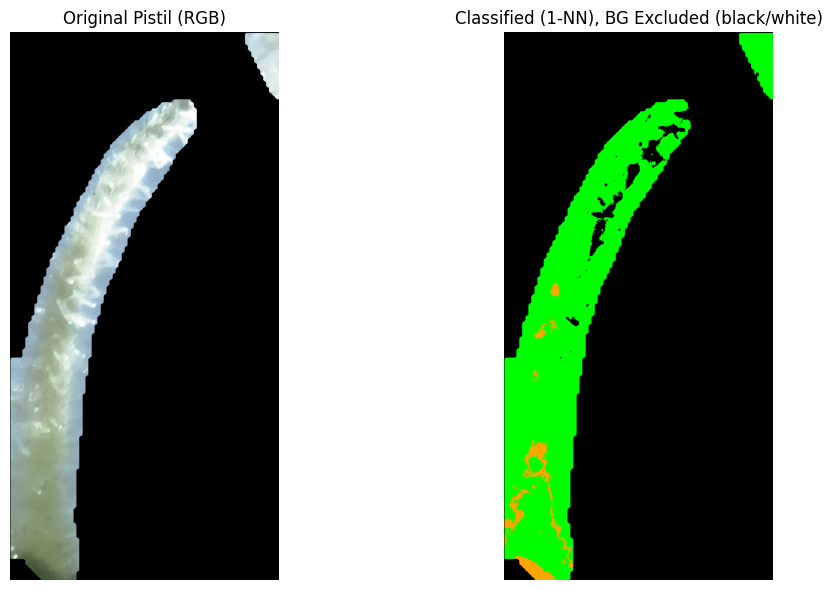

Green Ratio (non-BG):  94.49%
Orange Ratio (non-BG): 5.51%
Total non-BG pixels:   140502
1-NN => Green: 94.49%, Orange: 5.51%

===== Pistil 4 =====


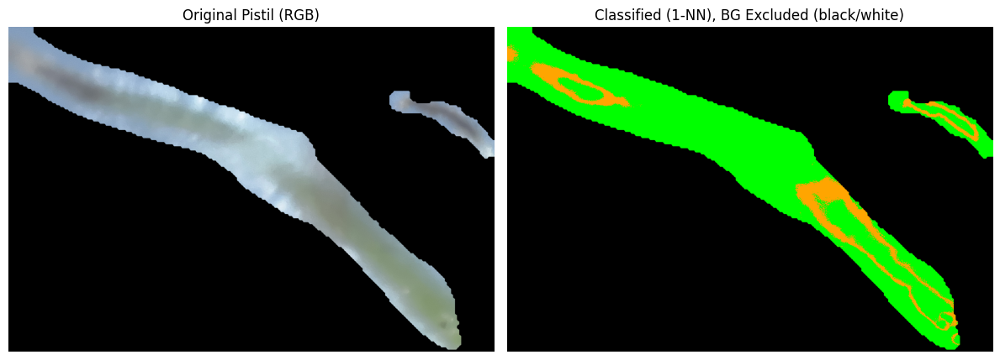

Green Ratio (non-BG):  84.76%
Orange Ratio (non-BG): 15.24%
Total non-BG pixels:   296285
1-NN => Green: 84.76%, Orange: 15.24%

===== Pistil 5 =====


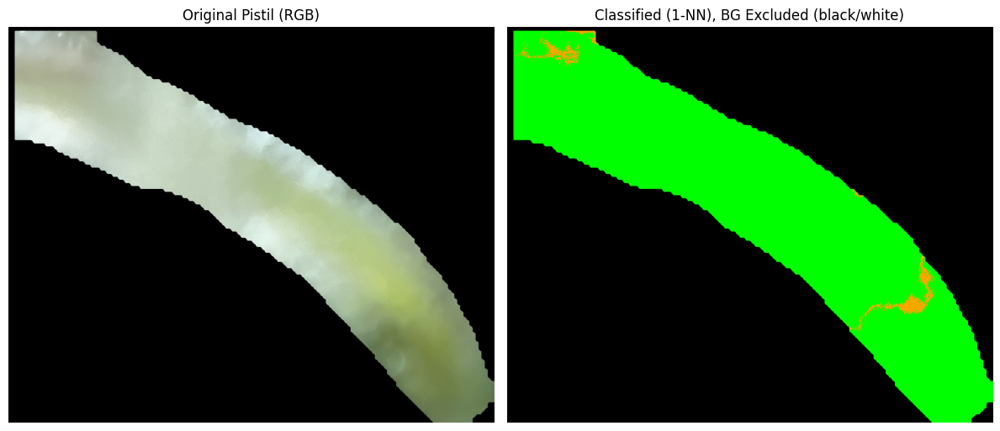

Green Ratio (non-BG):  97.87%
Orange Ratio (non-BG): 2.13%
Total non-BG pixels:   252016
1-NN => Green: 97.87%, Orange: 2.13%

===== Pistil 6 =====


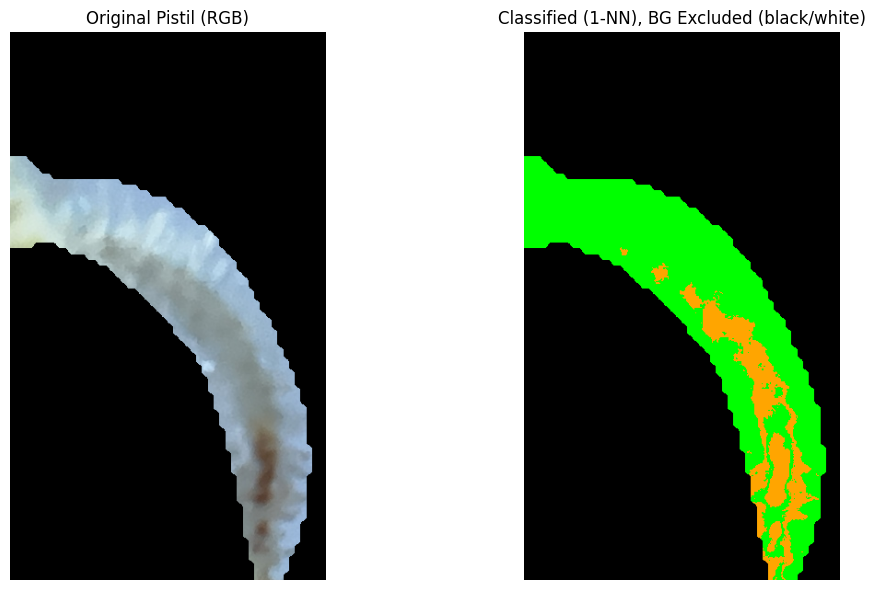

Green Ratio (non-BG):  79.75%
Orange Ratio (non-BG): 20.25%
Total non-BG pixels:   48149
1-NN => Green: 79.75%, Orange: 20.25%


In [47]:
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_3_2024_06_06/greenhouse/65/IMG_5579.JPG"

# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)

Segmenting pistils in: IMG_6679.JPG

0: 480x640 9 stigmas, 9.7ms
Speed: 3.2ms preprocess, 9.7ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)


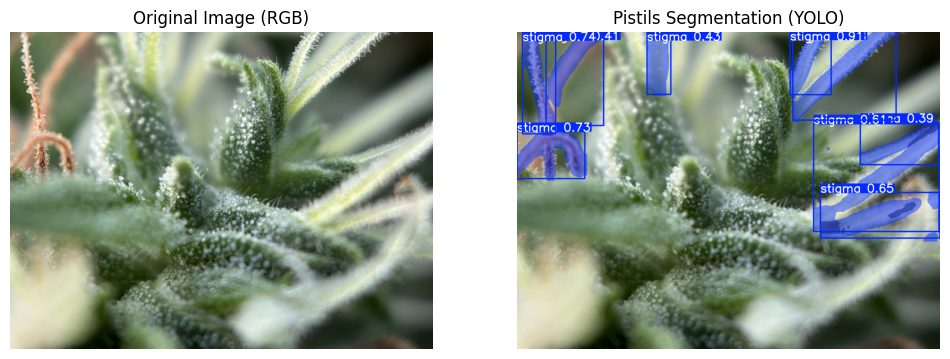

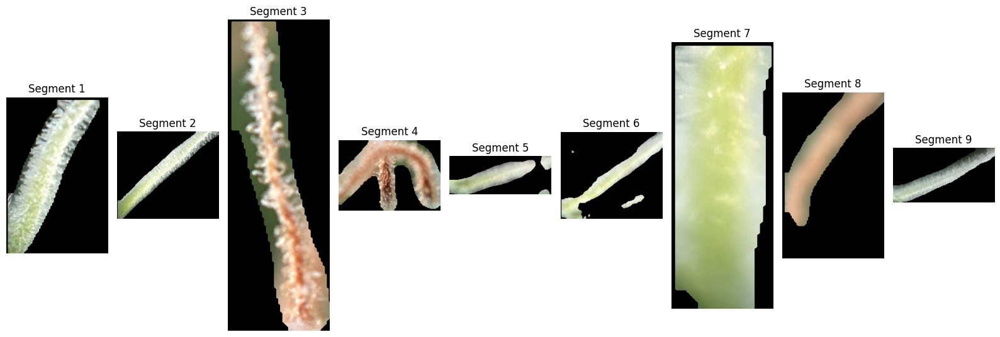


===== Pistil 1 =====


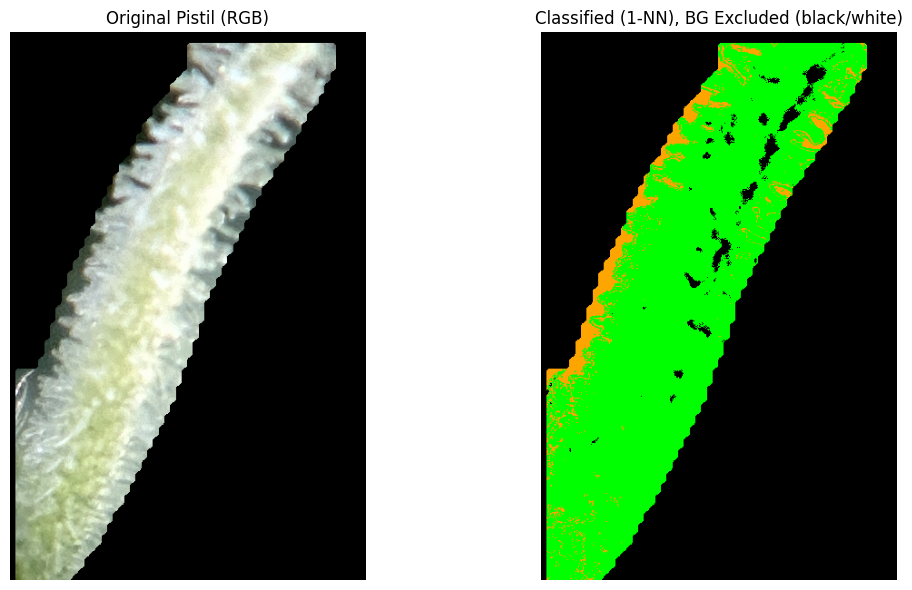

Green Ratio (non-BG):  90.68%
Orange Ratio (non-BG): 9.32%
Total non-BG pixels:   88137
1-NN => Green: 90.68%, Orange: 9.32%

===== Pistil 2 =====


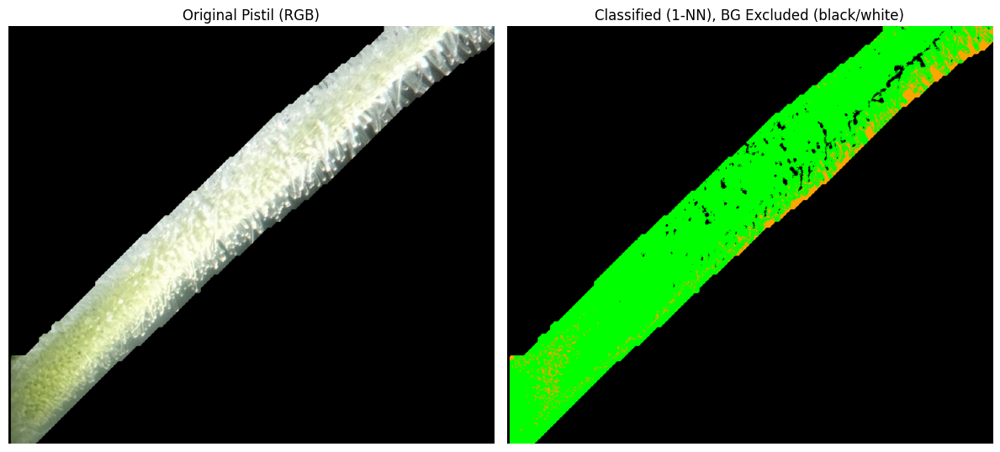

Green Ratio (non-BG):  91.68%
Orange Ratio (non-BG): 8.32%
Total non-BG pixels:   178336
1-NN => Green: 91.68%, Orange: 8.32%

===== Pistil 3 =====


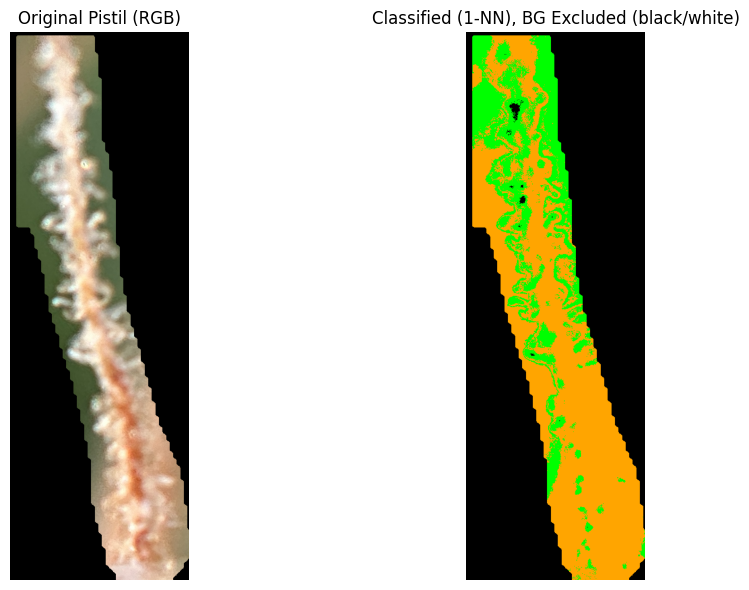

Green Ratio (non-BG):  30.24%
Orange Ratio (non-BG): 69.76%
Total non-BG pixels:   142573
1-NN => Green: 30.24%, Orange: 69.76%

===== Pistil 4 =====


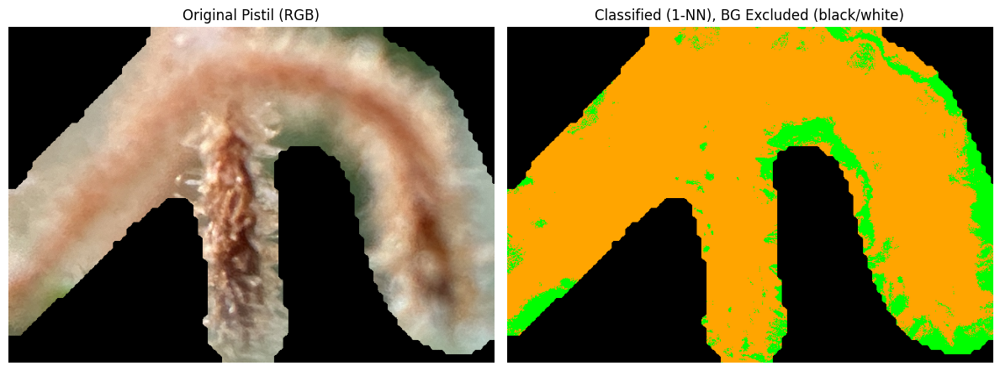

Green Ratio (non-BG):  12.90%
Orange Ratio (non-BG): 87.10%
Total non-BG pixels:   181080
1-NN => Green: 12.90%, Orange: 87.10%

===== Pistil 5 =====


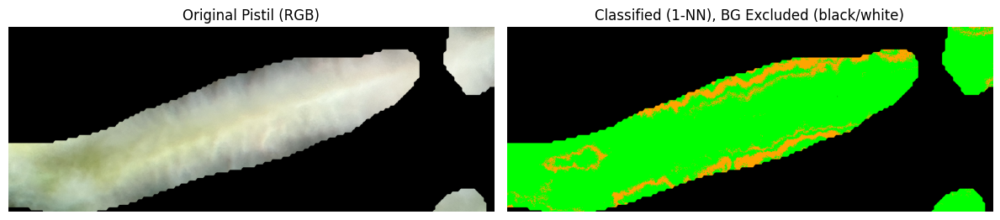

Green Ratio (non-BG):  86.21%
Orange Ratio (non-BG): 13.79%
Total non-BG pixels:   200475
1-NN => Green: 86.21%, Orange: 13.79%

===== Pistil 6 =====


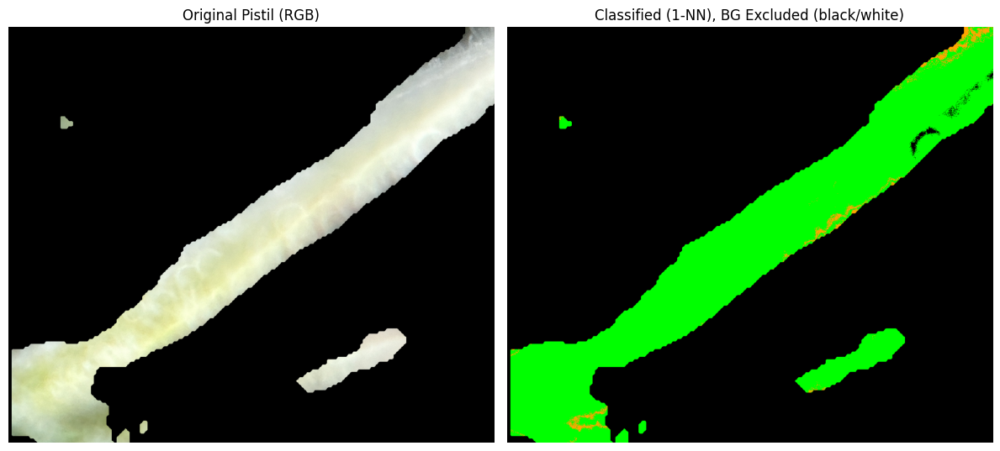

Green Ratio (non-BG):  97.15%
Orange Ratio (non-BG): 2.85%
Total non-BG pixels:   260983
1-NN => Green: 97.15%, Orange: 2.85%

===== Pistil 7 =====


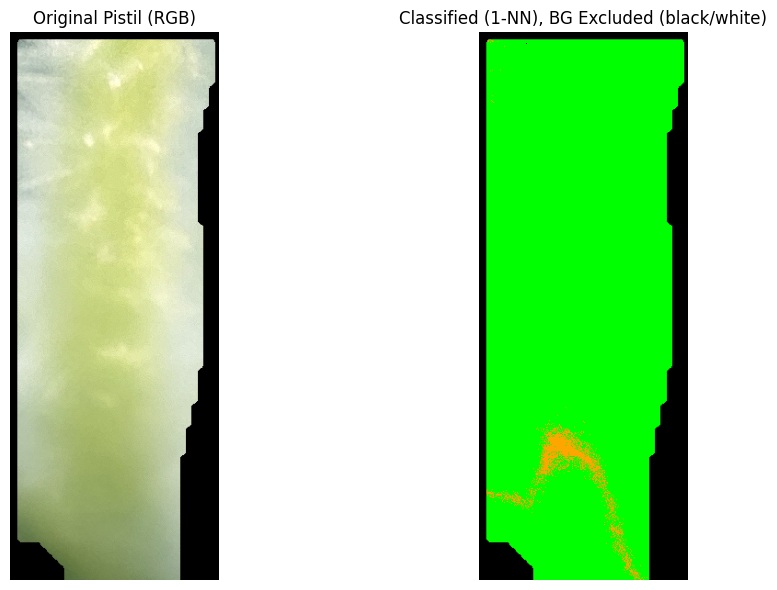

Green Ratio (non-BG):  97.58%
Orange Ratio (non-BG): 2.42%
Total non-BG pixels:   112914
1-NN => Green: 97.58%, Orange: 2.42%

===== Pistil 8 =====


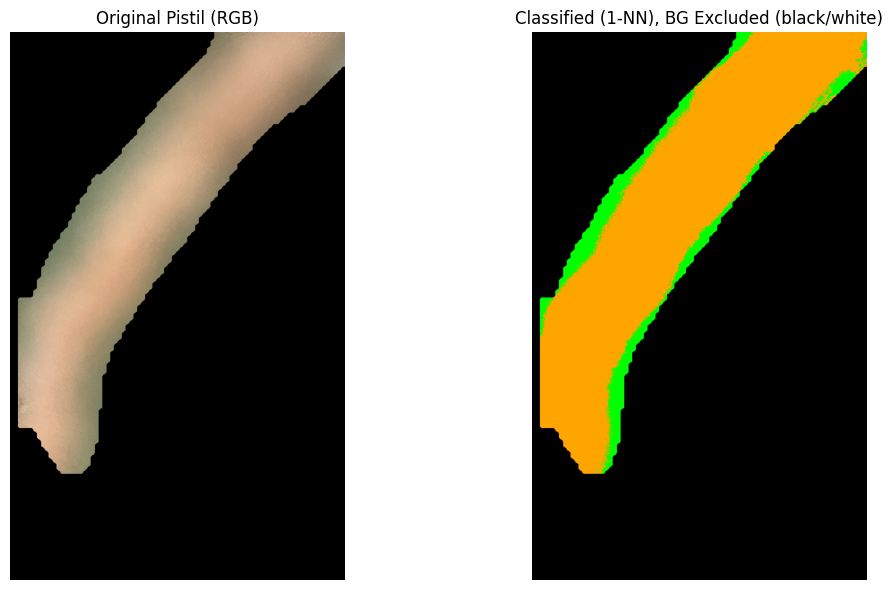

Green Ratio (non-BG):  13.49%
Orange Ratio (non-BG): 86.51%
Total non-BG pixels:   134091
1-NN => Green: 13.49%, Orange: 86.51%

===== Pistil 9 =====


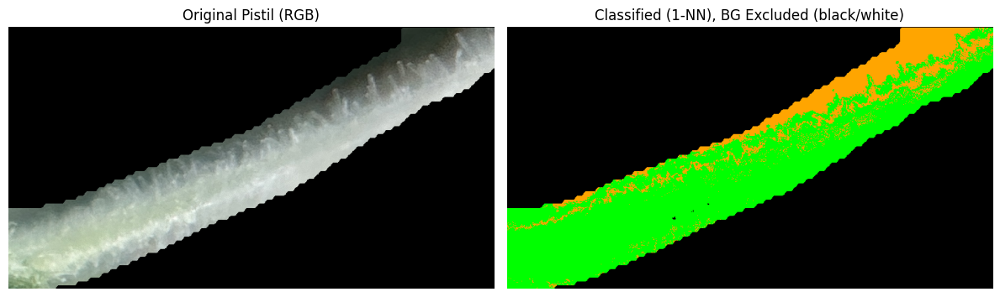

Green Ratio (non-BG):  76.76%
Orange Ratio (non-BG): 23.24%
Total non-BG pixels:   92072
1-NN => Green: 76.76%, Orange: 23.24%


In [48]:
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_5_2024_06_13/greenhouse/134/IMG_6679.JPG"

# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)

Segmenting pistils in: IMG_6656.JPG

0: 480x640 9 stigmas, 8.1ms
Speed: 2.3ms preprocess, 8.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


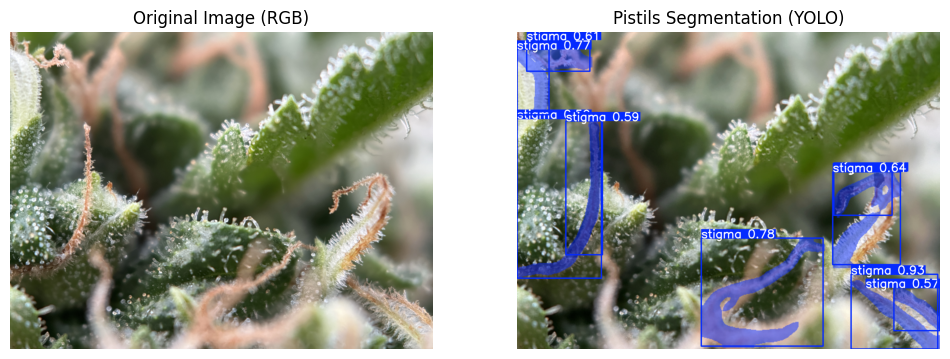

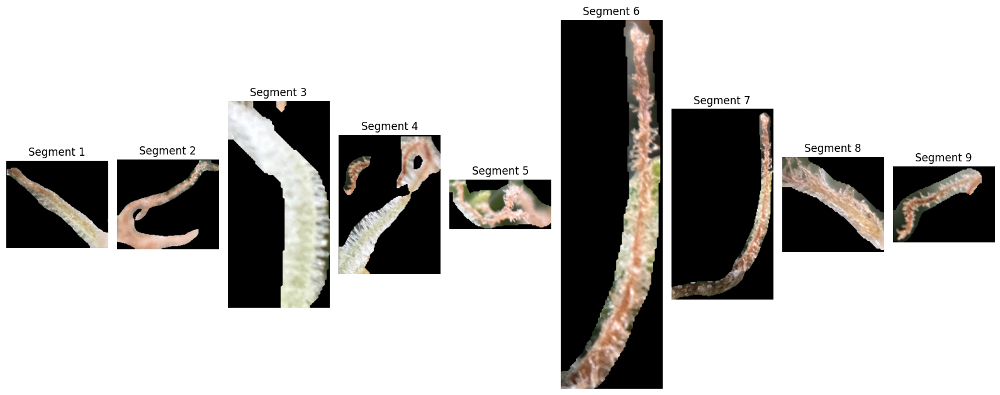


===== Pistil 1 =====


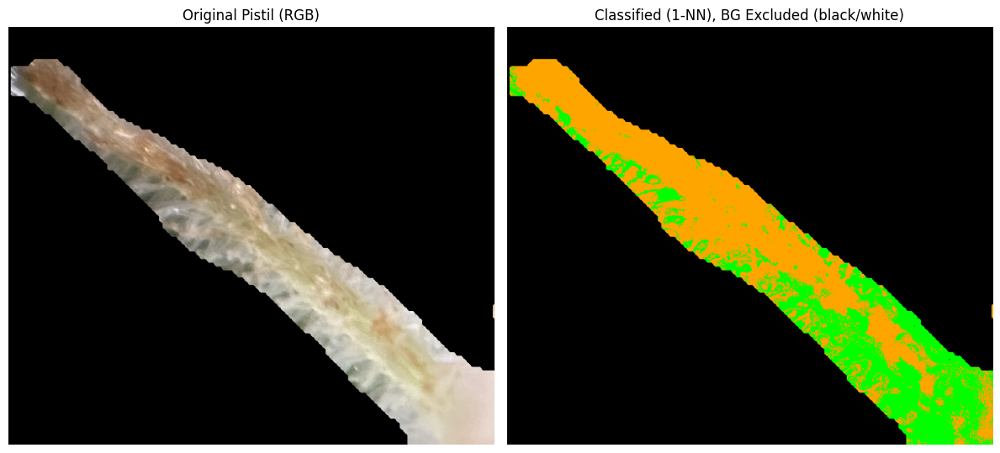

Green Ratio (non-BG):  37.36%
Orange Ratio (non-BG): 62.64%
Total non-BG pixels:   124159
1-NN => Green: 37.36%, Orange: 62.64%

===== Pistil 2 =====


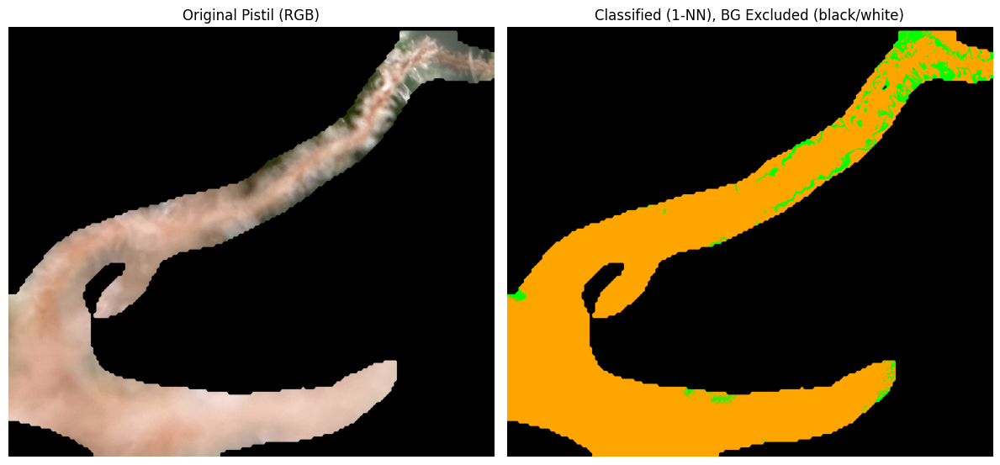

Green Ratio (non-BG):  5.42%
Orange Ratio (non-BG): 94.58%
Total non-BG pixels:   325008
1-NN => Green: 5.42%, Orange: 94.58%

===== Pistil 3 =====


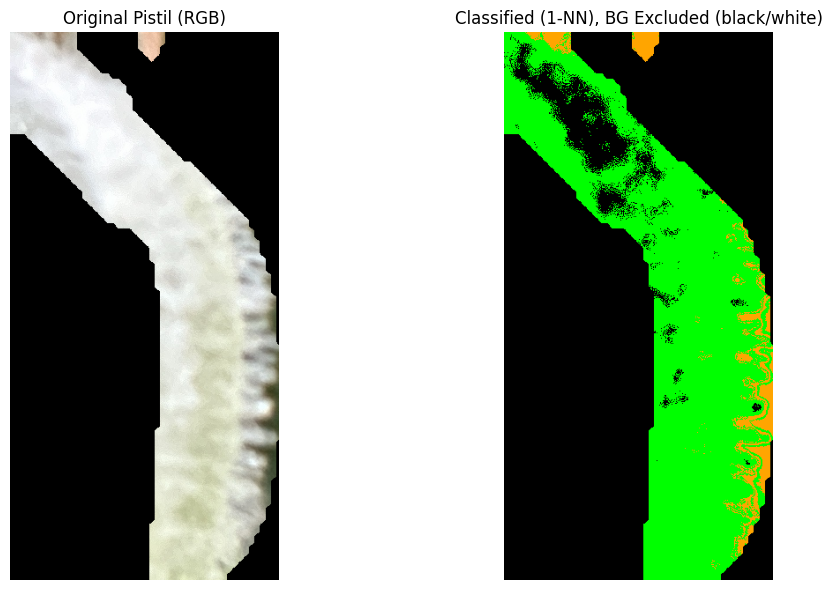

Green Ratio (non-BG):  91.49%
Orange Ratio (non-BG): 8.51%
Total non-BG pixels:   73274
1-NN => Green: 91.49%, Orange: 8.51%

===== Pistil 4 =====


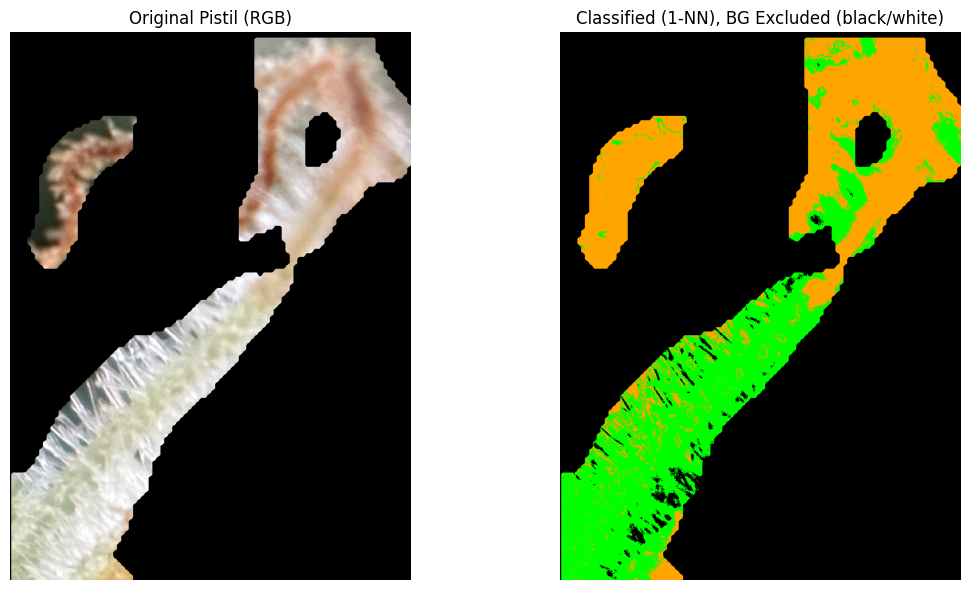

Green Ratio (non-BG):  51.17%
Orange Ratio (non-BG): 48.83%
Total non-BG pixels:   172954
1-NN => Green: 51.17%, Orange: 48.83%

===== Pistil 5 =====


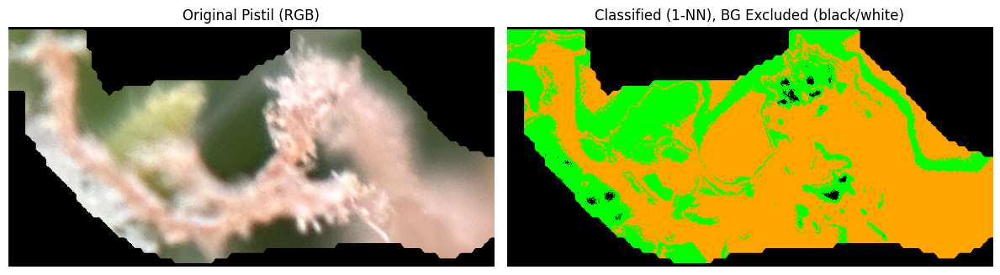

Green Ratio (non-BG):  33.65%
Orange Ratio (non-BG): 66.35%
Total non-BG pixels:   119895
1-NN => Green: 33.65%, Orange: 66.35%

===== Pistil 6 =====


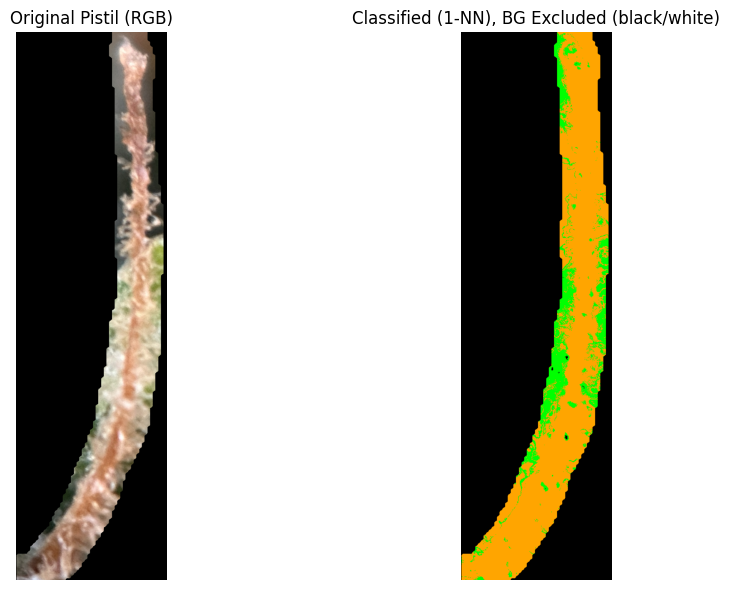

Green Ratio (non-BG):  17.43%
Orange Ratio (non-BG): 82.57%
Total non-BG pixels:   145445
1-NN => Green: 17.43%, Orange: 82.57%

===== Pistil 7 =====


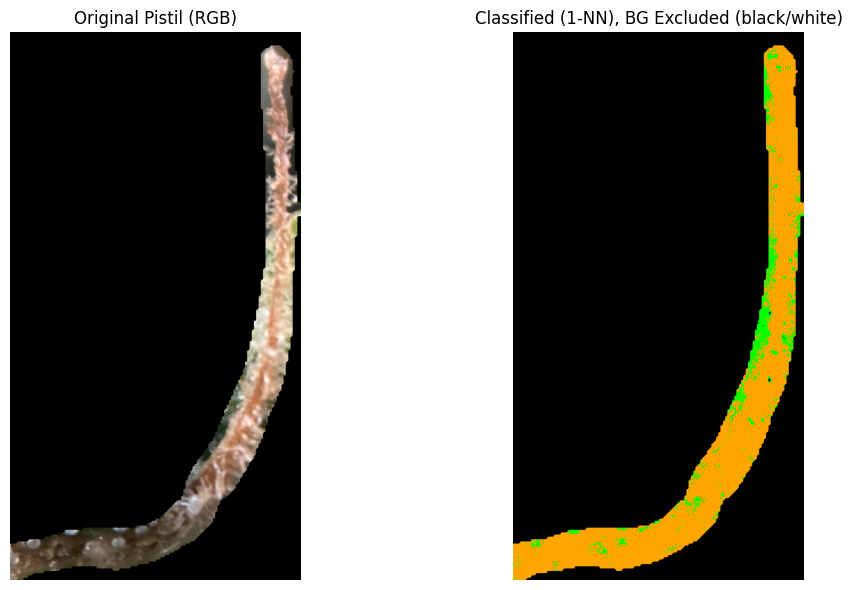

Green Ratio (non-BG):  11.22%
Orange Ratio (non-BG): 88.78%
Total non-BG pixels:   189989
1-NN => Green: 11.22%, Orange: 88.78%

===== Pistil 8 =====


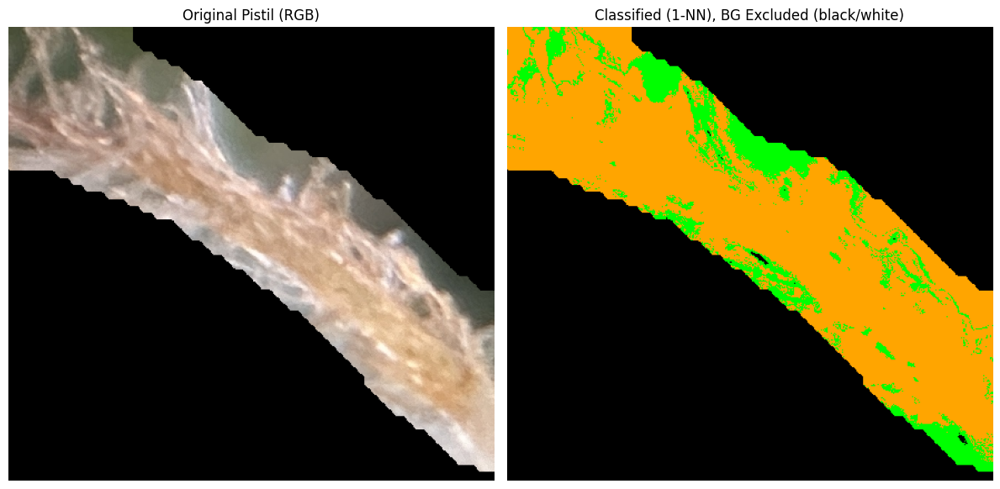

Green Ratio (non-BG):  17.71%
Orange Ratio (non-BG): 82.29%
Total non-BG pixels:   66472
1-NN => Green: 17.71%, Orange: 82.29%

===== Pistil 9 =====


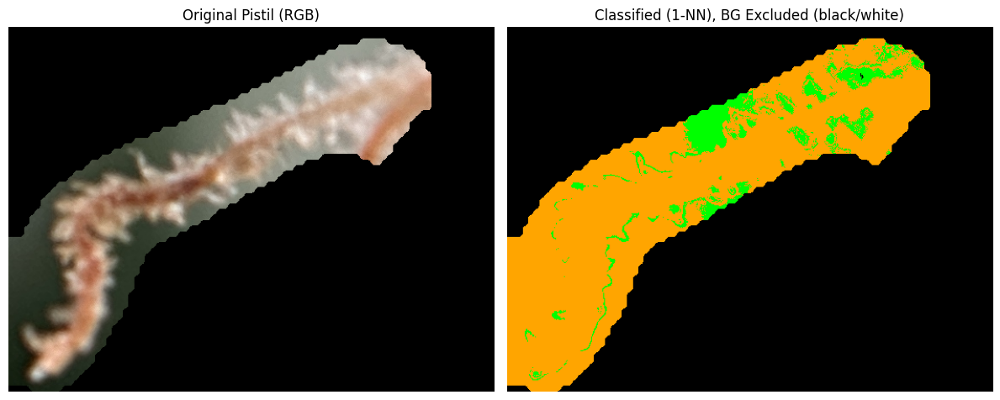

Green Ratio (non-BG):  11.89%
Orange Ratio (non-BG): 88.11%
Total non-BG pixels:   70694
1-NN => Green: 11.89%, Orange: 88.11%


In [49]:
image_path = "/sise/shanigu-group/etaylor/assessing_cannabis_exp/experiment_1/images/day_5_2024_06_13/greenhouse/138/IMG_6656.JPG"

# Run the pipeline
main_pipeline(
    image_path=image_path,
    pistils_model_checkpoint=pistils_model_checkpoint,
    green_data=green_data,
    orange_data=orange_data,
)